<a href="https://colab.research.google.com/github/DmitryMok/MyProjects/blob/main/Public_Aero.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Привязка аэроснимков к местности

1. https://colab.research.google.com/drive/1WGPiieZ9IJpx0Bfdg_IeVG1MzjRrLnUA#scrollTo=KKgFPE9tnWsV
2. https://colab.research.google.com/drive/1koVrPElc8n9nD8G7NS8YhXluDYrY2rvJ#scrollTo=Arn2GKplELkY

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## +Подключаем библиотеки

In [2]:
import cv2

import numpy as np                               # Библиотека работы с массивами
import matplotlib.pyplot as plt                  # Для отрисовки графиков
from matplotlib.path import Path

from IPython.display import Image
from google.colab.patches import cv2_imshow      # Для вывода изображений через cv2

import random                                    # Для генерации случайных чисел 
import os                                        # Для работы с файлами 
# import subprocess
# import sys

import timeit
import time 

# from shapely.geometry import Polygon            # Для функции площади многоугольника
%matplotlib inline

from math import sin, cos, pi, atan2, exp

In [3]:
dir_home = '/content/drive/MyDrive/Aerophoto/' # папка для сохранения промежуточных результатов

In [4]:
# выводим звук в колабе
from google.colab import output as output_sound
 
def sound(): # Play an audio beep.
  output_sound.eval_js('new Audio("https://upload.wikimedia.org/wikipedia/commons/f/f9/Beep_example.ogg").play()')
 
sound()

In [5]:
# загружаю свои модули со вспомогательными функциями
!git clone https://github.com/DmitryMok/wine_helper

%cd wine_helper
from prepare_data_helper import *
%cd ..

fatal: destination path 'wine_helper' already exists and is not an empty directory.
/content/wine_helper
/content


In [6]:
# BASE_IMG_SIZE = 1024
BASE_IMG_SIZE = 2294   #1024/100*224

In [7]:
import tensorflow as tf

def seed_everything(s=42):
  # 1. The below is necessary for starting Numpy generated random numbers
  # in a well-defined initial state.
  np.random.seed(s)

  # 2. The below is necessary for starting core Python generated random numbers
  # in a well-defined state.
  random.seed(s)

  # 3. The below set_seed() will make random number generation
  # in the TensorFlow backend have a well-defined initial state.
  # For further details, see:
  # https://www.tensorflow.org/api_docs/python/tf/random/set_seed
  tf.random.set_seed(s)  

  # 4. Set the `PYTHONHASHSEED` environment variable at a fixed value
  os.environ['PYTHONHASHSEED']=str(s)

# Подготовка базы

## +Скачиваем обучающий датасет

In [8]:
# скачиваем базу изображений (~2 мин)
import requests
from urllib.parse import urlencode
base_url = 'https://cloud-api.yandex.net/v1/disk/public/resources/download?'
public_key = 'https://disk.yandex.ru/d/QDao6ytP34T7bQ'  # Сюда вписываете вашу ссылку
# Получаем загрузочную ссылку
final_url = base_url + urlencode(dict(public_key=public_key))
response = requests.get(final_url)
download_url = response.json()['href']
# Загружаем файл и сохраняем его
download_response = requests.get(download_url)

In [9]:
with open('train_dataset_train.zip', 'wb') as f:   # Здесь укажите нужный путь к файлу
    f.write(download_response.content)

In [10]:
del download_response # удаляем, чтобы хватило оперативной памяти

In [11]:
# !wget https://lodmedia.hb.bizmrg.com/case_files/768820/train_dataset_train.zip?raw=true -O train_dataset_train.zip

In [12]:
!unzip -q train_dataset_train.zip -d /content/train_data

replace /content/train_data/train/img/1.png? [y]es, [n]o, [A]ll, [N]one, [r]ename: N


In [13]:
sound()

## Скачиваем тестовый датасет

In [ ]:
# скачиваем базу изображений (~2 мин)
import requests
from urllib.parse import urlencode
base_url = 'https://cloud-api.yandex.net/v1/disk/public/resources/download?'
public_key = 'https://disk.yandex.ru/d/-s0Buj5dutaxbQ'  # Сюда вписываете вашу ссылку
# Получаем загрузочную ссылку
final_url = base_url + urlencode(dict(public_key=public_key))
response = requests.get(final_url)
download_url = response.json()['href']
# Загружаем файл и сохраняем его
download_response = requests.get(download_url)

In [ ]:
with open('test_dataset_test.zip', 'wb') as f:   # Здесь укажите нужный путь к файлу
    f.write(download_response.content)

In [ ]:
# !wget https://lodmedia.hb.bizmrg.com/case_files/768820/test_dataset_test.zip?raw=true -O test_dataset_test.zip

In [ ]:
del download_response # удаляем, чтобы хватило оперативной памяти

In [ ]:
!unzip -q test_dataset_test.zip -d /content/test_data

In [ ]:
sound()

# Проверяем содержимое базы

## +Загружаем основное изображение

In [74]:
original_image = cv2.imread('/content/train_data/original.tiff')

In [75]:
org_shape = original_image.shape
org_shape

(10496, 10496, 3)

In [76]:
10486/7

1498.0

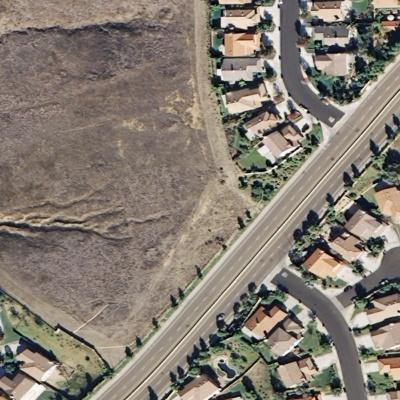

In [77]:
cv2_imshow(original_image[:400,:400,:])

In [78]:
resized_img = resize_image(original_image, width=BASE_IMG_SIZE)
# cv2_imshow(resized_img)
BASE_IMG_SIZE

2294

In [79]:
resized_img.shape

(2294, 2294, 3)

In [80]:
# isWritten = cv2.imwrite(dir_home+'img_resized_2294.png', resized_img) # сохраняем, чтобы каждый раз не ресайзить

## +Отображаем содержимое json

In [96]:
import json

In [97]:
dir_img = '/content/train_data/train/img/'
dir_json = '/content/train_data/train/json/'

# количество файлов
len(os.listdir(dir_img)), len(os.listdir(dir_json))

(800, 800)

In [98]:
# получаем json файл в виде словаря
def get_json(file_json='/content/annotations.json'):
  with open(file_json) as fp:
      data = json.load(fp)
  return data

In [99]:
# преобразует абсолютные координаты оригинального изображения в относительные координаты
def new_xy(xy):
  new_x = xy[0]/org_shape[1]
  new_y = xy[1]/org_shape[0]
  # new_x = int(xy[0]/org_shape[1]*resized_img.shape[1])
  # new_y = int(xy[1]/org_shape[0]*resized_img.shape[0])
  return [new_x, new_y]

# эти функции повторяются ниже !!!!!!!!!!!!!!!!!!!!!!!!!!!!!
# преобразуем угол в x и y координаты
def ang2xy(ang):
  return cos(pi/180*ang)*0.5+0.5, sin(pi/180*ang)*0.5+0.5  #нормируем угол [0:1], чтобы использовать одну функцию активации с координатами центра

# конвертация катетов в гипотенузу
def ab2c(a,b):
  print(a,b)
  return (((a-0.5)*2)**2+((b-0.5)*2)**2)**0.5

In [100]:
# содержимое json и тренировочные изображения в массив
# train_img_lst = os.listdir(dir_img) # список файлов изображений сделаем из изменив разрешение файлов json
train_json_lst = os.listdir(dir_json)
train_img, train_xya = [], [] # здесь будут готовые X и Y (! X без нормализации, Y с нормализацией)
train_ang = []  # здесь будут непреобразованные углы из json
tmp_img = resized_img.copy()

for f_json in train_json_lst[:]:
  json_data = get_json(file_json=dir_json+f_json)
  coord_lst = []
  # print(f_json, json_data)
  for instance in json_data:
    # print(instance, json_data[instance])
    coord_lst.append(json_data[instance]) # массив, чтобы удобно конвертировать в др размеры
  coord_lst = np.array(coord_lst[:-1])
  # получаем координаты для отображения полигона на resized_img
  points = np.array(list(map(new_xy,coord_lst)))
  # print(coord_lst, points)
  points[[2,3]] = points[[3,2]]
  tmp_img = cv2.polylines(tmp_img, np.int32([points*resized_img.shape[0]]), 1, (255,255,255),3)

  # координаты центра
  xy_center = (np.max(points, axis=0) + np.min(points, axis=0))/2
  # формируем массив из x/y центра и x/y угла нормированного [-1:1]
  train_xya.append(np.concatenate([xy_center, ang2xy(json_data[instance])]))
  # загружаем соответствующий фрагмент для добавления в тренировочную базу в размере 224
  train_frag = resize_image(cv2.imread(dir_img+change_file_ext(f_json,'png')),width=224)
  train_img.append(train_frag)
  train_ang.append(json_data[instance])
  
train_xya = np.array(train_xya)
train_img = np.array(train_img)

sound()

In [101]:
train_img.shape, train_xya.shape

((800, 224, 224, 3), (800, 4))

In [102]:
# список файлов с изображениями для обращения по индексу
train_img_lst = list(map(lambda x:change_file_ext(x,'png'),train_json_lst))

In [103]:
train_img_lst[:5], train_json_lst[:5]

(['690.png', '507.png', '584.png', '538.png', '61.png'],
 ['690.json', '507.json', '584.json', '538.json', '61.json'])

In [104]:
points

array([[0.84670351, 0.7820122 ],
       [0.76400534, 0.83374619],
       [0.71227134, 0.75104802],
       [0.79496951, 0.69931402]])

In [105]:
resized_img.shape

(2294, 2294, 3)

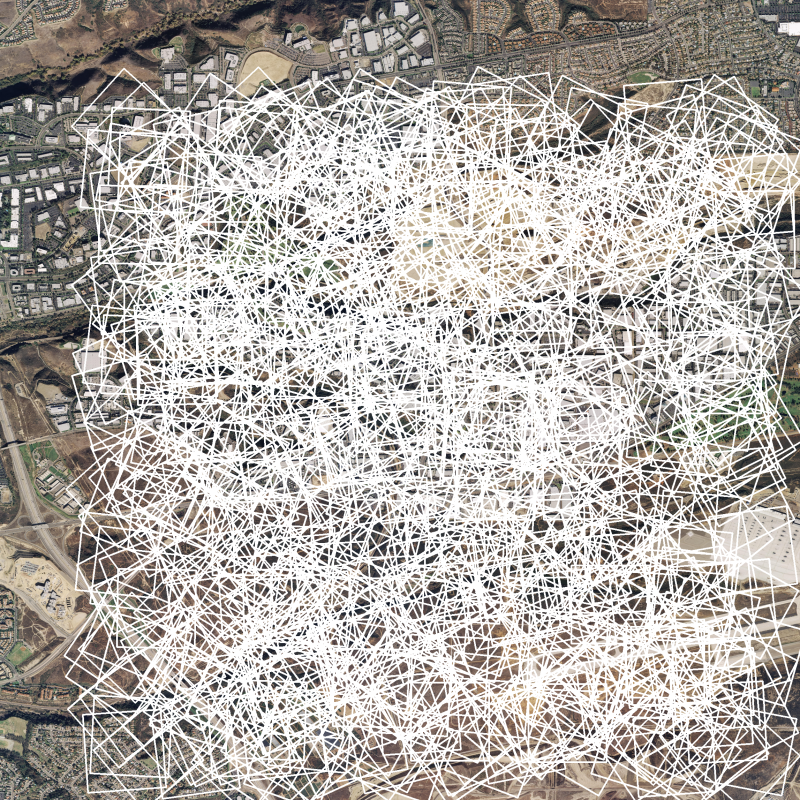

In [106]:
cv2_imshow(resize_image(tmp_img, width=800))

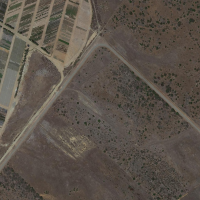

In [107]:
cv2_imshow(resize_image(cv2.imread('/content/train_data/train/img/799.png'),width=200))

## Проверяем соответствие фрагмента координатам

! перед продолжением надо запустить раздел "Готовим базу" и "Готовим свой датасет". Нужны функции subimage и пр.

Фрагменты id = 0


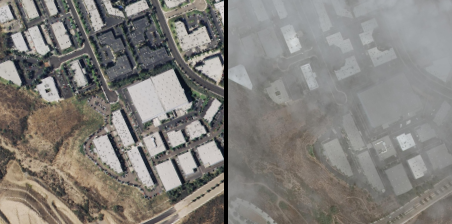

Фрагменты id = 1


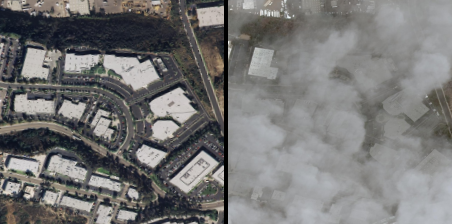

Фрагменты id = 2


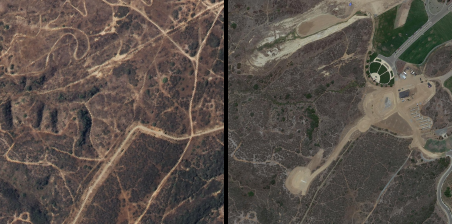

Фрагменты id = 3


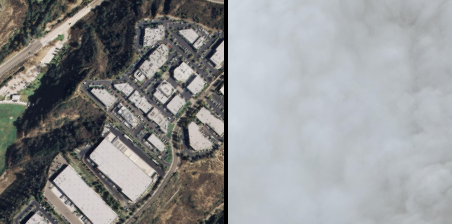

Фрагменты id = 4


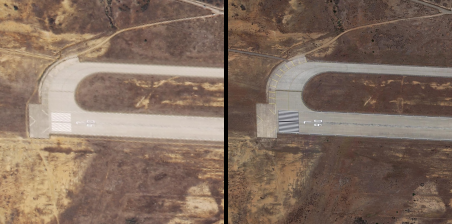

Фрагменты id = 5


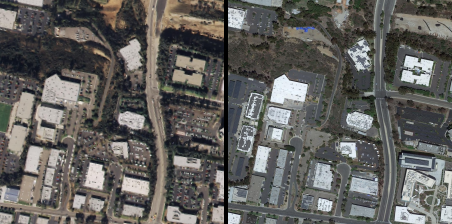

Фрагменты id = 6


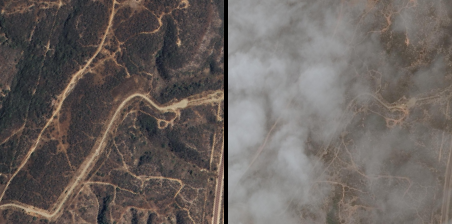

Фрагменты id = 7


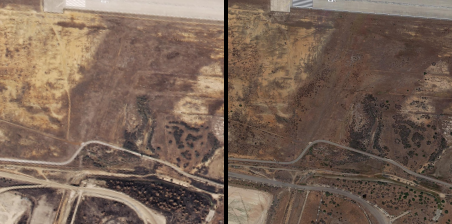

Фрагменты id = 8


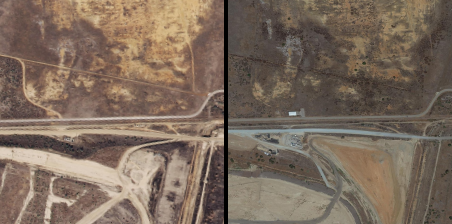

Фрагменты id = 9


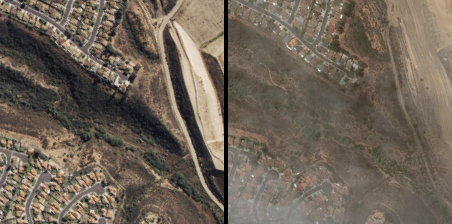

In [ ]:
id=0  # id фрагмента (от 0 до len(train))
fragment_size = new_size  # 224
z_img = np.zeros((fragment_size,4,3))  # разделитель изображений

for id in range(10):
  x, y, xa, ya = train_xya[id]
  x = round(x * resized_img.shape[1])
  y = round(y * resized_img.shape[0])
  ang = train_ang[id]

  # вырезаем фрагмент по координатам центра и значению угла
  fragment = subimage(image=resized_img, center=(x, y), theta=ang, width=fragment_size, height=fragment_size)
  # cv2_imshow(fragment)

  # открываем фрагмент из тренировочной базы
  train_frag = resize_image(cv2.imread(dir_img+train_img_lst[id]),width=fragment_size)
  # cv2_imshow(train_frag)

  print('Фрагменты id =', id)
  cv2_imshow(np.hstack([fragment,z_img, train_frag]))


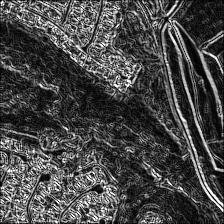

In [ ]:
scale = 1
delta = 0
ddepth = cv2.CV_16S

def make_sobel(img):

  gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

  grad_x = cv2.Sobel(gray, ddepth, 1, 0, ksize=3, scale=scale, delta=delta, borderType=cv2.BORDER_DEFAULT)
  grad_y = cv2.Sobel(gray, ddepth, 0, 1, ksize=3, scale=scale, delta=delta, borderType=cv2.BORDER_DEFAULT)

  abs_grad_x = cv2.convertScaleAbs(grad_x)
  abs_grad_y = cv2.convertScaleAbs(grad_y)


  grad = cv2.addWeighted(abs_grad_x, 0.5, abs_grad_y, 0.5, 0)
  
  return grad    
    
# fr = fragment
cv2_imshow(make_sobel(fragment))

In [ ]:
cv2.sobel

# Прототип решения

## +Готовим базу из подложки (функции)

In [33]:
dir_home

'/content/drive/MyDrive/Aerophoto/'

In [34]:
# cv2.imwrite(dir_home+'img_resized.png', resized_img)
resized_img = cv2.imread(dir_home+'img_resized_2294.png')

In [35]:
# новый размер фрагмента с учетом уменьшения подложки
new_size = round((BASE_IMG_SIZE/10496)*1024) 
new_size

224

**1. делим карту на 49 секторов, каждый размером четверть от общего размера (чтобы были перекрытия)**

In [36]:
def get_sector(img, parts=8, sectors=4):
  """ Функция возвращает массив из секторов вырезанных из подложки (img)
  :param: parts - делитель, определяет количество частей (по умолчанию 8, значит будет (8-1)*(8-1) частей) 
  :param: sectors - делитель, определяет размер сектора (по умолчанию 4, значит размер сектора 1/4) 
  :return: двумерный массив
  """
  output = []
  part_size = int(img.shape[1]/parts)
  sector_size = int(img.shape[1]/sectors) # изображение квадратное, поэтому сектора тоже будут квадратные
  i, j = 0, 0 # начальные координаты каждого сектора
  sectors_lst = []
  while i+sector_size <= img.shape[1]:
    while j+sector_size <= img.shape[0]:
      # print((i,j), ' ', end='')
      sectors_lst.append(resized_img[i: i+sector_size, j: j+sector_size,])
      # cv2_imshow(resized_img[i: i+sector_size, j: j+sector_size,])
      j += part_size
    # print()
    i += part_size
    j = 0
  return sectors_lst  # по умолчанию для изображения 1024pix вернется массив из 49 изображений

sectors_lst = get_sector(resized_img, parts=8, sectors=4)


In [37]:
# len(sectors_lst)

In [38]:
# cv2_imshow(sectors_lst[0])

**2. вырезаем случайные фрагменты**

In [39]:
resized_img.shape

(2294, 2294, 3)

In [40]:
def subimage(image, center, theta, width, height, shp=(2294, 2294)):
   ''' 
   Rotates OpenCV image around center with angle theta (in deg)
   then crops the image according to width and height.
   '''

   # Uncomment for theta in radians
   #theta *= 180/np.pi

   shape = ( image.shape[1], image.shape[0] ) # cv2.warpAffine expects shape in (length, height)

   matrix = cv2.getRotationMatrix2D( center=center, angle=theta, scale=1 )
   image = cv2.warpAffine( src=image, M=matrix, dsize=shape )

   x = int( center[0] - width/2  )
   y = int( center[1] - height/2 )

   image = image[ y:y+height, x:x+width ]

   return image

фрагмент: ((1298, 1385, 6))


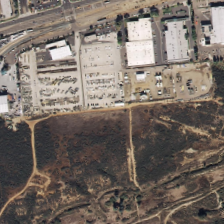

CPU times: user 126 ms, sys: 2.58 ms, total: 129 ms
Wall time: 151 ms


In [41]:
%%time
def get_fragment(img_sector, fragment_size = new_size): # todo rotate + augmentation
  """ Функция вырезает фрагмент размером fragment_size из сектора (img)
  :param: img_sector - изображение (numpy array) 
  :param: fragment_size - абсолютный размер фрагмента в пикселях 
  :return: фрагмент, координаты центра и угол
  """
  x = r(img_sector.shape[1]-fragment_size)
  y = r(img_sector.shape[0]-fragment_size)
  ang = r(360)

  # fragment = img_sector[x: x+fragment_size, y: y+fragment_size,]  # без поворота
  fragment = subimage(image=img_sector, center=(x+fragment_size//2, y+fragment_size//2), theta=ang, width=fragment_size, height=fragment_size)
  return fragment, x, y, ang

sec_id = 10
# frag, frag_x, frag_y, angel = get_fragment(sectors_lst[sec_id])
frag, frag_x, frag_y, angel = get_fragment(resized_img)
print(f'фрагмент: ({frag_x, frag_y, angel})')
cv2_imshow(frag)
# print('сектор из которого получили фрагмент:')
# cv2_imshow(resized_img)


**3 готовим базу для проверки гипотез**

In [42]:
# для упрощения берем сегменты без перекрытия (четные индексы)
# cv2_imshow(np.hstack([sectors_lst[0],sectors_lst[2]]))
# sectors_lst = sectors_lst[::2]  # берем только четные, чтобы не было перекрытий
# print()
# cv2_imshow(np.hstack([sectors_lst[0],sectors_lst[1]]))
# len(sectors_lst)

In [43]:
# разбиваем сектора на тренировочные и проверочные
# num_val_sectors = 5
# train_sectors = sectors_lst[:-num_val_sectors]
# val_sectors = sectors_lst[-num_val_sectors:]

In [44]:
# len(sectors_lst)

In [45]:
# генерируем обучающий датасет
def get_dataset_from_sector(sectors, full_sectors, dataset_size = 10):
  """ Функция создает датасет из секторов (X1) и фрагментов (X2) и принадлежности фрагмента сектору (Y [0,1])
  :param: sectors - массив секторов, которые используются для true
  :param: full_sectors - полный массив секторов, включая которые исопльзутся только для false
  :param: dataset_size - размер датасета 
  :return: X1 (сектор норм.), X2 (фрагмент норм.), Y (0,1) 
  """
  X1, X2, Y, coord = [], [], [], []
  for i in range(dataset_size):
    sector_id = r(len(sectors))
    if r(2): #  определяем случайно, должен ли фрагмент принадлежать сектору
      frag, frag_x, frag_y, angel = get_fragment(sectors[sector_id])
      X1.append(sectors[sector_id])
      X2.append(frag)
      Y.append(1)
      # print(sector_id, (frag_x, frag_y), Y[-1])
    else:
      b_sector_id = r(len(full_sectors))
      if b_sector_id == sector_id:  # чтобы не выбрать true сегмент
        b_sector_id += 1 
      if b_sector_id >= len(full_sectors): # чтобы не выйти за пределы массива
        b_sector_id = 0
      frag, frag_x, frag_y, angel = get_fragment(sectors[sector_id])
      X1.append(sectors_lst[b_sector_id])
      X2.append(frag)
      Y.append(0)
      # print(sector_id, (frag_x, frag_y), Y[-1], b_sector_id)
    coord.append((frag_x, frag_y, angel))

  return np.array(X1), np.array(X2), np.array(Y), coord

# x1_train, x2_train, y_train, coord_train = get_dataset_from_sector(train_sectors, sectors_lst, dataset_size=50)
# x1_val, x2_val, y_val, coord_val = get_dataset_from_sector(val_sectors, val_sectors, dataset_size=50)

In [46]:
# визуальная проверка
# for i in range(20):
#   print(y_train[i], coord_train[i])
#   cv2_imshow(x1_train[i]*255)
#   print()
#   cv2_imshow(x2_train[i]*255)
#   print('-------------------------------------')

## Прототип НС и обучение

In [ ]:
from tensorflow.keras.applications import VGG16, InceptionResNetV2, EfficientNetB5, ResNet50, ResNet152

In [ ]:
# для создания сети
from tensorflow.keras.models import Sequential, Model

# для создания слоев
from tensorflow.keras.layers import Dense, Conv2D, MaxPooling2D, Flatten, Dropout, BatchNormalization, SpatialDropout2D, RandomRotation
from tensorflow.keras.layers import Input, concatenate, GlobalAveragePooling2D, Softmax, ReLU
from tensorflow.keras.layers import Resizing, Concatenate, Reshape, AveragePooling2D


# для работы с изображениями
from tensorflow.keras.preprocessing import image

from tensorflow.keras.metrics import binary_accuracy, CategoricalAccuracy 

from tensorflow.keras.losses import BinaryCrossentropy, binary_crossentropy, categorical_crossentropy, CosineSimilarity

# оптимизатор
from tensorflow.keras.optimizers import Adam, SGD

from tensorflow.keras.callbacks import LambdaCallback, EarlyStopping, Callback

# модуль для отсчета времени
import time 
# import datetime

import matplotlib.pyplot as plt

In [ ]:
# x1_train[0].shape, x2_train[0].shape, 

((256, 256, 3), (100, 100, 3))

### Попытка 1 (в лоб)

In [ ]:
sec_height = 256 # Высота 
sec_width = 256 # Ширина 

frag_height = 100 # Высота 
frag_width = 100 # Ширина 

chanels = 3 # Количество каналов  

input_sec_shape = (sec_height, sec_width, chanels)  # на этот вход подаем сектор

input_frag_shape = (frag_height, frag_width, chanels)  # на этот вход подаем фрагмент


In [ ]:
input_sec = Input(shape=input_sec_shape)
input_frag = Input(shape=input_frag_shape)

base_model1 = ResNet50(weights="imagenet", include_top=False, input_tensor=input_sec)(input_sec)
base_model2 = ResNet152(weights="imagenet", include_top=False, input_tensor=input_frag)(input_frag)

# base_model = InceptionResNetV2(weights="imagenet", include_top=False, input_tensor=input)(input)

# top_model = base_model.output
# top_model1 = GlobalAveragePooling2D()(base_model1)
# top_model2 = GlobalAveragePooling2D()(base_model2)
top_model1 = Flatten()(base_model1)
top_model2 = Flatten()(base_model2)
# let's add a fully-connected layer
# top_model = Dense(1024, activation='relu')(top_model)

# top_model = Flatten()(top_model)
# top_model = Dense(1024, activation="relu")(top_model)  # уменьшаем выходной вектор до 1024

In [ ]:
concat = concatenate([top_model1,top_model2])
back = Dense(128, activation="relu", name="back1")(concat)
back = Dense(512, activation="relu", name="back2")(back)  
back = (Dense(64, activation="relu", name="back3")(back))  

output = (Dense(1, activation="sigmoid", name="output")(back))  

In [ ]:
model = Model([input_sec, input_frag], output) # without ArcFace

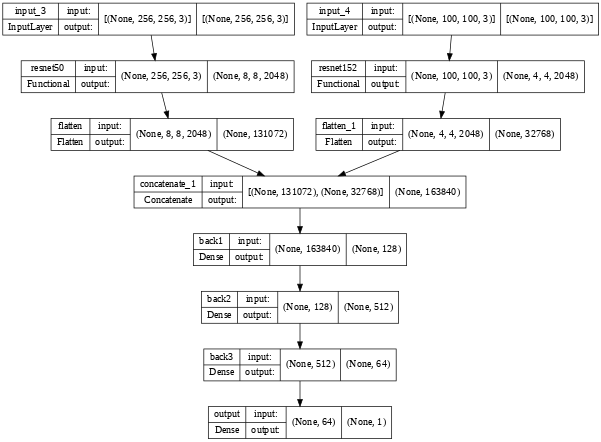

In [ ]:
from tensorflow.keras.utils import plot_model
plot_model(model,show_shapes=True,dpi=50, show_layer_names=True)

In [ ]:
model.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_3 (InputLayer)           [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 input_4 (InputLayer)           [(None, 100, 100, 3  0           []                               
                                )]                                                                
                                                                                                  
 resnet50 (Functional)          (None, 8, 8, 2048)   23587712    ['input_3[0][0]']                
                                                                                            

In [ ]:
model.compile(loss=binary_crossentropy,
              optimizer=Adam(learning_rate=1e-4),
              metrics=['accuracy'])

In [ ]:
# x1_train, x2_train, y_train = get_dataset(train_sectors, dataset_size=50)
# x1_val, x2_val, y_val = get_dataset(val_sectors, dataset_size=10)

In [ ]:
np.array([1,2,3,4,5])-3

array([-2, -1,  0,  1,  2])

Цикл: 0
10/10 [==============================] - 25s 686ms/step - loss: 0.4319 - accuracy: 0.7700 - val_loss: 0.7244 - val_accuracy: 0.5400
Цикл: 1
10/10 [==============================] - 4s 354ms/step - loss: 0.4609 - accuracy: 0.7600 - val_loss: 0.5999 - val_accuracy: 0.6600
Цикл: 2
10/10 [==============================] - 3s 326ms/step - loss: 0.4798 - accuracy: 0.7100 - val_loss: 0.8443 - val_accuracy: 0.5200
Цикл: 3
10/10 [==============================] - 3s 350ms/step - loss: 0.4575 - accuracy: 0.7900 - val_loss: 1.0160 - val_accuracy: 0.4400
Цикл: 4
10/10 [==============================] - 3s 328ms/step - loss: 0.3523 - accuracy: 0.8100 - val_loss: 2.0821 - val_accuracy: 0.2400
Цикл: 5
10/10 [==============================] - 4s 352ms/step - loss: 0.4548 - accuracy: 0.8200 - val_loss: 2.0710 - val_accuracy: 0.3400
Цикл: 6
10/10 [==============================] - 4s 353ms/step - loss: 0.4641 - accuracy: 0.8000 - val_loss: 2.6298 - val_accuracy: 0.3800
Цикл: 7
10/10 [===========

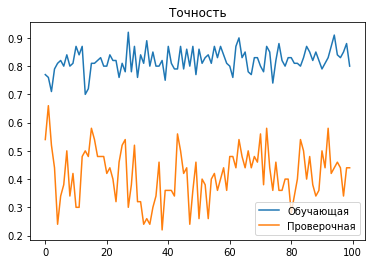

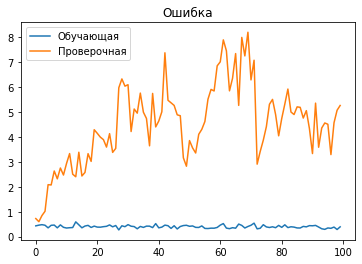

Executed


In [ ]:
hist = [[],[],[],[]]  # запись истории

for i in range(100):
  print('Цикл:', i)
  x1_train, x2_train, y_train, coord_train = get_dataset(train_sectors, sectors_lst, dataset_size=100)
  x1_val, x2_val, y_val, coord_val = get_dataset(val_sectors, val_sectors, dataset_size=50)
  store = model.fit([x1_train*2-1, x2_train*2-1], y_train,
                  epochs = 1,
                  batch_size = 10,
                  verbose = 1,
                  validation_data = ([x1_val*2-1, x2_val*2-1], y_val)
                  )
  
  # print('predicted:',model.predict([x1_val, x2_val]))

  del x1_train
  del x2_train
  del y_train

  del x1_val
  del x2_val
  del y_val

  hist[0].extend(store.history['accuracy'])
  hist[1].extend(store.history['val_accuracy'])
  hist[2].extend(store.history['loss'])
  hist[3].extend(store.history['val_loss'])

plt.plot(hist[0], label='Обучающая')
plt.plot(hist[1], label='Проверочная')
plt.legend()
plt.title('Точность')
plt.show()
plt.plot(hist[2], label='Обучающая')
plt.plot(hist[3], label='Проверочная')
plt.legend()
plt.title('Ошибка')
plt.show()

try:
  sound()
  print('Executed')
except:
  print('Executed')

In [ ]:
x1_test, x2_test, y_test, coord_test = get_dataset(val_sectors, val_sectors, dataset_size=20)

In [ ]:
p = model.predict([x1_test, x2_test])

In [ ]:
for i in range(len(p)):
  print('predict', p[i], 'true', y_test[i])

predict [0.00704077] true 1
predict [0.07736118] true 0
predict [0.04685775] true 0
predict [0.03037216] true 1
predict [0.00848597] true 1
predict [0.10064413] true 0
predict [0.0157751] true 1
predict [0.26216105] true 0
predict [0.03113024] true 1
predict [0.12485111] true 0
predict [0.05225494] true 0
predict [0.34228522] true 0
predict [0.03069208] true 1
predict [0.0091082] true 1
predict [0.09264348] true 0
predict [0.06231309] true 0
predict [0.01600031] true 1
predict [0.16571602] true 0
predict [0.09335043] true 0
predict [0.14014797] true 0


In [ ]:
xc, yc = 100, 100
x1, y1 = 90, 90
x2, y2 = 110, 110


In [ ]:
ang = 90

### Попытка 2 Conditional Attention for Content-based Image
https://www.bmvc2020-conference.com/assets/papers/0356.pdf

In [ ]:
sec_height = 256 # Высота 
sec_width = 256 # Ширина 

frag_height = 100 # Высота 
frag_width = 100 # Ширина 

chanels = 3 # Количество каналов  

input_sec_shape = (sec_height, sec_width, chanels)  # на этот вход подаем сектор

input_frag_shape = (frag_height, frag_width, chanels)  # на этот вход подаем фрагмент


In [ ]:
# base_model = ResNet50(weights="imagenet", include_top=False, input_shape=input_sec_shape)
base_model = ResNet50(weights=None, include_top=False, input_shape=input_sec_shape)

base_model2 = ResNet50(weights=None, include_top=False, input_shape=input_frag_shape)

# base_model = ResNet50(weights="imagenet", include_top=False, input_shape=(128,128,3)) # для теста

In [ ]:
embedding = Model(base_model.input, base_model.output, name='img_features')
embedding2 = Model(base_model2.input, base_model2.output, name='img_features2')

In [ ]:
input_sec = Input(shape=input_sec_shape)
# input_sec = BatchNormalization()(input_sec)
# input_sec_rs = Resizing(128,128)(input_sec)     #  для теста

input_frag = Input(shape=input_frag_shape)
# frag = Resizing(256,256)(input_frag)     #  увеличиваем размер 100->256, чтобы был один размер с сектором
# input_frag = BatchNormalization()(input_frag)

# input_frag_rs = Resizing(128,128)(input_frag)     #  для теста

In [ ]:
vec_sec = (embedding(input_sec)) # для боя input_sec
vec_sec = BatchNormalization()(vec_sec)

# vec_frag = GlobalAveragePooling2D()(embedding(frag))  # сжимаем в один вектор
vec_frag = GlobalAveragePooling2D()(embedding2(input_frag))  # сжимаем в один вектор

In [ ]:
# дублируем в один верктор, чтобы сделать конкатенацию с картой признаков
vec_frag = Reshape((1,1,2048))(vec_frag)
vec_frag = BatchNormalization()(vec_frag)
vec_frag = Concatenate(axis=1)([vec_frag,vec_frag,vec_frag,vec_frag,vec_frag,vec_frag,vec_frag,vec_frag])
vec_frag = Concatenate(axis=2)([vec_frag,vec_frag,vec_frag,vec_frag,vec_frag,vec_frag,vec_frag,vec_frag])

In [ ]:
# vec_frag.shape

TensorShape([None, 8, 8, 2048])

In [ ]:
concat = concatenate([vec_sec,vec_frag])

In [ ]:
# fusion_module
def scale_block(inp, ch):
  scale_block1 = Conv2D(ch, kernel_size=(1, 1), activation="relu", padding="same")(inp)
  scale_block2 = Conv2D(ch, kernel_size=(3, 3), activation="relu", padding="same")(inp)
  scale_block3 = Conv2D(ch, kernel_size=(5, 5), activation="relu", padding="same")(inp)
  scale_block4 = Conv2D(ch, kernel_size=(7, 7), activation="relu", padding="same")(inp)

  return concatenate([scale_block1,scale_block2,scale_block3,scale_block4])

scale_block1 = scale_block(concat, 512)

scale_block2 = scale_block(scale_block1, 256)

fusion_out = scale_block(scale_block2, 256)

In [ ]:
# x = Conv2D(256, kernel_size=(3, 3), activation="relu", padding="same")(fusion_out)
# x = Conv2D(1, kernel_size=(3, 3), activation="relu", padding="same")(x)
# x = MaxPooling2D(2)(x)
# x = MaxPooling2D(2)(fusion_out)
# x = MaxPooling2D(2)(concat)
x = GlobalAveragePooling2D()(concat)
x = Flatten()(x)

x = Dense(512, activation="relu", name="dense1")(x)
x = Dense(256, activation="relu", name="dense2")(x)

output = (Dense(1, activation="sigmoid", name="output")(x))  

In [ ]:
model = Model([input_sec, input_frag], output) # 

In [ ]:
model.summary()

Model: "model_3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_6 (InputLayer)           [(None, 100, 100, 3  0           []                               
                                )]                                                                
                                                                                                  
 input_5 (InputLayer)           [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 resizing_1 (Resizing)          (None, 256, 256, 3)  0           ['input_6[0][0]']                
                                                                                            

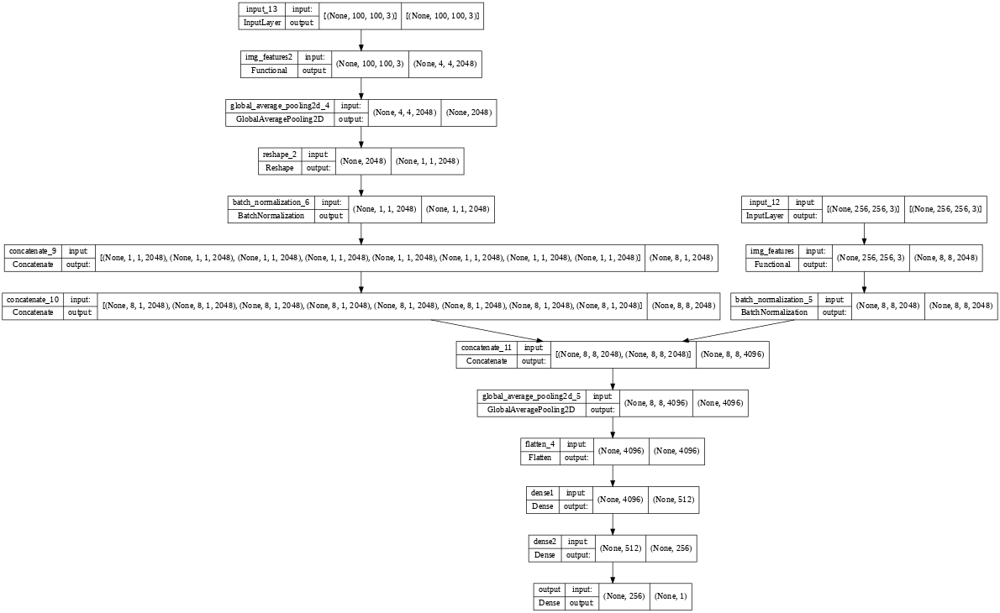

In [ ]:
from tensorflow.keras.utils import plot_model
plot_model(model,show_shapes=True,dpi=50, show_layer_names=True)

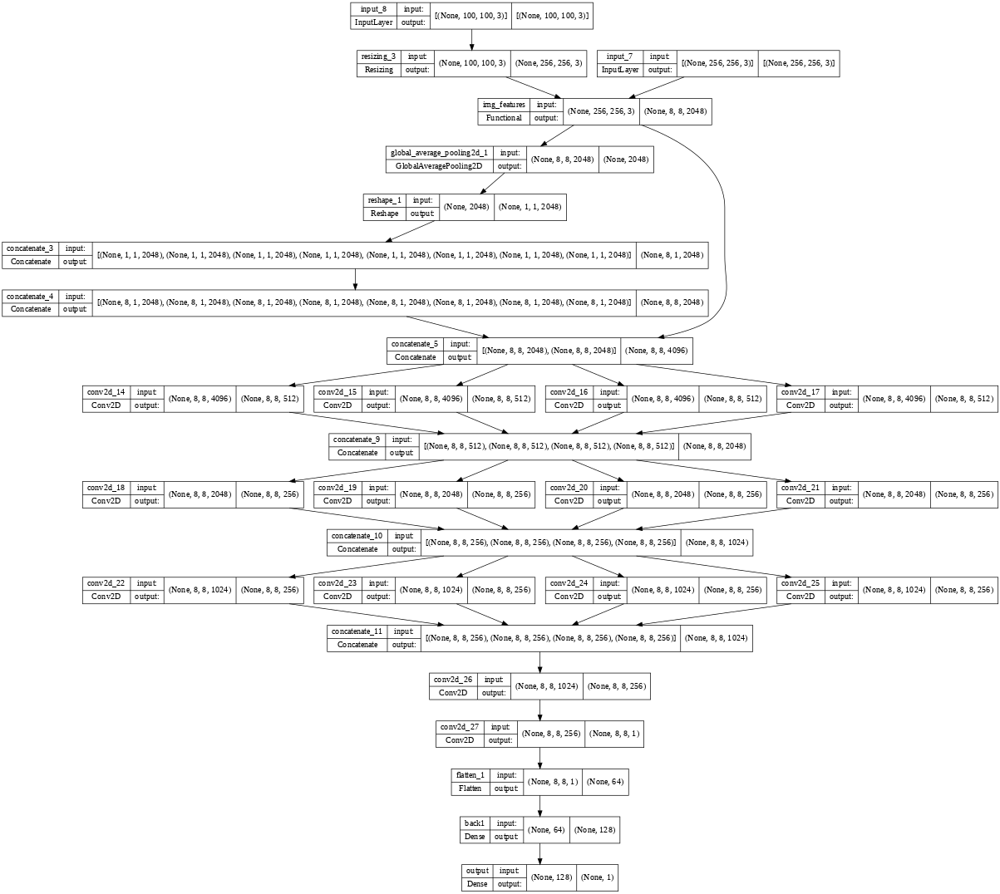

In [ ]:
from tensorflow.keras.utils import plot_model
plot_model(model,show_shapes=True,dpi=50, show_layer_names=True)

In [ ]:
model.compile(loss=binary_crossentropy,
              optimizer=Adam(learning_rate=1e-6),
              metrics=['accuracy'])

Цикл: 0
10/10 [==============================] - 14s 415ms/step - loss: 0.5448 - accuracy: 0.7300 - val_loss: 0.4925 - val_accuracy: 0.8000
Цикл: 1
10/10 [==============================] - 2s 221ms/step - loss: 0.5033 - accuracy: 0.7700 - val_loss: 0.3802 - val_accuracy: 0.8500
Цикл: 2
10/10 [==============================] - 2s 222ms/step - loss: 0.4609 - accuracy: 0.8000 - val_loss: 0.4717 - val_accuracy: 0.8500
Цикл: 3
10/10 [==============================] - 2s 220ms/step - loss: 0.5652 - accuracy: 0.6800 - val_loss: 0.4388 - val_accuracy: 0.9000
Цикл: 4
10/10 [==============================] - 2s 223ms/step - loss: 0.5038 - accuracy: 0.7600 - val_loss: 0.3987 - val_accuracy: 0.8000
Цикл: 5
10/10 [==============================] - 2s 220ms/step - loss: 0.5440 - accuracy: 0.6900 - val_loss: 0.4072 - val_accuracy: 0.8500
Цикл: 6
10/10 [==============================] - 2s 219ms/step - loss: 0.4761 - accuracy: 0.7900 - val_loss: 0.3822 - val_accuracy: 0.8000
Цикл: 7
10/10 [===========

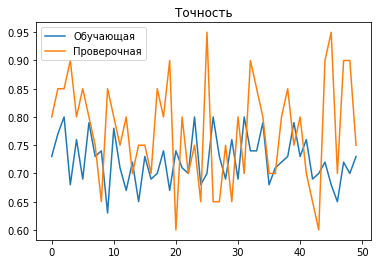

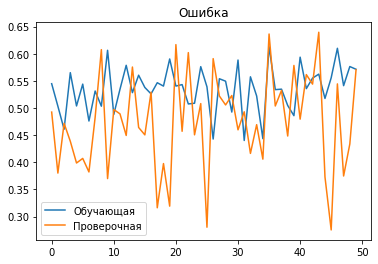

Executed


In [ ]:
hist = [[],[],[],[]]  # запись истории

for i in range(50):
  print('Цикл:', i)
  x1_train, x2_train, y_train, coord_train = get_dataset(sectors_lst, sectors_lst, dataset_size=100)
  x1_val, x2_val, y_val, coord_val = get_dataset(sectors_lst, sectors_lst, dataset_size=20)
  # store = model.fit([x1_train*2-1, x2_train*2-1], y_train,
  #                 epochs = 1,
  #                 batch_size = 10,
  #                 verbose = 1,
  #                 validation_data = ([x1_val*2-1, x2_val*2-1], y_val)
  #                 )

  store = model.fit([x1_train, x2_train], y_train,
                  epochs = 1,
                  batch_size = 10,
                  verbose = 1,
                  validation_data = ([x1_val, x2_val], y_val)
                  )

  # print('predicted:',model.predict([x1_val, x2_val]))

  del x1_train
  del x2_train
  del y_train

  del x1_val
  del x2_val
  del y_val

  hist[0].extend(store.history['accuracy'])
  hist[1].extend(store.history['val_accuracy'])
  hist[2].extend(store.history['loss'])
  hist[3].extend(store.history['val_loss'])

plt.plot(hist[0], label='Обучающая')
plt.plot(hist[1], label='Проверочная')
plt.legend()
plt.title('Точность')
plt.show()
plt.plot(hist[2], label='Обучающая')
plt.plot(hist[3], label='Проверочная')
plt.legend()
plt.title('Ошибка')
plt.show()



try:
  sound()
  print('Executed')
except:
  print('Executed')

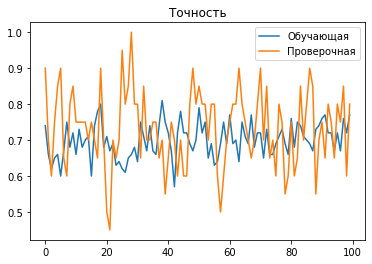

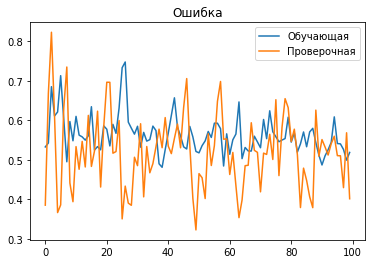

In [ ]:
plt.plot(hist[0], label='Обучающая')
plt.plot(hist[1], label='Проверочная')
plt.legend()
plt.title('Точность')
plt.show()
plt.plot(hist[2], label='Обучающая')
plt.plot(hist[3], label='Проверочная')
plt.legend()
plt.title('Ошибка')
plt.show()

In [ ]:
x1_test, x2_test, y_test, coord_test = get_dataset(sectors_lst, sectors_lst, dataset_size=20)

In [ ]:
p = model.predict([x1_test, x2_test])

In [ ]:
for i in range(len(p)):
  print('predict', p[i], 'true', y_test[i])

predict [0.8204848] true 1
predict [0.73950946] true 1
predict [0.6050081] true 1
predict [0.5405308] true 0
predict [0.6742942] true 1
predict [0.64629817] true 1
predict [0.00246653] true 0
predict [0.10528079] true 0
predict [0.7386204] true 1
predict [0.71547216] true 1
predict [0.7052893] true 1
predict [0.02670823] true 0
predict [0.74384445] true 1
predict [0.75809103] true 1
predict [0.46290925] true 1
predict [0.83499837] true 1
predict [0.854667] true 1
predict [0.04790797] true 0
predict [0.6798618] true 1
predict [0.5375707] true 1


## Обучение без подложки

### +Готовим свой датасет (функции)

In [47]:
# преобразуем угол в x и y координаты
def ang2xy(ang):
  return cos(pi/180*ang)*0.5+0.5, sin(pi/180*ang)*0.5+0.5  #нормируем угол [0:1], чтобы использовать одну функцию активации с координатами центра

# конвертация катетов в гипотенузу
def ab2c(a,b):
  print(a,b)
  return (((a-0.5)*2)**2+((b-0.5)*2)**2)**0.5 # x и y приводит к интервалу [-1:1]

In [48]:
%%time
# генерируем обучающий датасет
def get_dataset(img, dataset_size = 10):
  """ Функция создает датасет из базового изображения img и относительные координаты x, y и угол x,y нормированный [0:1]
  :param: sectors - массив секторов, которые используются для true
  :param: full_sectors - полный массив секторов, включая которые исопльзутся только для false
  :param: dataset_size - размер датасета 
  :return: X1 (сектор норм.), X2 (фрагмент норм.), Y (0,1) 
  """
  X, Y = [], []
  for i in range(dataset_size):
    frag, frag_x, frag_y, angel = get_fragment(img)
    X.append(frag)
    # print(angel)
    Y.append((frag_x/img.shape[1], frag_y/img.shape[0], *ang2xy(angel)))  # относительные координаты x, y и угол x,y нормированный [0:1]

  return np.array(X), np.array(Y)

# x_train, y_train = get_dataset(resized_img, dataset_size=10)
# id=0
# print(y_train[id])

CPU times: user 6 µs, sys: 1e+03 ns, total: 7 µs
Wall time: 11.7 µs


In [49]:
# np.max(y_train)

In [50]:
# y_train[:5]

### +Создаем НС

In [ ]:
from tensorflow.keras.applications import VGG16, InceptionResNetV2, EfficientNetB5, EfficientNetB6, ResNet50, ResNet152, ResNet50V2 
# для создания сети
from tensorflow.keras.models import Sequential, Model

# для создания слоев
from tensorflow.keras.layers import Dense, Conv2D, MaxPooling2D, Flatten, Dropout, BatchNormalization, SpatialDropout2D, RandomRotation
from tensorflow.keras.layers import Input, concatenate, GlobalAveragePooling2D, Softmax, ReLU, GlobalMaxPooling2D
from tensorflow.keras.layers import Resizing, Concatenate, Reshape, AveragePooling2D


# для работы с изображениями
from tensorflow.keras.preprocessing import image

from tensorflow.keras.metrics import binary_accuracy, CategoricalAccuracy 

from tensorflow.keras.losses import BinaryCrossentropy, binary_crossentropy, categorical_crossentropy, CosineSimilarity

# оптимизатор
from tensorflow.keras.optimizers import Adam, SGD

from tensorflow.keras.callbacks import LambdaCallback, EarlyStopping, Callback, LearningRateScheduler, ModelCheckpoint

from tensorflow.keras.applications.resnet_v2 import preprocess_input

# модуль для отсчета времени
import time 
# import datetime

import matplotlib.pyplot as plt

from tensorflow.keras import backend as K

In [ ]:
frag_height = 224 # Высота 
frag_width = 224 # Ширина 

chanels = 3 # Количество каналов  

input_frag_shape = (frag_height, frag_width, chanels)  # на этот вход подаем фрагмент

In [ ]:
input_frag = Input(shape=input_frag_shape)

x = preprocess_input(input_frag)

# base_model = ResNet152(weights="imagenet", include_top=False, input_tensor=input_frag)(input_frag)
base_model = ResNet50V2(weights="imagenet", include_top=False, input_tensor=x)(x)

94683136/94668760 [==============================] - 0s 0us/step


In [ ]:
# top_model = Flatten()(base_model)
top_model = GlobalAveragePooling2D()(base_model)
# top_model = GlobalMaxPooling2D()(base_model)

def create_back(base_model):
  back = Dense(256, activation="relu", name="back1")(base_model)
  # back = Flatten()(back)
  back = Dense(512, activation="relu", name="back2")(back)  
  back = Dense(128, activation="relu", name="back3")(back)  
  return back

back = create_back(top_model)

output = (Dense(4, activation="sigmoid", name="output")(back))  

In [ ]:
model = Model(input_frag, output) # 

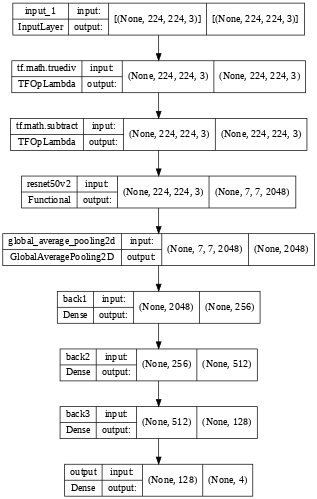

In [ ]:
from tensorflow.keras.utils import plot_model
plot_model(model,show_shapes=True,dpi=50, show_layer_names=True)

In [ ]:
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 tf.math.truediv (TFOpLambda  (None, 224, 224, 3)      0         
 )                                                               
                                                                 
 tf.math.subtract (TFOpLambd  (None, 224, 224, 3)      0         
 a)                                                              
                                                                 
 resnet50v2 (Functional)     (None, 7, 7, 2048)        23564800  
                                                                 
 global_average_pooling2d (G  (None, 2048)             0         
 lobalAveragePooling2D)                                          
                                                             

In [ ]:
model.compile(loss='mse',
              optimizer=Adam(learning_rate=1e-4),
              metrics=['mae'])

In [ ]:
# y_train.shape, y_val.shape, x_train.shape, x_val.shape

In [ ]:
checkpoint_filepath = '/content/drive/MyDrive/Aerophoto/checkpoint/weight/'
model_checkpoint_callback = ModelCheckpoint(
    filepath=checkpoint_filepath,
    save_weights_only=True,
    monitor='val_loss',
    mode='max',
    save_best_only=True)

In [ ]:
def scheduler(epoch, lr):
   if epoch < 9:
     return lr
   else:
     return lr * exp(-0.1)

callback = LearningRateScheduler(scheduler)


**функции для визуализации результатов предсказания**

In [ ]:
# функции для визуализации результатов предсказания
# преобразует координаты центра и поворот в коордитаты углов LT RT LB RB 
def M(angle):
  # угол от градуса до радиана
  angle = np.radians(angle)
  # матрица преобразования для вращения
  M = np.float32([ [np.cos(angle), -(np.sin(angle)), 0],
                [np.sin(angle), np.cos(angle), 0],
                [0, 0, 1] ])
  return M

def get_points(xya, img_shape=(640,640,3)):
  # переводим из нормализации в cos и sin угла
  point = np.float32([(xya[2]-0.5)*2,(xya[3]-0.5)*2,1])
  # print(point)

  # абсолютные координаты центра
  x_center = int(xya[0]*img_shape[1])
  y_center = int(xya[1]*img_shape[0])

  new_xy = (M(135) @ point) # left top
  x1, y1 = new_xy[0], new_xy[1]

  new_xy = (M(45) @ point) # left top
  x2, y2 = new_xy[0], new_xy[1]

  new_xy = (M(-135) @ point) # left top
  x3, y3 = new_xy[0], new_xy[1]

  new_xy = (M(-45) @ point) # left top
  x4, y4 = new_xy[0], new_xy[1]

  angle = atan2(xya[3],xya[2])

  points = np.array([[x1, y1], [x2, y2], [x3, y3], [x4, y4]])*frag.shape[0]/2/resized_img.shape[0]*img_shape[0]
  # смещение на координаты центра
  points[:,0] += x_center
  points[:,1] += y_center
  # print(x_center)

  return points


# tmp_img = resized_img.copy()
# for a in range(0,60,15):
#   # print(a)
#   c = get_points([0.5,0.5,ang2xy(a)[0],ang2xy(a)[1]])
#   points = np.int32(c)
#   points[[2,3]] = points[[3,2]]
#   cv2.polylines(tmp_img, [points], 1, (0,0,255))
#   cv2.circle(tmp_img,(int(0.5*resized_img.shape[1]),int(0.5*resized_img.shape[1])),3,(0,0,255))

# cv2_imshow(tmp_img)

In [ ]:
# для проверки предсказаний
x_test, y_test = get_dataset(resized_img, dataset_size=20)

In [ ]:
y_test[0]

array([0.43330427, 0.0331299 , 0.19216926, 0.10599462])

In [ ]:
sound()

### 1.1 Обучение на фрагментах из подложки

In [ ]:
model.load_weights('/content/drive/MyDrive/Aerophoto')

Цикл: 41
генерируем выборку: success!
Epoch 1/10
10/10 [==============================] - 25s 565ms/step - loss: 0.0016 - mae: 0.0293 - val_loss: 0.0383 - val_mae: 0.1427 - lr: 3.0197e-05
Epoch 2/10
10/10 [==============================] - 5s 459ms/step - loss: 0.0012 - mae: 0.0258 - val_loss: 0.0969 - val_mae: 0.2480 - lr: 3.0197e-05
Epoch 3/10
10/10 [==============================] - 5s 475ms/step - loss: 0.0011 - mae: 0.0251 - val_loss: 0.1104 - val_mae: 0.2546 - lr: 3.0197e-05
Epoch 4/10
10/10 [==============================] - 5s 476ms/step - loss: 0.0010 - mae: 0.0238 - val_loss: 0.1178 - val_mae: 0.2693 - lr: 3.0197e-05
Epoch 5/10
10/10 [==============================] - 5s 463ms/step - loss: 9.2456e-04 - mae: 0.0231 - val_loss: 0.1591 - val_mae: 0.3231 - lr: 3.0197e-05
Epoch 6/10
10/10 [==============================] - 5s 464ms/step - loss: 7.7938e-04 - mae: 0.0214 - val_loss: 0.1597 - val_mae: 0.3249 - lr: 3.0197e-05
Epoch 7/10
10/10 [==============================] - 5s 478m

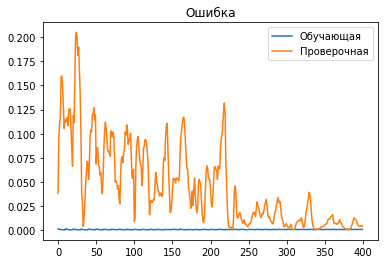

Executed


In [ ]:
hist = [[],[],[],[]]  # запись истории

for i in range(41,81):
  print('Цикл:', i)
  print('генерируем выборку: ', end='')
  x_train, y_train = get_dataset(resized_img, dataset_size=500)
  x_val, y_val = get_dataset(resized_img, dataset_size=200)
  print('success!')

  store = model.fit(x_train, y_train,
                  epochs = 10,
                  batch_size = 50,
                  verbose = 1,
                  validation_data = (x_val, y_val),
                  callbacks=[callback]
                  )
  
  # print('predicted:',model.predict([x1_val, x2_val]))

##############################
# выводим результат предсказания
  p = model.predict(x_test)
  points = np.int32(list(map(get_points,y_test)))
  points_pred = np.int32(list(map(get_points,p)))

  # print(points[0])
  points[:,[2,3]] = points[:,[3,2]]
  points_pred[:,[2,3]] = points_pred[:,[3,2]]
  # tmp_img = resized_img.copy()
  tmp_img = resize_image(resized_img, width=640)
  
  for id in range(10):
    cv2.polylines(tmp_img, np.int32([points[id]]), 1, (0,0,255), thickness=2)
    cv2.circle(tmp_img,(int(y_test[id][0]*tmp_img.shape[1]),int(y_test[id][1]*tmp_img.shape[1])),3,(0,0,255))

    cv2.polylines(tmp_img, np.int32([points_pred[id]]), 1, (255,0,0), thickness=2)
    cv2.circle(tmp_img,(int(p[id][0]*tmp_img.shape[1]),int(p[id][1]*tmp_img.shape[1])),3,(255,0,0))

    pt1 = (int(p[id][0]*tmp_img.shape[1]),int(p[id][1]*tmp_img.shape[1]))
    pt2 = (int(y_test[id][0]*tmp_img.shape[1]),int(y_test[id][1]*tmp_img.shape[1]))
    color = (0, 255, 0)
    thickness=1

    # pt1 = (100, 100)
    # pt2 = (400, 350)

    cv2.line(tmp_img, pt1, pt2,color,thickness)

  # cv2_imshow(resize_image(tmp_img, width=600))
  cv2.imwrite(dir_home+str(i)+'_img_pred.png', tmp_img)

  if not i%10:
    model.save('/content/drive/MyDrive/Aerophoto')
###########################

  del x_train
  del y_train

  del x_val
  del y_val

  # hist[0].extend(store.history['mae'])
  # hist[1].extend(store.history['val_accuracy'])
  hist[2].extend(store.history['loss'])
  hist[3].extend(store.history['val_loss'])

# plt.plot(hist[0], label='Обучающая')
# plt.plot(hist[1], label='Проверочная')
# plt.legend()
# plt.title('Точность')
# plt.show()
plt.plot(hist[2], label='Обучающая')
plt.plot(hist[3], label='Проверочная')
plt.legend()
plt.title('Ошибка')
plt.show()

try:
  sound()
  print('Executed')
except:
  print('Executed')

Цикл: 81
генерируем выборку: success!
Epoch 1/10
10/10 [==============================] - 5s 469ms/step - loss: 9.8771e-04 - mae: 0.0238 - val_loss: 0.0042 - val_mae: 0.0480 - lr: 5.5308e-07
Epoch 2/10
10/10 [==============================] - 5s 464ms/step - loss: 9.6353e-04 - mae: 0.0234 - val_loss: 0.0036 - val_mae: 0.0449 - lr: 5.5308e-07
Epoch 3/10
10/10 [==============================] - 5s 480ms/step - loss: 0.0010 - mae: 0.0237 - val_loss: 0.0035 - val_mae: 0.0439 - lr: 5.5308e-07
Epoch 4/10
10/10 [==============================] - 5s 481ms/step - loss: 9.7379e-04 - mae: 0.0236 - val_loss: 0.0032 - val_mae: 0.0422 - lr: 5.5308e-07
Epoch 5/10
10/10 [==============================] - 5s 482ms/step - loss: 8.9477e-04 - mae: 0.0230 - val_loss: 0.0028 - val_mae: 0.0394 - lr: 5.5308e-07
Epoch 6/10
10/10 [==============================] - 5s 469ms/step - loss: 0.0010 - mae: 0.0240 - val_loss: 0.0024 - val_mae: 0.0363 - lr: 5.5308e-07
Epoch 7/10
10/10 [==============================] - 

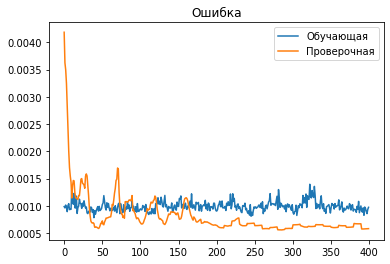

Executed


In [ ]:
hist = [[],[],[],[]]  # запись истории

for i in range(81,121):
  print('Цикл:', i)
  print('генерируем выборку: ', end='')
  x_train, y_train = get_dataset(resized_img, dataset_size=500)
  x_val, y_val = get_dataset(resized_img, dataset_size=200)
  print('success!')

  store = model.fit(x_train, y_train,
                  epochs = 10,
                  batch_size = 50,
                  verbose = 1,
                  validation_data = (x_val, y_val),
                  callbacks=[callback]
                  )
  
  # print('predicted:',model.predict([x1_val, x2_val]))

##############################
# выводим результат предсказания
  p = model.predict(x_test)
  points = np.int32(list(map(get_points,y_test)))
  points_pred = np.int32(list(map(get_points,p)))

  # print(points[0])
  points[:,[2,3]] = points[:,[3,2]]
  points_pred[:,[2,3]] = points_pred[:,[3,2]]
  # tmp_img = resized_img.copy()
  tmp_img = resize_image(resized_img, width=640)
  
  for id in range(10):
    cv2.polylines(tmp_img, np.int32([points[id]]), 1, (0,0,255), thickness=2)
    cv2.circle(tmp_img,(int(y_test[id][0]*tmp_img.shape[1]),int(y_test[id][1]*tmp_img.shape[1])),3,(0,0,255))

    cv2.polylines(tmp_img, np.int32([points_pred[id]]), 1, (255,0,0), thickness=2)
    cv2.circle(tmp_img,(int(p[id][0]*tmp_img.shape[1]),int(p[id][1]*tmp_img.shape[1])),3,(255,0,0))

    pt1 = (int(p[id][0]*tmp_img.shape[1]),int(p[id][1]*tmp_img.shape[1]))
    pt2 = (int(y_test[id][0]*tmp_img.shape[1]),int(y_test[id][1]*tmp_img.shape[1]))
    color = (0, 255, 0)
    thickness=1

    # pt1 = (100, 100)
    # pt2 = (400, 350)

    cv2.line(tmp_img, pt1, pt2,color,thickness)

  # cv2_imshow(resize_image(tmp_img, width=600))
  cv2.imwrite(dir_home+str(i)+'_img_pred.png', tmp_img)

  if not i%10:
    model.save('/content/drive/MyDrive/Aerophoto')
###########################

  del x_train
  del y_train

  del x_val
  del y_val

  # hist[0].extend(store.history['mae'])
  # hist[1].extend(store.history['val_accuracy'])
  hist[2].extend(store.history['loss'])
  hist[3].extend(store.history['val_loss'])

# plt.plot(hist[0], label='Обучающая')
# plt.plot(hist[1], label='Проверочная')
# plt.legend()
# plt.title('Точность')
# plt.show()
plt.plot(hist[2], label='Обучающая')
plt.plot(hist[3], label='Проверочная')
plt.legend()
plt.title('Ошибка')
plt.show()

try:
  sound()
  print('Executed')
except:
  print('Executed')

Цикл: 121
генерируем выборку: success!
Epoch 1/10
10/10 [==============================] - 5s 508ms/step - loss: 0.0011 - mae: 0.0241 - val_loss: 5.8246e-04 - val_mae: 0.0185 - lr: 1.0130e-08
Epoch 2/10
10/10 [==============================] - 5s 510ms/step - loss: 0.0011 - mae: 0.0232 - val_loss: 5.8453e-04 - val_mae: 0.0186 - lr: 1.0130e-08
Epoch 3/10
10/10 [==============================] - 5s 509ms/step - loss: 0.0011 - mae: 0.0243 - val_loss: 5.8590e-04 - val_mae: 0.0186 - lr: 1.0130e-08
Epoch 4/10
10/10 [==============================] - 5s 516ms/step - loss: 9.7959e-04 - mae: 0.0232 - val_loss: 5.8693e-04 - val_mae: 0.0186 - lr: 1.0130e-08
Epoch 5/10
10/10 [==============================] - 5s 521ms/step - loss: 0.0011 - mae: 0.0242 - val_loss: 5.8824e-04 - val_mae: 0.0186 - lr: 1.0130e-08
Epoch 6/10
10/10 [==============================] - 5s 527ms/step - loss: 0.0011 - mae: 0.0245 - val_loss: 5.8985e-04 - val_mae: 0.0187 - lr: 1.0130e-08
Epoch 7/10
10/10 [=====================

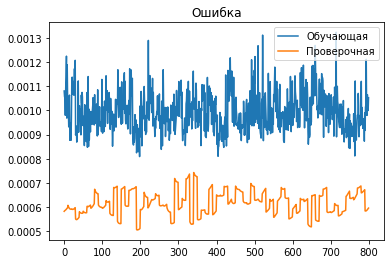

Executed


In [ ]:
hist = [[],[],[],[]]  # запись истории

for i in range(121,201):
  print('Цикл:', i)
  print('генерируем выборку: ', end='')
  x_train, y_train = get_dataset(resized_img, dataset_size=500)
  x_val, y_val = get_dataset(resized_img, dataset_size=200)
  print('success!')

  store = model.fit(x_train, y_train,
                  epochs = 10,
                  batch_size = 50,
                  verbose = 1,
                  validation_data = (x_val, y_val),
                  callbacks=[callback]
                  )
  
  # print('predicted:',model.predict([x1_val, x2_val]))

##############################
# выводим результат предсказания
  p = model.predict(x_test)
  points = np.int32(list(map(get_points,y_test)))
  points_pred = np.int32(list(map(get_points,p)))

  # print(points[0])
  points[:,[2,3]] = points[:,[3,2]]
  points_pred[:,[2,3]] = points_pred[:,[3,2]]
  # tmp_img = resized_img.copy()
  tmp_img = resize_image(resized_img, width=640)
  
  for id in range(10):
    cv2.polylines(tmp_img, np.int32([points[id]]), 1, (0,0,255), thickness=2)
    cv2.circle(tmp_img,(int(y_test[id][0]*tmp_img.shape[1]),int(y_test[id][1]*tmp_img.shape[1])),3,(0,0,255))

    cv2.polylines(tmp_img, np.int32([points_pred[id]]), 1, (255,0,0), thickness=2)
    cv2.circle(tmp_img,(int(p[id][0]*tmp_img.shape[1]),int(p[id][1]*tmp_img.shape[1])),3,(255,0,0))

    pt1 = (int(p[id][0]*tmp_img.shape[1]),int(p[id][1]*tmp_img.shape[1]))
    pt2 = (int(y_test[id][0]*tmp_img.shape[1]),int(y_test[id][1]*tmp_img.shape[1]))
    color = (0, 255, 0)
    thickness=1

    # pt1 = (100, 100)
    # pt2 = (400, 350)

    cv2.line(tmp_img, pt1, pt2,color,thickness)

  # cv2_imshow(resize_image(tmp_img, width=600))
  cv2.imwrite(dir_home+str(i)+'_img_pred.png', tmp_img)

  if not i%10:
    model.save('/content/drive/MyDrive/Aerophoto')
###########################

  del x_train
  del y_train

  del x_val
  del y_val

  # hist[0].extend(store.history['mae'])
  # hist[1].extend(store.history['val_accuracy'])
  hist[2].extend(store.history['loss'])
  hist[3].extend(store.history['val_loss'])

# plt.plot(hist[0], label='Обучающая')
# plt.plot(hist[1], label='Проверочная')
# plt.legend()
# plt.title('Точность')
# plt.show()
plt.plot(hist[2], label='Обучающая')
plt.plot(hist[3], label='Проверочная')
plt.legend()
plt.title('Ошибка')
plt.show()

try:
  sound()
  print('Executed')
except:
  print('Executed')

In [ ]:
model.save('/content/drive/MyDrive/Aerophoto/weights')

### Результат предсказаний

In [ ]:
# from keras.models import load_model

In [ ]:
# checkpoint_filepath

'/content/drive/MyDrive/Aerophoto/checkpoint/weight/'

In [ ]:
# model.load_weights(checkpoint_filepath)
# model = load_model('/content/drive/MyDrive/Aerophoto/checkpoint.data-00000-of-00001')

In [ ]:
x_test, y_test = get_dataset(resized_img, dataset_size=10)

In [ ]:
x_test.shape

(20, 224, 224, 3)

In [ ]:
p = model.predict(x_test)

In [ ]:
p = model.evaluate(x_test, y_test)

1/1 [==============================] - 4s 4s/step - loss: 5.2548e-04 - mae: 0.0189


In [ ]:
# тест на реальных данных
p = model.evaluate(train_img[:20], train_xya[:20])

1/1 [==============================] - 4s 4s/step - loss: 0.0965 - mae: 0.2293


In [ ]:
p[:5]

array([[0.5079579 , 0.36783466, 0.9070099 , 0.2884708 ],
       [0.75041   , 0.7638982 , 0.19596449, 0.88413   ],
       [0.57809466, 0.14347647, 0.67637277, 0.4368418 ],
       [0.6040809 , 0.32554224, 0.45395297, 0.86890787],
       [0.8007487 , 0.31649283, 0.980411  , 0.33244526]], dtype=float32)

In [ ]:
y_test[:5]

array([[0.39058413, 0.42632956, 0.8146602 , 0.11142702],
       [0.78029643, 0.80906713, 0.42178277, 0.99384417],
       [0.58195292, 0.0065388 , 0.67918397, 0.03320979],
       [0.73016565, 0.1342633 , 0.6873033 , 0.96359193],
       [0.61203139, 0.37750654, 0.9330127 , 0.25      ]])

In [ ]:
rad = (frag.shape[0]**2 + frag.shape[1]**2)**0.5/2  # расстояние от центра фрагмента до угла

70.71067811865476

In [ ]:
points[0]

array([[459, 210],
       [528, 196],
       [514, 127],
       [445, 141]], dtype=int32)

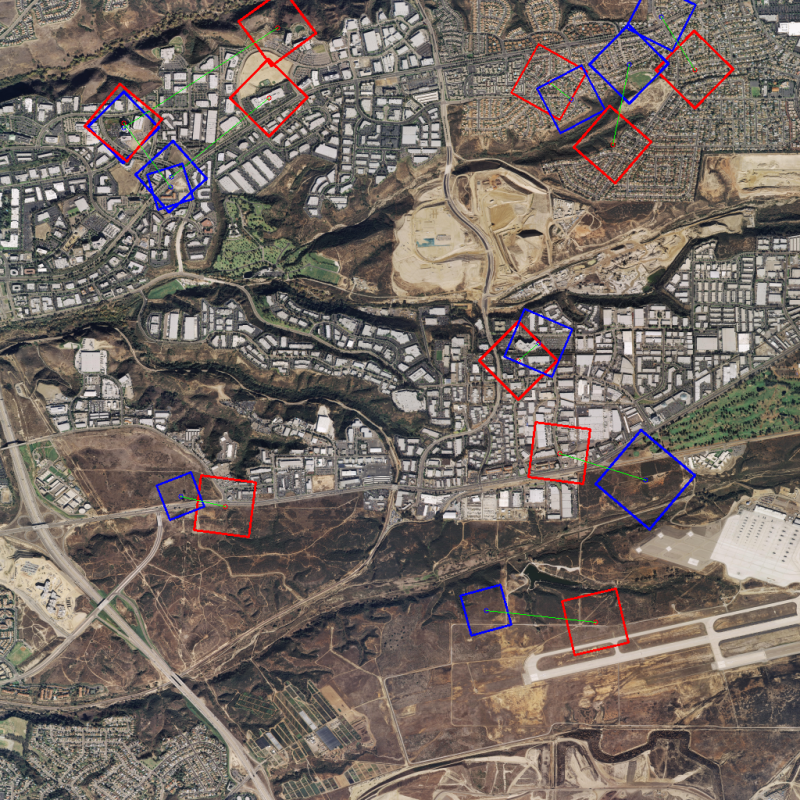

In [ ]:
cv2_imshow(resize_image(tmp_img, width=800))

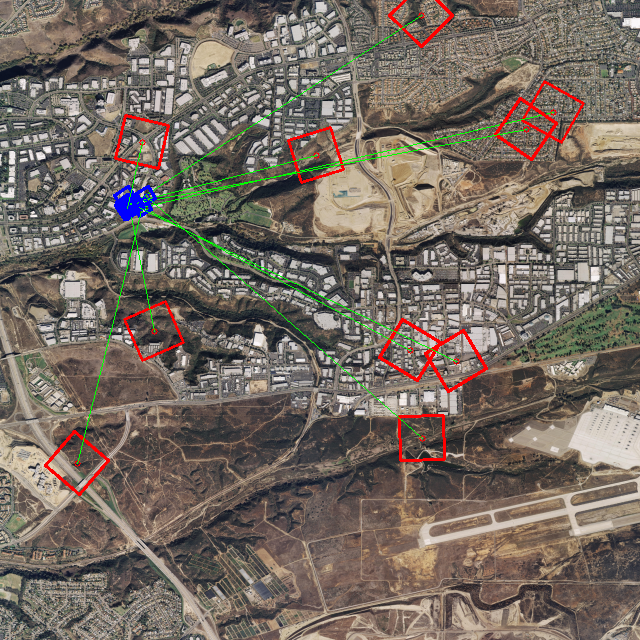

In [ ]:
points = np.int32(list(map(get_points,y_test)))
points_pred = np.int32(list(map(get_points,p)))

# print(points[0])
points[:,[2,3]] = points[:,[3,2]]
points_pred[:,[2,3]] = points_pred[:,[3,2]]
# tmp_img = resized_img.copy()
tmp_img = resize_image(resized_img, width=640)

for id in range(10):
  cv2.polylines(tmp_img, np.int32([points[id]]), 1, (0,0,255), thickness=2)
  cv2.circle(tmp_img,(int(y_test[id][0]*tmp_img.shape[1]),int(y_test[id][1]*tmp_img.shape[1])),3,(0,0,255))

  cv2.polylines(tmp_img, np.int32([points_pred[id]]), 1, (255,0,0), thickness=2)
  cv2.circle(tmp_img,(int(p[id][0]*tmp_img.shape[1]),int(p[id][1]*tmp_img.shape[1])),3,(255,0,0))

  pt1 = (int(p[id][0]*tmp_img.shape[1]),int(p[id][1]*tmp_img.shape[1]))
  pt2 = (int(y_test[id][0]*tmp_img.shape[1]),int(y_test[id][1]*tmp_img.shape[1]))
  color = (0, 255, 0)
  thickness=1

  # pt1 = (100, 100)
  # pt2 = (400, 350)

  cv2.line(tmp_img, pt1, pt2,color,thickness)

cv2_imshow(tmp_img)

In [ ]:
tmp_img.shape

In [ ]:
for i in range(len(p)):
  print('predict', p[i], 'true', y_test[i])

predict [0.80050606 0.62495697 0.37643215 0.69645786] true [0.87207031 0.203125   0.28081443 0.94939702]
predict [0.262716   0.41996923 0.3796225  0.0115138 ] true [0.10644531 0.16113281 0.46512176 0.00121797]
predict [0.27328968 0.41162032 0.04441624 0.37188974] true [0.15332031 0.04589844 0.00273905 0.44773577]
predict [0.3075119  0.6103768  0.314562   0.57452863] true [0.453125   0.74707031 0.94939702 0.28081443]
predict [0.04850125 0.61892784 0.9633199  0.34063557] true [0.02148438 0.41308594 0.99878203 0.46512176]
predict [0.6963718  0.72083044 0.21725927 0.74391836] true [0.69824219 0.10253906 0.22040355 0.91451879]
predict [0.4777986  0.664096   0.07298141 0.57660794] true [0.46484375 0.15234375 0.01485214 0.62096095]
predict [0.34050685 0.7677419  0.16835752 0.0487157 ] true [0.421875   0.80957031 0.22768048 0.08066472]
predict [0.390493   0.37273213 0.5389184  0.7580933 ] true [0.51171875 0.53027344 0.51744975 0.99969541]
predict [0.5064527  0.45017222 0.03711891 0.60863703] t



---



### Готовим тренировочный датасет 

In [ ]:
org_shape, train_img.shape, train_xya.shape

((10496, 10496, 3), (800, 224, 224, 3), (800, 4))

### 1.2 Дообучение на тренировочном датасете

In [ ]:
seed_everything(42)

In [ ]:
# !!! повтор ниже !!!
# метрика для расчета score
def compute_metric_simp(data_true, data_pred, outImageW = org_shape[1], outImageH = org_shape[0]):

  x_center_true = data_true[0]
  y_center_true = data_true[1]

  x_metr = x_center_true - data_pred[0]
  y_metr = y_center_true - data_pred[1] 

  angle_true = xy2ang(data_true[2], data_true[3])
  angle_pred = xy2ang(data_pred[2], data_pred[3])

  # print('x_metr, y_metr:', x_metr, y_metr, '\nangle_true, angle_pred:', angle_true, angle_pred)
  # print()

  metr =  1- (0.7 * 0.5 * (abs(x_metr) + abs(y_metr))/2 + 0.3 *min(abs(angle_true - angle_pred), abs(abs(angle_true - angle_pred)-360))/360)
  return metr

# compute_metric_simp(train_xya[0], train_xya[6])

In [ ]:
# метрика для расчета score
# def my_metric(y_true, y_pred, outImageW = org_shape[1], outImageH = org_shape[0]):

#   x_center_true = y_true[0]
#   y_center_true = y_true[1]

#   x_metr = x_center_true - y_pred[0]
#   y_metr = y_center_true - y_pred[1] 

#   angle_true = xy2ang(y_true[2], y_true[3])
#   angle_pred = xy2ang(y_pred[2], y_pred[3])

#   # print('x_metr, y_metr:', x_metr, y_metr, '\nangle_true, angle_pred:', angle_true, angle_pred)
#   # print()

#   metr =  1- (0.7 * 0.5 * (K.abs(x_metr) + abs(y_metr))/2 + 0.3 *min(abs(angle_true - angle_pred), abs(abs(angle_true - angle_pred)-360))/360)
#   return metr

In [ ]:
model.load_weights('/content/drive/MyDrive/Aerophoto')

In [ ]:
model.compile(loss='mse',
              optimizer=Adam(learning_rate=1e-5),
              metrics=['mae'])

Цикл: 0
генерируем выборку: success!
Epoch 1/11
12/12 [==============================] - 6s 487ms/step - loss: 0.0166 - mae: 0.0917 - val_loss: 0.0319 - val_mae: 0.1267 - lr: 2.4788e-08
Epoch 2/11
12/12 [==============================] - 6s 473ms/step - loss: 0.0151 - mae: 0.0886 - val_loss: 0.0319 - val_mae: 0.1267 - lr: 2.4788e-08
Epoch 3/11
12/12 [==============================] - 6s 474ms/step - loss: 0.0155 - mae: 0.0900 - val_loss: 0.0319 - val_mae: 0.1267 - lr: 2.4788e-08
Epoch 4/11
12/12 [==============================] - 6s 476ms/step - loss: 0.0161 - mae: 0.0904 - val_loss: 0.0320 - val_mae: 0.1268 - lr: 2.4788e-08
Epoch 5/11
12/12 [==============================] - 6s 488ms/step - loss: 0.0160 - mae: 0.0911 - val_loss: 0.0320 - val_mae: 0.1268 - lr: 2.4788e-08
Epoch 6/11
12/12 [==============================] - 6s 480ms/step - loss: 0.0156 - mae: 0.0901 - val_loss: 0.0320 - val_mae: 0.1268 - lr: 2.4788e-08
Epoch 7/11
12/12 [==============================] - 6s 477ms/step - l

No handles with labels found to put in legend.


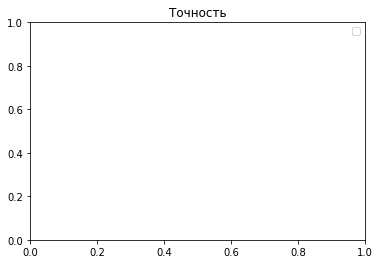

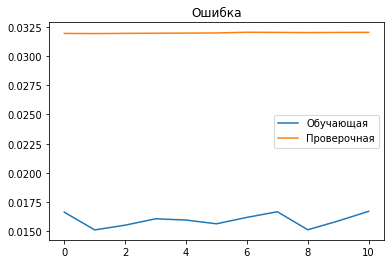

Executed


In [ ]:
hist = [[],[],[],[]]  # запись истории

for i in range(1):
  print('Цикл:', i)
  print('генерируем выборку: ', end='')
  # x_train, y_train = get_dataset(resized_img, dataset_size=500)
  # x_val, y_val = get_dataset(resized_img, dataset_size=200)
  print('success!')

  store = model.fit(train_img[:600], train_xya[:600],
                  epochs = 11,
                  batch_size = 50,
                  verbose = 1,
                  # validation_data = (x_val, y_val),
                  validation_data = (train_img[600:], train_xya[600:]),
                  callbacks=[callback]
                  )
  
  # print('predicted:',model.predict([x1_val, x2_val]))

##############################
# выводим результат предсказания
  p = model.predict(x_test)
  points = np.int32(list(map(get_points,y_test)))
  points_pred = np.int32(list(map(get_points,p)))

  # print(points[0])
  points[:,[2,3]] = points[:,[3,2]]
  points_pred[:,[2,3]] = points_pred[:,[3,2]]
  # tmp_img = resized_img.copy()
  tmp_img = resize_image(resized_img, width=640)
  
  for id in range(10):
    cv2.polylines(tmp_img, np.int32([points[id]]), 1, (0,0,255), thickness=2)
    cv2.circle(tmp_img,(int(y_test[id][0]*tmp_img.shape[1]),int(y_test[id][1]*tmp_img.shape[1])),3,(0,0,255))

    cv2.polylines(tmp_img, np.int32([points_pred[id]]), 1, (255,0,0), thickness=2)
    cv2.circle(tmp_img,(int(p[id][0]*tmp_img.shape[1]),int(p[id][1]*tmp_img.shape[1])),3,(255,0,0))

    pt1 = (int(p[id][0]*tmp_img.shape[1]),int(p[id][1]*tmp_img.shape[1]))
    pt2 = (int(y_test[id][0]*tmp_img.shape[1]),int(y_test[id][1]*tmp_img.shape[1]))
    color = (0, 255, 0)
    thickness=1

    # pt1 = (100, 100)
    # pt2 = (400, 350)

    cv2.line(tmp_img, pt1, pt2,color,thickness)

  # cv2_imshow(resize_image(tmp_img, width=600))
  cv2.imwrite(dir_home+'show_training/a'+str(i)+'_img_pred.png', tmp_img)

  if not i%10:
    model.save('/content/drive/MyDrive/Aerophoto/weights/2/')
###########################

  # del x_train
  # del y_train

  # del x_val
  # del y_val

  # hist[0].extend(store.history['compute_metric_simp'])
  # hist[1].extend(store.history['val_compute_metric_simp'])
  hist[2].extend(store.history['loss'])
  hist[3].extend(store.history['val_loss'])

# plt.plot(hist[0], label='Обучающая')
# plt.plot(hist[1], label='Проверочная')
# plt.legend()
# plt.title('Точность')
# plt.show()
plt.plot(hist[2], label='Обучающая')
plt.plot(hist[3], label='Проверочная')
plt.legend()
plt.title('Ошибка')
plt.show()

try:
  sound()
  print('Executed')
except:
  print('Executed')

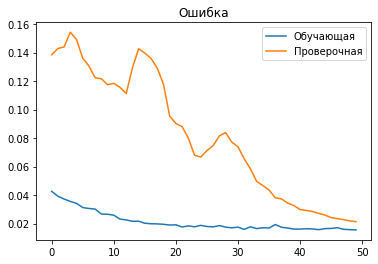

In [ ]:
plt.plot(hist[2], label='Обучающая')
plt.plot(hist[3], label='Проверочная')
plt.legend()
plt.title('Ошибка')
plt.show()

### 2 Другой бэкэнд

In [ ]:
from tensorflow.keras.applications import VGG16, InceptionResNetV2, EfficientNetB5, EfficientNetB6, EfficientNetV2M, ResNet50, ResNet152, ResNet50V2, Xception

from tensorflow.keras.applications import resnet_v2, efficientnet, efficientnet_v2, xception, inception_resnet_v2


In [ ]:
input_frag = Input(shape=input_frag_shape)
preproc = []
base_model = []

preproc.append(inception_resnet_v2.preprocess_input(input_frag))
preproc.append(efficientnet.preprocess_input(input_frag))
preproc.append(efficientnet_v2.preprocess_input(input_frag))
preproc.append(xception.preprocess_input(input_frag))

base_model.append(InceptionResNetV2(weights="imagenet", pooling='avg', include_top=False, input_tensor=preproc[0])(preproc[0]))
base_model.append(EfficientNetB6(weights="imagenet", pooling='avg', include_top=False, input_tensor=preproc[1])(preproc[1]))
base_model.append(EfficientNetV2M(weights="imagenet", pooling='avg', include_top=False, input_tensor=input_frag)(input_frag))
base_model.append(Xception(weights="imagenet", pooling='avg', include_top=False, input_tensor=preproc[3])(preproc[3]))


83697664/83683744 [==============================] - 1s 0us/step


In [ ]:
models_name = ['InceptionResNetV2', 'EfficientNetB6', 'EfficientNetV2M', 'Xception']

In [ ]:
# !!! повтор ниже !!!
def create_back(base_model, act = "sigmoid", d1 = 256, d2 = 512, d3 = 128):
  back = Dense(d1, activation="relu", name="back1")(base_model)
  # back = Flatten()(back)
  back = Dense(d2, activation="relu", name="back2")(back)  
  back = Dense(d3, activation="relu", name="back3")(back)  
  output = (Dense(4, activation=act, name="output")(back))  
  return output


In [ ]:
seed_everything(42)

models = []

models.append(Model(input_frag, create_back(base_model[0]))) # 
models.append(Model(input_frag, create_back(base_model[1]))) # 
models.append(Model(input_frag, create_back(base_model[2]))) # 
models.append(Model(input_frag, create_back(base_model[3]))) # 

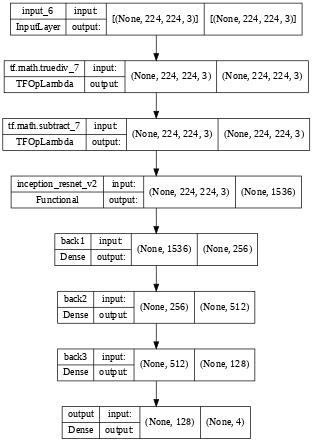

In [ ]:
from tensorflow.keras.utils import plot_model
plot_model(models[0],show_shapes=True,dpi=50, show_layer_names=True)

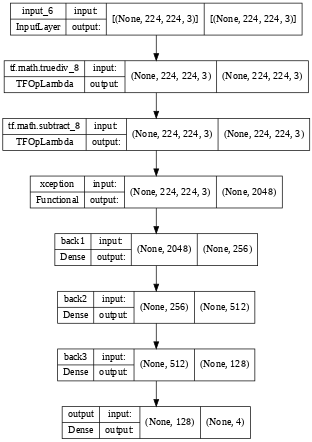

In [ ]:
plot_model(models[1],show_shapes=True,dpi=50, show_layer_names=True)
plot_model(models[2],show_shapes=True,dpi=50, show_layer_names=True)
plot_model(models[3],show_shapes=True,dpi=50, show_layer_names=True)

In [ ]:
del model

Обучаем модель: InceptionResNetV2
Epoch 1/11
60/60 [==============================] - 37s 334ms/step - loss: 0.0384 - mae: 0.1498 - val_loss: 0.3161 - val_mae: 0.4818 - lr: 0.0010
Epoch 2/11
60/60 [==============================] - 15s 249ms/step - loss: 0.0288 - mae: 0.1270 - val_loss: 0.2940 - val_mae: 0.4496 - lr: 0.0010
Epoch 3/11
60/60 [==============================] - 15s 251ms/step - loss: 0.0306 - mae: 0.1273 - val_loss: 0.3535 - val_mae: 0.5122 - lr: 0.0010
Epoch 4/11
60/60 [==============================] - 15s 247ms/step - loss: 0.0227 - mae: 0.1116 - val_loss: 0.3535 - val_mae: 0.5122 - lr: 0.0010
Epoch 5/11
60/60 [==============================] - 16s 265ms/step - loss: 0.0189 - mae: 0.1009 - val_loss: 0.3005 - val_mae: 0.4534 - lr: 0.0010
Epoch 6/11
60/60 [==============================] - 16s 263ms/step - loss: 0.0205 - mae: 0.1022 - val_loss: 0.3082 - val_mae: 0.4669 - lr: 0.0010
Epoch 7/11
60/60 [==============================] - 15s 244ms/step - loss: 0.0218 - mae: 0

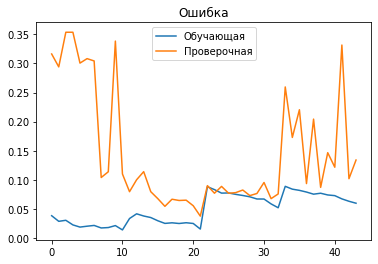

Executed


In [ ]:
hist = [[],[],[],[]]  # запись истории

for i in range(len(models_name)):
  print('Обучаем модель:', models_name[i])
  seed_everything(42)
  model = models[i]
  model.compile(loss='mse',
                optimizer=Adam(learning_rate=1e-3),
                metrics=['mae'])

  # print('генерируем выборку: ', end='')
  # x_train, y_train = get_dataset(resized_img, dataset_size=500)
  # x_val, y_val = get_dataset(resized_img, dataset_size=200)
  # print('success!')

  store = model.fit(train_img[:600], train_xya[:600],
                  epochs = 11,
                  batch_size = 10,
                  verbose = 1,
                  # validation_data = (x_val, y_val),
                  validation_data = (train_img[600:], train_xya[600:]),
                  callbacks=[callback]
                  )
  
  # print('predicted:',model.predict([x1_val, x2_val]))

##############################
# выводим результат предсказания
  p = model.predict(x_test)
  points = np.int32(list(map(get_points,y_test)))
  points_pred = np.int32(list(map(get_points,p)))

  # print(points[0])
  points[:,[2,3]] = points[:,[3,2]]
  points_pred[:,[2,3]] = points_pred[:,[3,2]]
  # tmp_img = resized_img.copy()
  tmp_img = resize_image(resized_img, width=640)
  
  for id in range(10):
    cv2.polylines(tmp_img, np.int32([points[id]]), 1, (0,0,255), thickness=2)
    cv2.circle(tmp_img,(int(y_test[id][0]*tmp_img.shape[1]),int(y_test[id][1]*tmp_img.shape[1])),3,(0,0,255))

    cv2.polylines(tmp_img, np.int32([points_pred[id]]), 1, (255,0,0), thickness=2)
    cv2.circle(tmp_img,(int(p[id][0]*tmp_img.shape[1]),int(p[id][1]*tmp_img.shape[1])),3,(255,0,0))

    pt1 = (int(p[id][0]*tmp_img.shape[1]),int(p[id][1]*tmp_img.shape[1]))
    pt2 = (int(y_test[id][0]*tmp_img.shape[1]),int(y_test[id][1]*tmp_img.shape[1]))
    color = (0, 255, 0)
    thickness=1

    # pt1 = (100, 100)
    # pt2 = (400, 350)

    cv2.line(tmp_img, pt1, pt2,color,thickness)

  # cv2_imshow(resize_image(tmp_img, width=600))
  cv2.imwrite(dir_home+'show_training/'+models_name[i]+'_img_pred.png', tmp_img)

  del model

  # if not i%10:
  #   model.save('/content/drive/MyDrive/Aerophoto/weights/2/')
###########################

  # del x_train
  # del y_train

  # del x_val
  # del y_val

  # hist[0].extend(store.history['compute_metric_simp'])
  # hist[1].extend(store.history['val_compute_metric_simp'])
  hist[2].extend(store.history['loss'])
  hist[3].extend(store.history['val_loss'])

  # plt.plot(hist[0], label='Обучающая')
  # plt.plot(hist[1], label='Проверочная')
  # plt.legend()
  # plt.title('Точность')
  # plt.show()
  plt.plot(hist[2], label='Обучающая')
  plt.plot(hist[3], label='Проверочная')
  plt.legend()
  plt.title('Ошибка')
  plt.show()

try:
  sound()
  print('Executed')
except:
  print('Executed')

### Обучаем EB6

In [ ]:
input_frag = Input(shape=input_frag_shape)

base_model = EfficientNetB6(weights="imagenet", pooling='avg', include_top=False, input_tensor=input_frag)(input_frag)

In [ ]:
# seed_everything(42)
# model = Model(input_frag, create_back(base_model[1], act = "sigmoid", d1 = 256, d2 = 512, d3 = 128)) # 
model = Model(input_frag, create_back(base_model, act = "linear", d1 = 256, d2 = 512, d3 = 128)) # 

In [ ]:
model = Model(input_frag, create_back(base_model, act = "linear", d1 = 256, d2 = 512, d3 = 128)) # 
model.load_weights('/content/drive/MyDrive/Aerophoto/weights/5_b6/')

In [ ]:
hist = [[],[],[],[]]  # запись истории

for i in range(1):
  print('Обучаем модель:', models_name[1])
  seed_everything(42)
  model.compile(loss='mse',
                optimizer=Adam(learning_rate=1e-3),
                metrics=['mae'])

  # print('генерируем выборку: ', end='')
  # x_train, y_train = get_dataset(resized_img, dataset_size=500)
  # x_val, y_val = get_dataset(resized_img, dataset_size=200)
  # print('success!')

  store = model.fit(train_img[:], train_xya[:],
                  epochs = 20,
                  batch_size = 10,
                  verbose = 1,
                  # validation_data = (x_val, y_val),
                  # validation_data = (train_img[600:], train_xya[600:]),
                  callbacks=[callback]
                  )
  
  # print('predicted:',model.predict([x1_val, x2_val]))

##############################
# выводим результат предсказания
  p = model.predict(x_test)
  points = np.int32(list(map(get_points,y_test)))
  points_pred = np.int32(list(map(get_points,p)))

  # print(points[0])
  points[:,[2,3]] = points[:,[3,2]]
  points_pred[:,[2,3]] = points_pred[:,[3,2]]
  # tmp_img = resized_img.copy()
  tmp_img = resize_image(resized_img, width=640)
  
  for id in range(10):
    cv2.polylines(tmp_img, np.int32([points[id]]), 1, (0,0,255), thickness=2)
    cv2.circle(tmp_img,(int(y_test[id][0]*tmp_img.shape[1]),int(y_test[id][1]*tmp_img.shape[1])),3,(0,0,255))

    cv2.polylines(tmp_img, np.int32([points_pred[id]]), 1, (255,0,0), thickness=2)
    cv2.circle(tmp_img,(int(p[id][0]*tmp_img.shape[1]),int(p[id][1]*tmp_img.shape[1])),3,(255,0,0))

    pt1 = (int(p[id][0]*tmp_img.shape[1]),int(p[id][1]*tmp_img.shape[1]))
    pt2 = (int(y_test[id][0]*tmp_img.shape[1]),int(y_test[id][1]*tmp_img.shape[1]))
    color = (0, 255, 0)
    thickness=1

    # pt1 = (100, 100)
    # pt2 = (400, 350)

    cv2.line(tmp_img, pt1, pt2,color,thickness)

  # cv2_imshow(resize_image(tmp_img, width=600))
  cv2.imwrite(dir_home+'show_training/'+models_name[i]+'_img_pred.png', tmp_img)

  # del model

  # if not i%10:
    # model.save('/content/drive/MyDrive/Aerophoto/weights/3/')
###########################

  # del x_train
  # del y_train

  # del x_val
  # del y_val

  # hist[0].extend(store.history['compute_metric_simp'])
  # hist[1].extend(store.history['val_compute_metric_simp'])
  hist[2].extend(store.history['loss'])
  # hist[3].extend(store.history['val_loss'])

  # plt.plot(hist[0], label='Обучающая')
  # plt.plot(hist[1], label='Проверочная')
  # plt.legend()
  # plt.title('Точность')
  # plt.show()
  plt.plot(hist[2], label='Обучающая')
  # plt.plot(hist[3], label='Проверочная')
  plt.legend()
  plt.title('Ошибка')
  plt.show()

try:
  sound()
  print('Executed')
except:
  print('Executed')

Обучаем модель: EfficientNetB6
Epoch 1/20
80/80 [==============================] - 54s 427ms/step - loss: 0.0443 - mae: 0.1609 - lr: 0.0010
Epoch 2/20
80/80 [==============================] - 35s 432ms/step - loss: 0.0287 - mae: 0.1309 - lr: 0.0010
Epoch 3/20
80/80 [==============================] - 35s 434ms/step - loss: 0.0240 - mae: 0.1160 - lr: 0.0010
Epoch 4/20
80/80 [==============================] - 35s 431ms/step - loss: 0.0162 - mae: 0.0968 - lr: 0.0010
Epoch 5/20
80/80 [==============================] - 35s 433ms/step - loss: 0.0135 - mae: 0.0897 - lr: 0.0010
Epoch 6/20
80/80 [==============================] - 35s 435ms/step - loss: 0.0133 - mae: 0.0883 - lr: 0.0010
Epoch 7/20
80/80 [==============================] - 35s 432ms/step - loss: 0.0151 - mae: 0.0934 - lr: 0.0010
Epoch 8/20
80/80 [==============================] - 35s 432ms/step - loss: 0.0193 - mae: 0.1042 - lr: 0.0010
Epoch 9/20
80/80 [==============================] - 35s 432ms/step - loss: 0.0211 - mae: 0.1081 -

KeyError: ignored

Обучаем модель: EfficientNetB6
Epoch 1/20
80/80 [==============================] - 40s 429ms/step - loss: 5.8672e-04 - mae: 0.0186 - lr: 4.9916e-06
Epoch 2/20
80/80 [==============================] - 35s 435ms/step - loss: 5.7184e-04 - mae: 0.0185 - lr: 4.9916e-06
Epoch 3/20
80/80 [==============================] - 34s 431ms/step - loss: 5.6154e-04 - mae: 0.0183 - lr: 4.9916e-06
Epoch 4/20
80/80 [==============================] - 34s 429ms/step - loss: 5.2161e-04 - mae: 0.0178 - lr: 4.9916e-06
Epoch 5/20
80/80 [==============================] - 35s 433ms/step - loss: 4.9281e-04 - mae: 0.0172 - lr: 4.9916e-06
Epoch 6/20
80/80 [==============================] - 35s 432ms/step - loss: 4.8276e-04 - mae: 0.0170 - lr: 4.9916e-06
Epoch 7/20
80/80 [==============================] - 35s 432ms/step - loss: 4.9699e-04 - mae: 0.0173 - lr: 4.9916e-06
Epoch 8/20
80/80 [==============================] - 34s 430ms/step - loss: 4.8893e-04 - mae: 0.0171 - lr: 4.9916e-06
Epoch 9/20
80/80 [===============

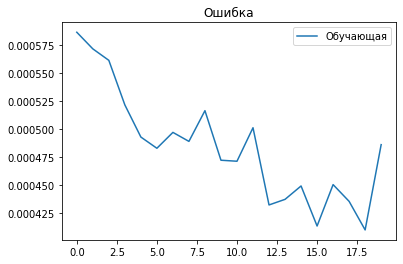

Обучаем модель: EfficientNetB6
Epoch 1/20
80/80 [==============================] - 43s 438ms/step - loss: 5.4272e-04 - mae: 0.0179 - lr: 1.6616e-06
Epoch 2/20
80/80 [==============================] - 35s 434ms/step - loss: 5.2753e-04 - mae: 0.0178 - lr: 1.6616e-06
Epoch 3/20
80/80 [==============================] - 35s 431ms/step - loss: 5.1994e-04 - mae: 0.0176 - lr: 1.6616e-06
Epoch 4/20
80/80 [==============================] - 35s 433ms/step - loss: 4.8289e-04 - mae: 0.0171 - lr: 1.6616e-06
Epoch 5/20
80/80 [==============================] - 35s 433ms/step - loss: 4.5214e-04 - mae: 0.0164 - lr: 1.6616e-06
Epoch 6/20
80/80 [==============================] - 34s 431ms/step - loss: 4.4442e-04 - mae: 0.0163 - lr: 1.6616e-06
Epoch 7/20
80/80 [==============================] - 35s 434ms/step - loss: 4.5780e-04 - mae: 0.0166 - lr: 1.6616e-06
Epoch 8/20
80/80 [==============================] - 34s 431ms/step - loss: 4.4883e-04 - mae: 0.0164 - lr: 1.6616e-06
Epoch 9/20
80/80 [===============

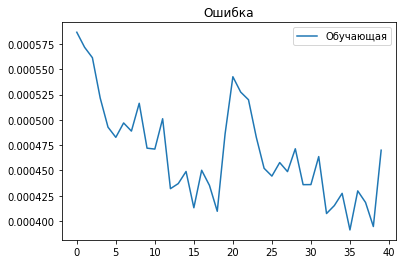

Executed


In [ ]:
hist = [[],[],[],[]]  # запись истории

for i in range(2):
  print('Обучаем модель:', models_name[1])
  seed_everything(42)
  # model.compile(loss='mse',
  #               optimizer=Adam(learning_rate=1e-3),
  #               metrics=['mae'])

  # print('генерируем выборку: ', end='')
  # x_train, y_train = get_dataset(resized_img, dataset_size=500)
  # x_val, y_val = get_dataset(resized_img, dataset_size=200)
  # print('success!')

  store = model.fit(train_img[:], train_xya[:],
                  epochs = 2,
                  batch_size = 10,
                  verbose = 1,
                  # validation_data = (x_val, y_val),
                  # validation_data = (train_img[600:], train_xya[600:]),
                  callbacks=[callback]
                  )
  
  # print('predicted:',model.predict([x1_val, x2_val]))

##############################
# выводим результат предсказания
  p = model.predict(x_test)
  points = np.int32(list(map(get_points,y_test)))
  points_pred = np.int32(list(map(get_points,p)))

  # print(points[0])
  points[:,[2,3]] = points[:,[3,2]]
  points_pred[:,[2,3]] = points_pred[:,[3,2]]
  # tmp_img = resized_img.copy()
  tmp_img = resize_image(resized_img, width=640)
  
  for id in range(10):
    cv2.polylines(tmp_img, np.int32([points[id]]), 1, (0,0,255), thickness=2)
    cv2.circle(tmp_img,(int(y_test[id][0]*tmp_img.shape[1]),int(y_test[id][1]*tmp_img.shape[1])),3,(0,0,255))

    cv2.polylines(tmp_img, np.int32([points_pred[id]]), 1, (255,0,0), thickness=2)
    cv2.circle(tmp_img,(int(p[id][0]*tmp_img.shape[1]),int(p[id][1]*tmp_img.shape[1])),3,(255,0,0))

    pt1 = (int(p[id][0]*tmp_img.shape[1]),int(p[id][1]*tmp_img.shape[1]))
    pt2 = (int(y_test[id][0]*tmp_img.shape[1]),int(y_test[id][1]*tmp_img.shape[1]))
    color = (0, 255, 0)
    thickness=1

    # pt1 = (100, 100)
    # pt2 = (400, 350)

    cv2.line(tmp_img, pt1, pt2,color,thickness)

  # cv2_imshow(resize_image(tmp_img, width=600))
  cv2.imwrite(dir_home+'show_training/'+models_name[i]+'_img_pred.png', tmp_img)

  # del model

  model.save('/content/drive/MyDrive/Aerophoto/weights/3/')
###########################


  # hist[0].extend(store.history['compute_metric_simp'])
  # hist[1].extend(store.history['val_compute_metric_simp'])
  hist[2].extend(store.history['loss'])
  # hist[3].extend(store.history['val_loss'])

  # plt.plot(hist[0], label='Обучающая')
  # plt.plot(hist[1], label='Проверочная')
  # plt.legend()
  # plt.title('Точность')
  # plt.show()
  plt.plot(hist[2], label='Обучающая')
  # plt.plot(hist[3], label='Проверочная')
  plt.legend()
  plt.title('Ошибка')
  plt.show()

try:
  sound()
  print('Executed')
except:
  print('Executed')

# Финальная НС EfB6 с аугментацией

### +Функции

In [51]:
# для создания сети
from tensorflow.keras.models import Sequential, Model

# для создания слоев
from tensorflow.keras.layers import Dense, Conv2D, MaxPooling2D, Flatten, Dropout, BatchNormalization, SpatialDropout2D, RandomRotation
from tensorflow.keras.layers import Input, concatenate, GlobalAveragePooling2D, Softmax, ReLU, GlobalMaxPooling2D
from tensorflow.keras.layers import Resizing, Concatenate, Reshape, AveragePooling2D


# для работы с изображениями
from tensorflow.keras.preprocessing import image

from tensorflow.keras.metrics import binary_accuracy, CategoricalAccuracy 

from tensorflow.keras.losses import BinaryCrossentropy, binary_crossentropy, categorical_crossentropy, CosineSimilarity

# оптимизатор
from tensorflow.keras.optimizers import Adam, SGD

from tensorflow.keras.callbacks import LambdaCallback, EarlyStopping, Callback, LearningRateScheduler, ModelCheckpoint

from tensorflow.keras.applications.resnet_v2 import preprocess_input

# модуль для отсчета времени
import time 
# import datetime

import matplotlib.pyplot as plt

from tensorflow.keras import backend as K

In [52]:
from tensorflow.keras.applications import EfficientNetB6, EfficientNetB7
from tensorflow.keras.applications import resnet_v2, efficientnet, efficientnet_v2, xception, inception_resnet_v2

In [53]:
# !!! повтор выше в бэках и в создании НС!!!
def create_back(base_model, act = "sigmoid", d1 = 256, d2 = 512, d3 = 128):
  back = Dense(d1, activation="relu", name="back1")(base_model)
  # back = Flatten()(back)
  if d2: back = Dense(d2, activation="relu", name="back2")(back)  
  if d3: back = Dense(d3, activation="relu", name="back3")(back)  
  output = (Dense(4, activation=act, name="output")(back))  
  return output

# функции для визуализации результатов предсказания
# преобразует координаты центра и поворот в коордитаты углов LT RT LB RB 
def M(angle):
  # угол от градуса до радиана
  angle = np.radians(angle)
  # матрица преобразования для вращения
  M = np.float32([ [np.cos(angle), -(np.sin(angle)), 0],
                [np.sin(angle), np.cos(angle), 0],
                [0, 0, 1] ])
  return M

def get_points(xya, img_shape=(640,640,3)):
  # переводим из нормализации в cos и sin угла
  point = np.float32([(xya[2]-0.5)*2,(xya[3]-0.5)*2,1])
  # print(point)

  # абсолютные координаты центра
  x_center = int(xya[0]*img_shape[1])
  y_center = int(xya[1]*img_shape[0])

  new_xy = (M(135) @ point) # left top
  x1, y1 = new_xy[0], new_xy[1]

  new_xy = (M(45) @ point) # left top
  x2, y2 = new_xy[0], new_xy[1]

  new_xy = (M(-135) @ point) # left top
  x3, y3 = new_xy[0], new_xy[1]

  new_xy = (M(-45) @ point) # left top
  x4, y4 = new_xy[0], new_xy[1]

  angle = atan2(xya[3],xya[2])

  points = np.array([[x1, y1], [x2, y2], [x3, y3], [x4, y4]])*frag.shape[0]/2/resized_img.shape[0]*img_shape[0]
  # смещение на координаты центра
  points[:,0] += x_center
  points[:,1] += y_center
  # print(x_center)

  return points

In [54]:
def create_model():
  frag_height = 224 # Высота 
  frag_width = 224 # Ширина 

  chanels = 3 # Количество каналов  

  input_frag_shape = (frag_height, frag_width, chanels)  # на этот вход подаем фрагмент  

  input_frag = Input(shape=input_frag_shape)

  # preproc = efficientnet.preprocess_input(input_frag) # не требуется

  base_model = EfficientNetB6(weights="imagenet", pooling='avg', include_top=False)(input_frag)  

  return Model(input_frag, create_back(base_model, act = "linear", d1 = 256, d2 = 512, d3 = 128))

In [55]:
# преобразуем x и y координаты в угол
def xy2ang(xa,ya):
  a_cos, a_sin = (xa-0.5)*2, (ya-0.5)*2
  angle = np.arctan2(a_sin,a_cos)*180/pi
  if angle < 0: angle += 360
  return angle  #угол в градусах

xy2ang(*train_xya[6][2:]), 

(18.000000000000004,)

In [56]:
# !!! повтор выше !!!
def compute_metric_simp(data_true, data_pred, outImageW = org_shape[1], outImageH = org_shape[0]):

  x_center_true = data_true[0]
  y_center_true = data_true[1]

  x_metr = x_center_true - data_pred[0]
  y_metr = y_center_true - data_pred[1] 

  angle_true = xy2ang(data_true[2], data_true[3])
  angle_pred = xy2ang(data_pred[2], data_pred[3])

  # print('x_metr, y_metr:', x_metr, y_metr, '\nangle_true, angle_pred:', angle_true, angle_pred)
  # print()

  metr =  1- (0.7 * 0.5 * (abs(x_metr) + abs(y_metr)) + 0.3 *min(abs(angle_true - angle_pred), abs(abs(angle_true - angle_pred)-360))/360)
  return metr

compute_metric_simp(train_xya[0], train_xya[6])

0.45361248730532266

### +Загружаем готовый трейн

In [66]:
train_img.shape

(800, 224, 224, 3)

In [109]:
# сохраняем массив с тестовыми изображениями
import pickle

train_img_file = '/content/drive/MyDrive/Aerophoto/'+'train_imgs_size_224'

with open(train_img_file, "wb") as fp:   #Pickling
  pickle.dump(train_img, fp)

train_xya_file = '/content/drive/MyDrive/Aerophoto/'+'train_xya'

with open(train_xya_file, "wb") as fp:   #Pickling
  pickle.dump(train_xya, fp)

In [110]:
pred_dump_file = '/content/drive/MyDrive/Aerophoto/'+'train_imgs_size_224'
with open(pred_dump_file, "rb") as fp:   # Unpickling
  train_img = pickle.load(fp)

pred_dump_file = '/content/drive/MyDrive/Aerophoto/'+'train_xya'
with open(pred_dump_file, "rb") as fp:   # Unpickling
  train_xya = pickle.load(fp)

pred_dump_file = '/content/drive/MyDrive/Aerophoto/'+'test_imgs_size_224'
with open(pred_dump_file, "rb") as fp:   # Unpickling
  test_img = np.array(pickle.load(fp))


In [111]:
train_img.shape, train_xya.shape, test_img.shape

((800, 224, 224, 3), (800, 4), (400, 224, 224, 3))

### Ручное создание НС 21.07

In [57]:
frag_height = 224 # Высота 
frag_width = 224 # Ширина 

chanels = 3 # Количество каналов  

input_frag_shape = (frag_height, frag_width, chanels)  # на этот вход подаем фрагмент
input_frag_shape

(224, 224, 3)

In [58]:
input_frag = Input(shape=input_frag_shape)

# preproc = efficientnet.preprocess_input(input_frag) # не требуется

# base_model = EfficientNetB6(weights="imagenet", pooling='avg', include_top=False)(input_frag)
base_model = EfficientNetB6(weights="imagenet", include_top=False)(input_frag)



In [59]:
base_model.trainable = False

In [60]:
# 21.07 добавляем avg и max
x1 = GlobalAveragePooling2D()(base_model)
x2 = GlobalMaxPooling2D()(base_model)
concat = concatenate([x1,x2])

In [ ]:
# for l in base_model.layers :
#   l.trainable = False

In [61]:
def create_back2(base_model, act = ["linear", "sigmoid"], d1 = 1024, d2 = 512):
  back = Dense(d1, activation="elu", name="back1")(base_model)
  # back = Flatten()(back)
  if d2: back = Dense(d2, activation="relu", name="back2")(back)  
  output1 = (Dense(2, activation=act[0], name="output1")(back))  
  output2 = (Dense(2, activation=act[1], name="output2")(back))  
  return [output1,output2]

In [62]:
model = Model(input_frag, create_back2(concat, act = ["linear", "sigmoid"], d1 = 1024, d2 = 0)) # 


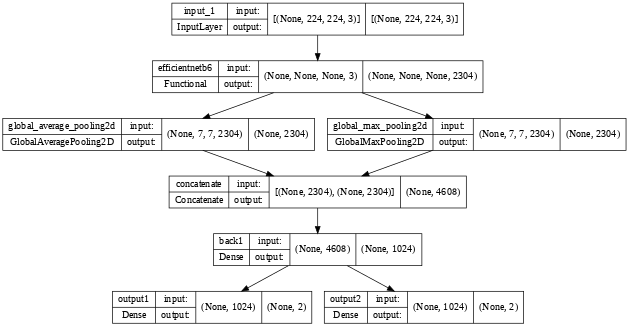

In [70]:
from tensorflow.keras.utils import plot_model
plot_model(model,show_shapes=True,dpi=50, show_layer_names=True)

In [ ]:
# model.load_weights('/content/drive/MyDrive/Aerophoto/weights//') # create_back(base_model, act = "linear", d1 = 256, d2 = 512, d3 = 128) - score 93.4

### Добавление аугментации

In [63]:
from imgaug import augmenters as iaa

In [64]:
seq = iaa.Sequential([
      iaa.Sometimes(
      0.2,
      iaa.Add((-20,20)), # осветляет или затемняет [-50:50]
      iaa.AddToHueAndSaturation((-10,10)), # сдвиг гаммы
  ),

])

### Обучение

In [65]:
def scheduler(epoch, lr):
   if epoch < 9:
     return lr
   else:
     return lr * exp(-0.1)

callback = LearningRateScheduler(scheduler)

In [120]:
checkpoint_filepath = '/content/drive/MyDrive/Aerophoto/checkpoint/aug/'  # переисползую
model_checkpoint_callback = ModelCheckpoint(
    filepath=checkpoint_filepath,
    save_weights_only=True,
    monitor='loss',
    mode='min',
    save_best_only=True)


In [71]:
model.compile(loss='mse',
              optimizer=Adam(learning_rate=1e-3),
              metrics=['mae'])

In [ ]:
# тренировка B6
hist = [[],[],[],[]]  # запись истории

seed_everything(42)
# model = Model(input_frag, create_back(base_model, act = "linear", d1 = 1024, d2 = 512, d3 = 0))
model.compile(loss='mse', # my_loss_fn()
# model.compile(loss=BinaryCrossentropy(from_logits=1),
              optimizer=Adam(learning_rate=1e-3),
              metrics=['mae'])

val_th = 100

for i in range(1):
  print('Цикл',i)
  ###############################
  # выбираем 25% лучших (для валидации) и худших (для тренировки)
  # val_img_looser,val_xya_looser,add_img,add_xya,val_img,val_xya = val_loosers(num_show=10)
  ###############################

  # аугментация перед обучением
  X = seq.augment_images(train_img) # аугментация фрагментов из подложки (совпадают с худшими фрагментами)
  Y = train_xya

  # X = np.concatenate([train_img,aug_train_img])

  # del aug_train_img # освобождаем память

  store = model.fit(X[:val_th], [Y[:val_th,:2],Y[:val_th,2:]],
                  epochs = 10,
                  batch_size = 20,
                  verbose = 1,
                  # validation_data = (val_img, val_xya),
                  validation_data = (train_img[-val_th:], [Y[-val_th:,:2],Y[-val_th:,2:]]),
                  callbacks=[callback]
                  )
  
  # print('смотрим ошибку на 25% looser картинках после обучения',model.evaluate(val_img_looser, val_xya_looser,verbose=0))
  


##############################
  # model.save('/content/drive/MyDrive/Aerophoto/weights/6a/')
###########################

  # hist[0].extend(store.history['compute_metric_simp'])
  # hist[1].extend(store.history['val_compute_metric_simp'])
  hist[2].extend(store.history['loss'])
  hist[3].extend(store.history['val_loss'])

  # plt.plot(hist[0], label='Обучающая')
  # plt.plot(hist[1], label='Проверочная')
  # plt.legend()
  # plt.title('Точность')
  # plt.show()
  plt.plot(hist[2][1:], label='Обучающая')
  plt.plot(hist[3][1:], label='Проверочная')
  plt.legend()
  plt.title('Ошибка')
  plt.show()

try:
  sound()
  print('Executed')
except:
  print('Executed')

Цикл 0
Epoch 1/10
5/5 [==============================] - 205s 33s/step - loss: 8.9603 - output1_loss: 8.7585 - output2_loss: 0.2018 - output1_mae: 2.3105 - output2_mae: 0.3732 - val_loss: 133.0074 - val_output1_loss: 132.7226 - val_output2_loss: 0.2848 - val_output1_mae: 10.8054 - val_output2_mae: 0.4359 - lr: 0.0010
Epoch 2/10
2/5 [===========>..................] - ETA: 1:16 - loss: 4.5170 - output1_loss: 4.3685 - output2_loss: 0.1485 - output1_mae: 1.8758 - output2_mae: 0.3262

## Val выборка где низкий Score + создание фин модели

In [ ]:
model = create_model()  # ~30 сек

In [ ]:
model.load_weights('/content/drive/MyDrive/Aerophoto/weights/5_b6/') # create_back(base_model, act = "linear", d1 = 256, d2 = 512, d3 = 128) - score 93.2
# model.load_weights('/content/drive/MyDrive/Aerophoto/checkpoint/') # create_back(base_model, act = "linear", d1 = 256, d2 = 512, d3 = 128) - score 93.4

In [ ]:
# model.save_weights('/content/drive/MyDrive/Aerophoto/weights/5_b6_convert/w.h5')

**проверка на тренировочных данных**

In [ ]:
p = model.predict(train_img[:]) # ~4мин

In [ ]:
data = list(zip(train_xya[:],p))

In [ ]:
# дообучение на "плохих" данных без аугментации
score = np.array([compute_metric_simp(d[0], d[1]) for d in data])
np.mean(score)

0.9866404405522288

In [ ]:
# EfB6 test Score = 0.932
score = np.array([compute_metric_simp(d[0], d[1]) for d in data])
np.mean(score)

0.9865183904524085

In [ ]:
# EfB6 Score = 0.934
# score = np.array([compute_metric_simp(d[0], d[1]) for d in data])
# np.mean(score)

0.9862032776521644

In [ ]:
np.median(score), np.quantile(score,0.25), np.quantile(score,0.75)

(0.9876213757132472, 0.9830335934909002, 0.9918916459960041)

In [ ]:
len(score[score<0.9912347636523339])

400

#### Аугментация

In [ ]:
# аугментация
!pip install imgaug

In [ ]:
from imgaug import augmenters as iaa

In [77]:
##############################################
z_img = np.zeros((224,4,3))
##############################################

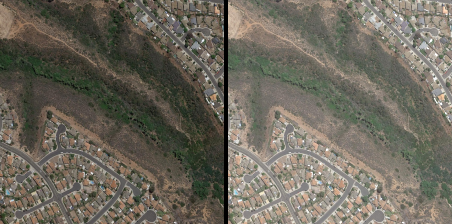

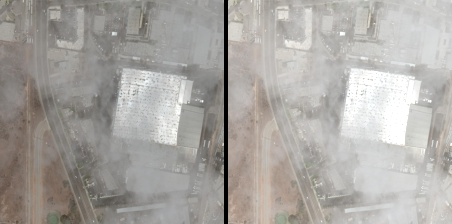

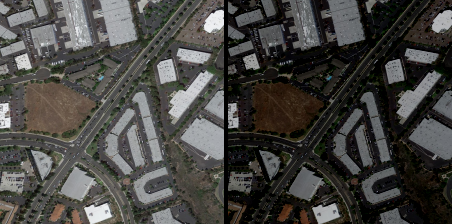

In [118]:
#imgaug test
seq = iaa.Sequential([
      iaa.Sometimes(
      0.5,
      iaa.Add((-100,100)), # осветляет или затемняет [-50:50]
      # iaa.AddToHueAndSaturation((-10,10)), # сдвиг гаммы
  ),

      # iaa.Add((-20,20)), # осветляет или затемняет [-50:50],per_channel=1
      # iaa.Add((-100,100),per_channel=1), # осветляет или затемняет [-50:50]
      # iaa.AddToHueAndSaturation((-10,10)), # сдвиг гаммы
      # iaa.CoarseDropout(p=0.1,per_channel=1,size_percent=(0.01,0.1)),  # цветные квадратики
      # iaa.Clouds(random_state=42),

])
 
im_id = 4

images_aug = seq.augment_images(train_img[im_id:im_id+3])

cv2_imshow(np.hstack([train_img[im_id],z_img, images_aug[0]]))
cv2_imshow(np.hstack([train_img[im_id+1],z_img, images_aug[1]]))
cv2_imshow(np.hstack([train_img[im_id+2],z_img, images_aug[2]]))


In [ ]:
images_aug.shape, train_img[10].shape

((3, 224, 224, 3), (224, 224, 3))

In [ ]:
train_img.shape

(800, 224, 224, 3)

### Score фильтр

средний score 0.9865183904524085 порог 0.9830335934909002

score 0.9967562060113216
val Фрагмент для валидации id = 0


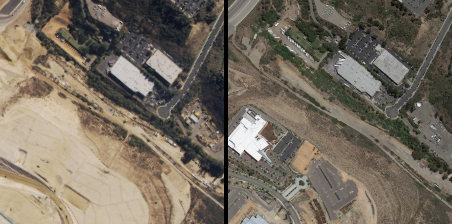

score 0.9881928436962709
Фрагмент убираем из базы id = 1
score 0.9867104193274269
Фрагмент убираем из базы id = 2
score 0.9936027036236224
val Фрагмент для валидации id = 3


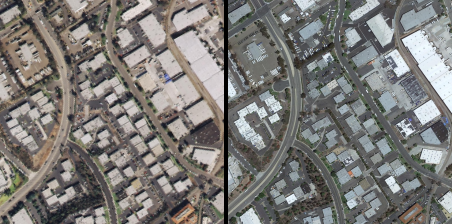

score 0.9850244687892084
Фрагмент убираем из базы id = 4
score 0.9890639695911759
Фрагмент убираем из базы id = 5
score 0.9786902141991551
trn Фрагмент для дообучения id = 6


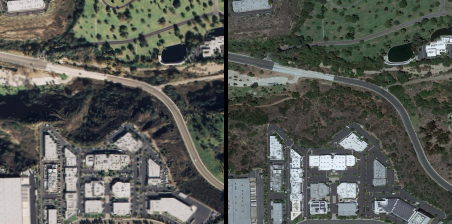

score 0.9910902306866985
Фрагмент убираем из базы id = 7
score 0.9975606709360787
val Фрагмент для валидации id = 8


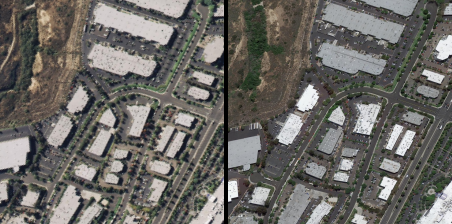

score 0.9907530457727278
Фрагмент убираем из базы id = 9
score 0.9588753572493013
trn Фрагмент для дообучения id = 10


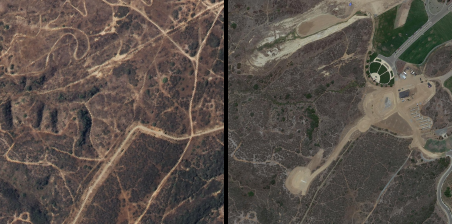

score 0.9869269973131055
Фрагмент убираем из базы id = 11
score 0.9905855773331691
Фрагмент убираем из базы id = 12
score 0.9821070975057278
trn Фрагмент для дообучения id = 13


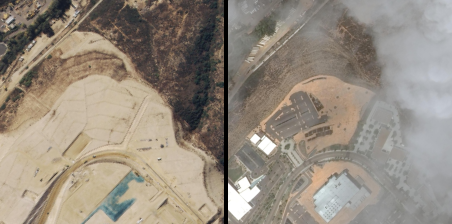

score 0.9797837158728702
trn Фрагмент для дообучения id = 14


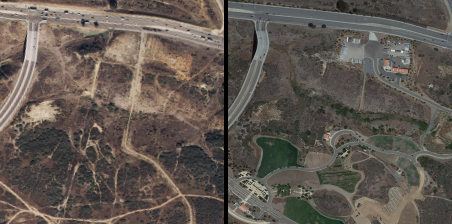

score 0.9980687686500492
val Фрагмент для валидации id = 15


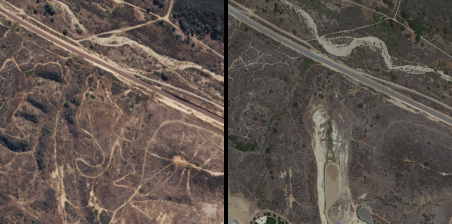

score 0.9922496535585306
val Фрагмент для валидации id = 16


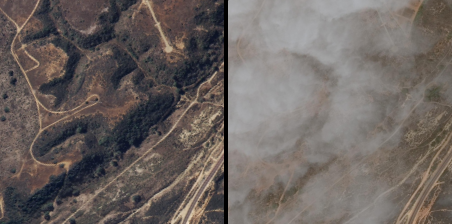

score 0.9633384051521201
trn Фрагмент для дообучения id = 17


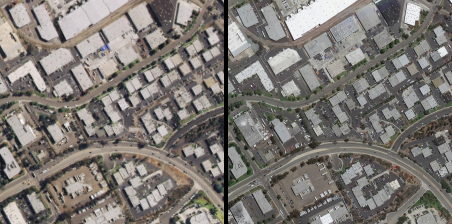

score 0.9842834199799835
Фрагмент убираем из базы id = 18
score 0.985048796880664
Фрагмент убираем из базы id = 19
score 0.9568553361506834
trn Фрагмент для дообучения id = 20


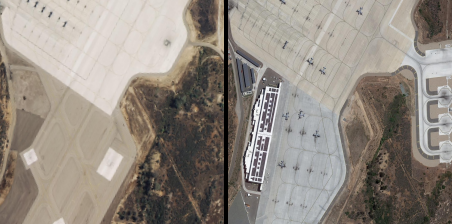

score 0.9862555562617578
Фрагмент убираем из базы id = 21
score 0.9620586183977303
trn Фрагмент для дообучения id = 22


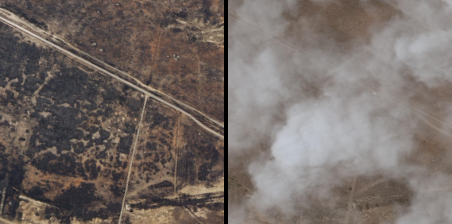

score 0.9842206997512009
Фрагмент убираем из базы id = 23
score 0.9908397279991784
Фрагмент убираем из базы id = 24
score 0.9830002740554347
trn Фрагмент для дообучения id = 25


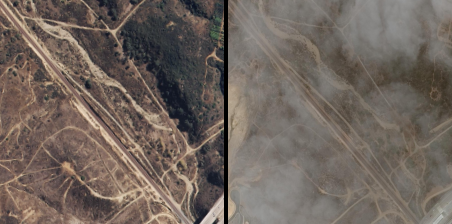

score 0.9802330705120361
trn Фрагмент для дообучения id = 26


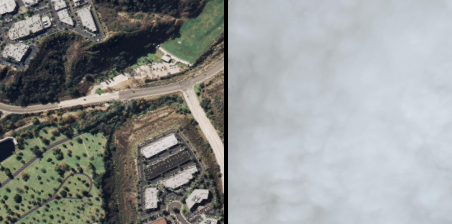

score 0.9966549117873961
val Фрагмент для валидации id = 27


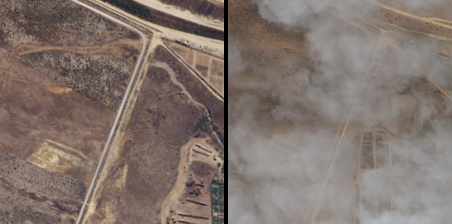

score 0.9946171868634649
val Фрагмент для валидации id = 28


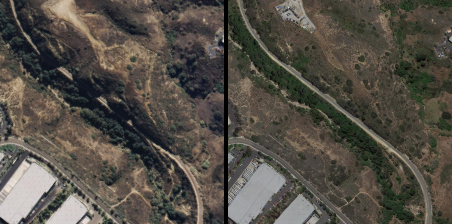

score 0.9946981063331738
val Фрагмент для валидации id = 29


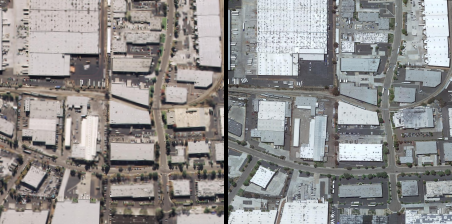

score 0.9961606520201143
val Фрагмент для валидации id = 30


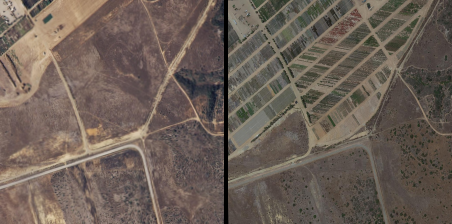

score 0.9967219262917327
val Фрагмент для валидации id = 31


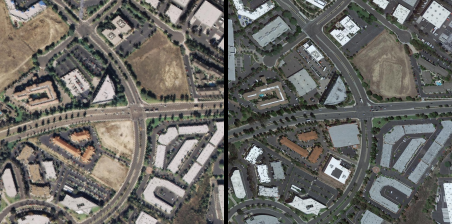

score 0.9977020210202074
val Фрагмент для валидации id = 32


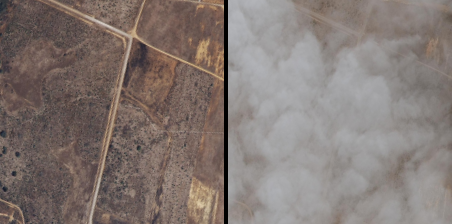

score 0.986233070901862
Фрагмент убираем из базы id = 33
score 0.9943602309302777
val Фрагмент для валидации id = 34


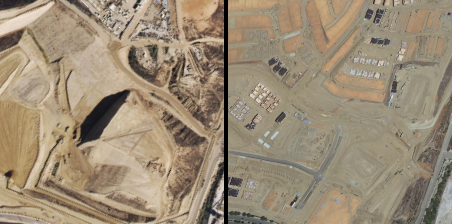

score 0.9839355046398264
Фрагмент убираем из базы id = 35
score 0.9912424234119864
Фрагмент убираем из базы id = 36
score 0.9961668278411316
val Фрагмент для валидации id = 37


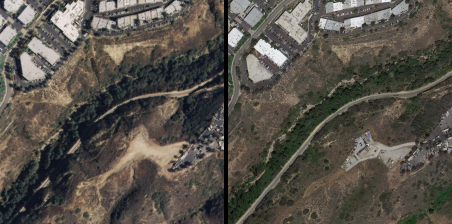

score 0.9896826361099585
Фрагмент убираем из базы id = 38
score 0.9789797799585641
trn Фрагмент для дообучения id = 39


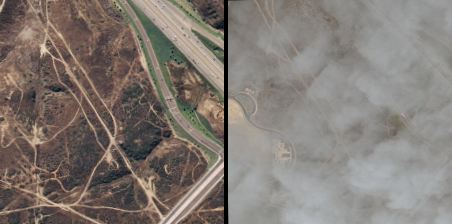

((200, 224, 224, 3), (200, 224, 224, 3), (200, 224, 224, 3))

In [ ]:
'''
алгоритм:
1. выбираем 25% худших результатов -> добавляем в val 25% лучших для контроля
2. расширяем подложкой (опционально)
3. дообучаем
4. считаем score и повторяем
'''

num = len(train_img)
# p = model.predict(train_img[:num])
data_tmp = list(zip(train_xya[:num],p))
score = np.array([compute_metric_simp(d[0], d[1]) for d in data_tmp])
threshold = np.quantile(score,0.25)
threshold_val = np.quantile(score,0.75)

print('средний score',np.mean(score), 'порог', threshold)
print()

val_img, val_xya = [], [] # для валидации лучшие
val_img_looser, val_xya_looser = [], [] # для валидации худшие

add_img, add_xya = [], [] # для расширения базы из подложки

for i in range(len(train_img[:num])):
  # p_img = model.predict(train_img[i:i+1])
  if i<40:
    print('score', score[i])
  # cv2_imshow(train_img[i])
  # вырезаем фрагмент по координатам центра и значению угла
  x, y, xa, ya = train_xya[i]
  x = round(x * resized_img.shape[1])
  y = round(y * resized_img.shape[0])
  ang = train_ang[i]  
  fragment = subimage(image=resized_img, center=(x, y), theta=ang, width=224, height=224)
  # cv2_imshow(train_frag)

  if score[i] < threshold:
    if i<40:
      print('trn Фрагмент для дообучения id =', i)
      cv2_imshow(np.hstack([fragment,z_img, train_img[i]]))
    val_img_looser.append(train_img[i])
    val_xya_looser.append(train_xya[i])

    add_img.append(train_img[i])
    add_xya.append(train_xya[i])

    # cv2_imshow(np.hstack([make_sobel(fragment),z_img[:,:,0], make_sobel(train_img[i])]))
  elif score[i] > threshold_val:
    if i<40:
      print('val Фрагмент для валидации id =', i)
      cv2_imshow(np.hstack([fragment,z_img, train_img[i]]))
    val_img.append(train_img[i])
    val_xya.append(train_xya[i])
    # cv2_imshow(np.hstack([make_sobel(fragment),z_img[:,:,0], make_sobel(train_img[i])]))
  else:
    if i<40:
      print('Фрагмент убираем из базы id =', i)

val_img = np.array(val_img)
val_xya = np.array(val_xya)

val_img_looser = np.array(val_img_looser)
val_xya_looser = np.array(val_xya_looser)
add_img = np.array(add_img)
add_xya = np.array(add_xya)

val_img.shape, val_img_looser.shape, add_img.shape

средний score 0.9882867994261855 порог 0.9849169130080047

score 0.9986134562550112
val Фрагмент для валидации id = 0


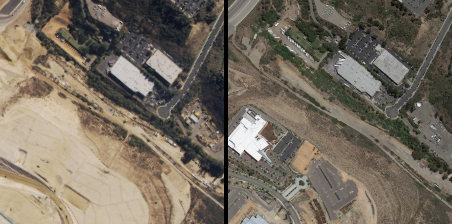

score 0.978428079550116
trn Фрагмент для дообучения id = 1


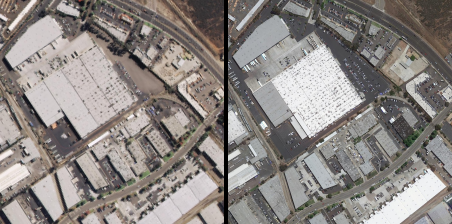

score 0.990450272121713
Фрагмент убираем из базы id = 2
score 0.9947657488436601
val Фрагмент для валидации id = 3


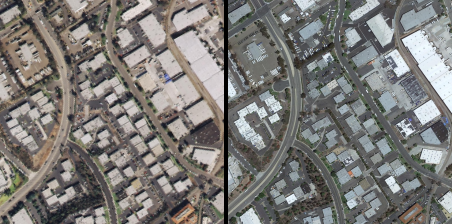

score 0.9854536196991788
Фрагмент убираем из базы id = 4
score 0.983976426973408
trn Фрагмент для дообучения id = 5


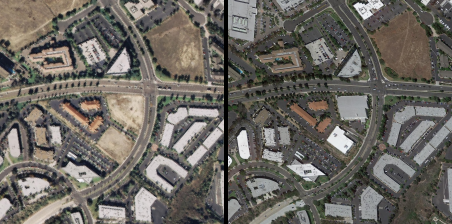

score 0.9811087225306597
trn Фрагмент для дообучения id = 6


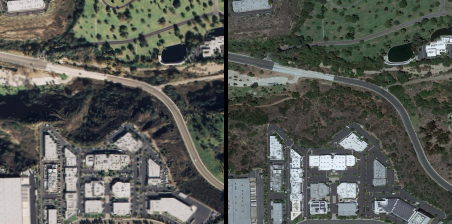

score 0.9904114270577952
Фрагмент убираем из базы id = 7
score 0.990408199511664
Фрагмент убираем из базы id = 8
score 0.99330728267496
val Фрагмент для валидации id = 9


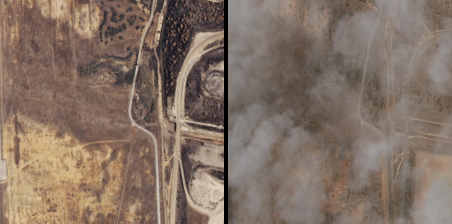

((200, 224, 224, 3), (200, 224, 224, 3), (200, 224, 224, 3))

In [ ]:
def val_loosers(th=0.25, num_show=40):
  num = len(train_img)
  # p = model.predict(train_img[:num])
  data_tmp = list(zip(train_xya[:num],p))
  score = np.array([compute_metric_simp(d[0], d[1]) for d in data_tmp])
  threshold = np.quantile(score,0.25)
  threshold_val = np.quantile(score,0.75)

  print('средний score',np.mean(score), 'порог', threshold)
  print()


  val_img, val_xya = [], [] # для валидации лучшие
  val_img_looser, val_xya_looser = [], [] # для валидации худшие

  add_img, add_xya = [], [] # для расширения базы из подложки

  for i in range(len(train_img[:num])):
    # p_img = model.predict(train_img[i:i+1])
    if i<num_show:
      print('score', score[i])
    # cv2_imshow(train_img[i])
    # вырезаем фрагмент по координатам центра и значению угла
    x, y, xa, ya = train_xya[i]
    x = round(x * resized_img.shape[1])
    y = round(y * resized_img.shape[0])
    ang = train_ang[i]  
    fragment = subimage(image=resized_img, center=(x, y), theta=ang, width=224, height=224)
    # cv2_imshow(train_frag)

    if score[i] < threshold:
      if i<num_show:
        print('trn Фрагмент для дообучения id =', i)
        cv2_imshow(np.hstack([fragment,z_img, train_img[i]]))
      val_img_looser.append(train_img[i])
      val_xya_looser.append(train_xya[i])

      add_img.append(train_img[i])
      add_xya.append(train_xya[i])

      # cv2_imshow(np.hstack([make_sobel(fragment),z_img[:,:,0], make_sobel(train_img[i])]))
    elif score[i] > threshold_val:
      if i<num_show:
        print('val Фрагмент для валидации id =', i)
        cv2_imshow(np.hstack([fragment,z_img, train_img[i]]))
      val_img.append(train_img[i])
      val_xya.append(train_xya[i])
      # cv2_imshow(np.hstack([make_sobel(fragment),z_img[:,:,0], make_sobel(train_img[i])]))
    else:
      if i<num_show:
        print('Фрагмент убираем из базы id =', i)

  return np.array(val_img_looser), np.array(val_xya_looser), np.array(add_img),np.array(add_xya),np.array(val_img), np.array(val_xya)

val_img_looser,val_xya_looser,add_img,add_xya, val_img, val_xya = val_loosers(num_show=10)

val_img.shape, val_img_looser.shape, add_img.shape

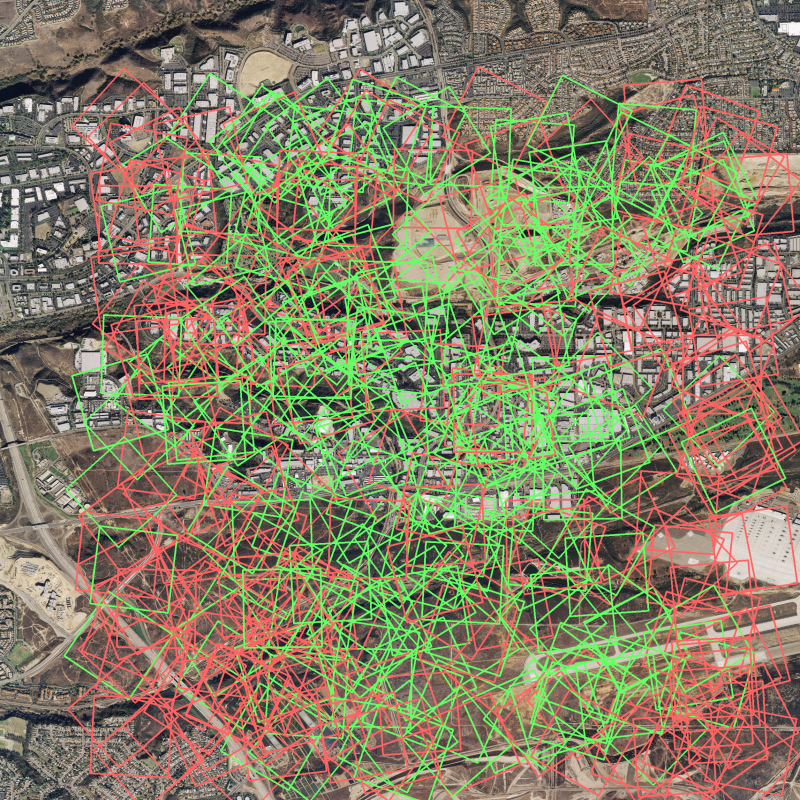

In [ ]:
# выводим, где низкий, а где высокий score
tmp_img = resized_img.copy()
threshold = np.quantile(score,0.25)
threshold_val = np.quantile(score,0.75)

for i,f_json in enumerate(train_json_lst[:]):
  json_data = get_json(file_json=dir_json+f_json)
  coord_lst = []
  # print(f_json, json_data)
  for instance in json_data:
    # print(instance, json_data[instance])
    coord_lst.append(json_data[instance]) # массив, чтобы удобно конвертировать в др размеры
  coord_lst = np.array(coord_lst[:-1])
  # получаем координаты для отображения полигона на resized_img
  points = np.array(list(map(new_xy,coord_lst)))
  # print(coord_lst, points)
  points[[2,3]] = points[[3,2]]
  if score[i] < threshold:
    tmp_img = cv2.polylines(tmp_img, np.int32([points*resized_img.shape[0]]), 1, (100,100,255),3)
  if score[i] > threshold_val:
    tmp_img = cv2.polylines(tmp_img, np.int32([points*resized_img.shape[0]]), 1, (100,255,100),3)
  # if threshold_val > score[i] > threshold:
  #   tmp_img = cv2.polylines(tmp_img, np.int32([points*resized_img.shape[0]]), 1, (255,255,255),3)

  # координаты центра
  xy_center = (np.max(points, axis=0) + np.min(points, axis=0))/2

cv2_imshow(resize_image(tmp_img, width=800))

In [ ]:
model.evaluate(train_img[:10], train_xya[:10])

1/1 [==============================] - 9s 9s/step - loss: 5.7662e-04 - mae: 0.0176


[0.0005766249960288405, 0.017588060349225998]

### Подбираем полносвязные слои и активатор

Обучаем с параметрами: [1024, 512, 0]
Epoch 1/10
20/20 [==============================] - 31s 462ms/step - loss: 0.0609 - mae: 0.1883
Epoch 2/10
20/20 [==============================] - 10s 504ms/step - loss: 0.0247 - mae: 0.1193
Epoch 3/10
20/20 [==============================] - 9s 473ms/step - loss: 0.0199 - mae: 0.1085
Epoch 4/10
20/20 [==============================] - 9s 467ms/step - loss: 0.0143 - mae: 0.0945
Epoch 5/10
20/20 [==============================] - 9s 451ms/step - loss: 0.0140 - mae: 0.0926
Epoch 6/10
20/20 [==============================] - 9s 445ms/step - loss: 0.0121 - mae: 0.0861
Epoch 7/10
20/20 [==============================] - 9s 452ms/step - loss: 0.0111 - mae: 0.0805
Epoch 8/10
20/20 [==============================] - 9s 445ms/step - loss: 0.0098 - mae: 0.0772
Epoch 9/10
20/20 [==============================] - 9s 452ms/step - loss: 0.0091 - mae: 0.0736
Epoch 10/10
20/20 [==============================] - 9s 452ms/step - loss: 0.0096 - mae: 0.0774


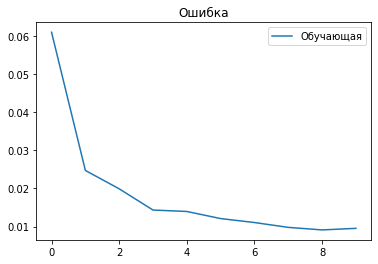

Обучаем с параметрами: [256, 512, 128]
Epoch 1/10
20/20 [==============================] - 30s 450ms/step - loss: 0.0851 - mae: 0.2098
Epoch 2/10
20/20 [==============================] - 9s 461ms/step - loss: 0.0230 - mae: 0.1160
Epoch 3/10
20/20 [==============================] - 9s 465ms/step - loss: 0.0169 - mae: 0.1026
Epoch 4/10
20/20 [==============================] - 9s 460ms/step - loss: 0.0120 - mae: 0.0854
Epoch 5/10
20/20 [==============================] - 9s 453ms/step - loss: 0.0123 - mae: 0.0868
Epoch 6/10
20/20 [==============================] - 9s 457ms/step - loss: 0.0099 - mae: 0.0792
Epoch 7/10
20/20 [==============================] - 9s 473ms/step - loss: 0.0103 - mae: 0.0794
Epoch 8/10
20/20 [==============================] - 9s 459ms/step - loss: 0.0103 - mae: 0.0787
Epoch 9/10
20/20 [==============================] - 9s 454ms/step - loss: 0.0101 - mae: 0.0776
Epoch 10/10
20/20 [==============================] - 9s 450ms/step - loss: 0.0118 - mae: 0.0850


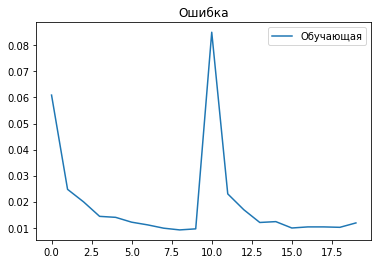

Обучаем с параметрами: [256, 512, 0]
Epoch 1/10
20/20 [==============================] - 30s 445ms/step - loss: 0.0685 - mae: 0.1902
Epoch 2/10
20/20 [==============================] - 9s 453ms/step - loss: 0.0229 - mae: 0.1156
Epoch 3/10
20/20 [==============================] - 9s 460ms/step - loss: 0.0152 - mae: 0.0944
Epoch 4/10
20/20 [==============================] - 9s 453ms/step - loss: 0.0121 - mae: 0.0845
Epoch 5/10
20/20 [==============================] - 9s 452ms/step - loss: 0.0118 - mae: 0.0856
Epoch 6/10
20/20 [==============================] - 9s 449ms/step - loss: 0.0099 - mae: 0.0770
Epoch 7/10
20/20 [==============================] - 9s 442ms/step - loss: 0.0113 - mae: 0.0838
Epoch 8/10
20/20 [==============================] - 9s 450ms/step - loss: 0.0093 - mae: 0.0774
Epoch 9/10
20/20 [==============================] - 9s 447ms/step - loss: 0.0082 - mae: 0.0703
Epoch 10/10
20/20 [==============================] - 9s 446ms/step - loss: 0.0098 - mae: 0.0788


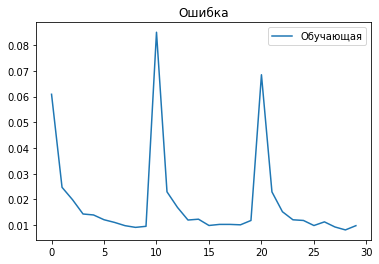

Обучаем с параметрами: [32, 0, 0]
Epoch 1/10
20/20 [==============================] - 31s 443ms/step - loss: 0.0991 - mae: 0.2357
Epoch 2/10
20/20 [==============================] - 9s 451ms/step - loss: 0.0206 - mae: 0.1128
Epoch 3/10
20/20 [==============================] - 9s 457ms/step - loss: 0.0126 - mae: 0.0883
Epoch 4/10
20/20 [==============================] - 9s 456ms/step - loss: 0.0103 - mae: 0.0796
Epoch 5/10
20/20 [==============================] - 9s 449ms/step - loss: 0.0099 - mae: 0.0796
Epoch 6/10
20/20 [==============================] - 9s 445ms/step - loss: 0.0086 - mae: 0.0737
Epoch 7/10
20/20 [==============================] - 9s 442ms/step - loss: 0.0082 - mae: 0.0716
Epoch 8/10
20/20 [==============================] - 9s 440ms/step - loss: 0.0092 - mae: 0.0742
Epoch 9/10
20/20 [==============================] - 9s 440ms/step - loss: 0.0062 - mae: 0.0621
Epoch 10/10
20/20 [==============================] - 9s 443ms/step - loss: 0.0071 - mae: 0.0670


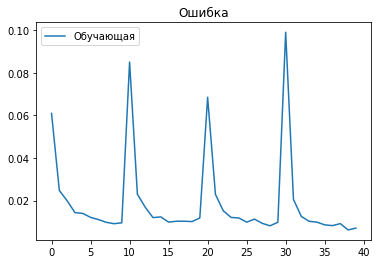

Executed


In [ ]:
hist = [[],[],[],[]]  # запись истории

for i in range(len(config)//3):
  print('Обучаем с параметрами:', config[i*3:i*3+3]) 
  seed_everything(42)
  model = Model(input_frag, create_back(base_model, act = "linear", d1 = config[i*3], d2 = config[i*3+1], d3 = config[i*3+2]))
  model.compile(loss='mse',
                optimizer=Adam(learning_rate=1e-3),
                metrics=['mae'])

  # print('генерируем выборку: ', end='')
  # x_train, y_train = get_dataset(resized_img, dataset_size=500)
  # x_val, y_val = get_dataset(resized_img, dataset_size=200)
  # print('success!')

  store = model.fit(train_img[:200], train_xya[:200],
                  epochs = 10,
                  batch_size = 10,
                  verbose = 1,
                  # validation_data = (x_val, y_val),
                  # validation_data = (train_img[600:], train_xya[600:]),
                  # callbacks=[callback]
                  )
  

  # hist[0].extend(store.history['compute_metric_simp'])
  # hist[1].extend(store.history['val_compute_metric_simp'])
  hist[2].extend(store.history['loss'])
  # hist[3].extend(store.history['val_loss'])

  # plt.plot(hist[0], label='Обучающая')
  # plt.plot(hist[1], label='Проверочная')
  # plt.legend()
  # plt.title('Точность')
  # plt.show()
  plt.plot(hist[2], label='Обучающая')
  # plt.plot(hist[3], label='Проверочная')
  plt.legend()
  plt.title('Ошибка')
  plt.show()

try:
  sound()
  print('Executed')
except:
  print('Executed')

**Подбираем активатор**

In [ ]:
act_conf = ['linear', 'sigmoid']

Обучаем с параметрами: linear seed 2
Epoch 1/10
20/20 [==============================] - 30s 451ms/step - loss: 0.0515 - mae: 0.1646
Epoch 2/10
20/20 [==============================] - 9s 459ms/step - loss: 0.0208 - mae: 0.1130
Epoch 3/10
20/20 [==============================] - 9s 459ms/step - loss: 0.0137 - mae: 0.0933
Epoch 4/10
20/20 [==============================] - 9s 451ms/step - loss: 0.0156 - mae: 0.0969
Epoch 5/10
20/20 [==============================] - 9s 454ms/step - loss: 0.0139 - mae: 0.0885
Epoch 6/10
20/20 [==============================] - 9s 444ms/step - loss: 0.0100 - mae: 0.0786
Epoch 7/10
20/20 [==============================] - 9s 440ms/step - loss: 0.0100 - mae: 0.0785
Epoch 8/10
20/20 [==============================] - 9s 448ms/step - loss: 0.0092 - mae: 0.0758
Epoch 9/10
20/20 [==============================] - 9s 446ms/step - loss: 0.0096 - mae: 0.0774
Epoch 10/10
20/20 [==============================] - 9s 455ms/step - loss: 0.0093 - mae: 0.0754


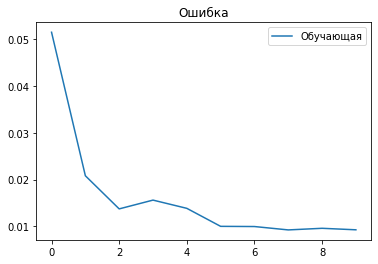

Обучаем с параметрами: sigmoid seed 2
Epoch 1/10
20/20 [==============================] - 33s 450ms/step - loss: 0.0338 - mae: 0.1431
Epoch 2/10
20/20 [==============================] - 9s 463ms/step - loss: 0.0176 - mae: 0.1003
Epoch 3/10
20/20 [==============================] - 9s 460ms/step - loss: 0.0117 - mae: 0.0823
Epoch 4/10
20/20 [==============================] - 9s 452ms/step - loss: 0.0114 - mae: 0.0792
Epoch 5/10
20/20 [==============================] - 9s 447ms/step - loss: 0.0090 - mae: 0.0722
Epoch 6/10
20/20 [==============================] - 9s 449ms/step - loss: 0.0076 - mae: 0.0654
Epoch 7/10
20/20 [==============================] - 9s 445ms/step - loss: 0.0074 - mae: 0.0630
Epoch 8/10
20/20 [==============================] - 9s 445ms/step - loss: 0.0070 - mae: 0.0641
Epoch 9/10
20/20 [==============================] - 9s 447ms/step - loss: 0.0067 - mae: 0.0623
Epoch 10/10
20/20 [==============================] - 9s 452ms/step - loss: 0.0057 - mae: 0.0572


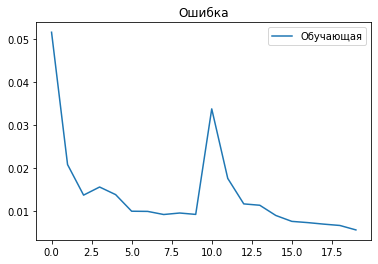

Обучаем с параметрами: linear seed 12
Epoch 1/10
20/20 [==============================] - 30s 455ms/step - loss: 0.0642 - mae: 0.1834
Epoch 2/10
20/20 [==============================] - 9s 462ms/step - loss: 0.0243 - mae: 0.1210
Epoch 3/10
20/20 [==============================] - 9s 459ms/step - loss: 0.0151 - mae: 0.0946
Epoch 4/10
20/20 [==============================] - 9s 454ms/step - loss: 0.0105 - mae: 0.0812
Epoch 5/10
20/20 [==============================] - 9s 447ms/step - loss: 0.0080 - mae: 0.0697
Epoch 6/10
20/20 [==============================] - 9s 448ms/step - loss: 0.0068 - mae: 0.0664
Epoch 7/10
20/20 [==============================] - 9s 447ms/step - loss: 0.0063 - mae: 0.0616
Epoch 8/10
20/20 [==============================] - 9s 443ms/step - loss: 0.0048 - mae: 0.0551
Epoch 9/10
20/20 [==============================] - 9s 448ms/step - loss: 0.0056 - mae: 0.0570
Epoch 10/10
20/20 [==============================] - 9s 453ms/step - loss: 0.0053 - mae: 0.0575


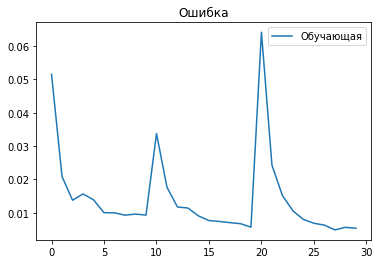

Обучаем с параметрами: sigmoid seed 12
Epoch 1/10
20/20 [==============================] - 30s 442ms/step - loss: 0.0289 - mae: 0.1285
Epoch 2/10
20/20 [==============================] - 9s 451ms/step - loss: 0.0145 - mae: 0.0908
Epoch 3/10
20/20 [==============================] - 9s 458ms/step - loss: 0.0081 - mae: 0.0692
Epoch 4/10
20/20 [==============================] - 9s 458ms/step - loss: 0.0069 - mae: 0.0636
Epoch 5/10
20/20 [==============================] - 9s 448ms/step - loss: 0.0053 - mae: 0.0570
Epoch 6/10
20/20 [==============================] - 9s 444ms/step - loss: 0.0054 - mae: 0.0565
Epoch 7/10
20/20 [==============================] - 9s 445ms/step - loss: 0.0054 - mae: 0.0572
Epoch 8/10
20/20 [==============================] - 9s 449ms/step - loss: 0.0048 - mae: 0.0526
Epoch 9/10
20/20 [==============================] - 9s 442ms/step - loss: 0.0045 - mae: 0.0512
Epoch 10/10
20/20 [==============================] - 9s 446ms/step - loss: 0.0054 - mae: 0.0562


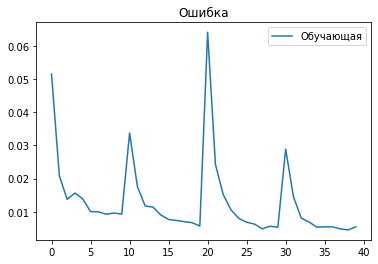

Обучаем с параметрами: linear seed 22
Epoch 1/10
20/20 [==============================] - 31s 446ms/step - loss: 0.0586 - mae: 0.1786
Epoch 2/10
20/20 [==============================] - 9s 452ms/step - loss: 0.0151 - mae: 0.0964
Epoch 3/10
20/20 [==============================] - 9s 458ms/step - loss: 0.0105 - mae: 0.0819
Epoch 4/10
20/20 [==============================] - 9s 456ms/step - loss: 0.0086 - mae: 0.0736
Epoch 5/10
20/20 [==============================] - 9s 448ms/step - loss: 0.0074 - mae: 0.0675
Epoch 6/10
20/20 [==============================] - 9s 446ms/step - loss: 0.0071 - mae: 0.0667
Epoch 7/10
20/20 [==============================] - 9s 445ms/step - loss: 0.0053 - mae: 0.0566
Epoch 8/10
20/20 [==============================] - 9s 443ms/step - loss: 0.0054 - mae: 0.0575
Epoch 9/10
20/20 [==============================] - 9s 444ms/step - loss: 0.0044 - mae: 0.0526
Epoch 10/10
20/20 [==============================] - 9s 446ms/step - loss: 0.0045 - mae: 0.0530


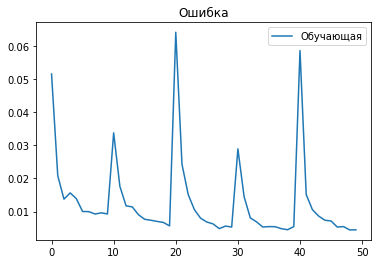

Обучаем с параметрами: sigmoid seed 22
Epoch 1/10
20/20 [==============================] - 32s 448ms/step - loss: 0.0309 - mae: 0.1330
Epoch 2/10
20/20 [==============================] - 9s 453ms/step - loss: 0.0100 - mae: 0.0759
Epoch 3/10
20/20 [==============================] - 9s 460ms/step - loss: 0.0075 - mae: 0.0664
Epoch 4/10
20/20 [==============================] - 9s 456ms/step - loss: 0.0059 - mae: 0.0591
Epoch 5/10
20/20 [==============================] - 9s 456ms/step - loss: 0.0053 - mae: 0.0553
Epoch 6/10
20/20 [==============================] - 9s 447ms/step - loss: 0.0050 - mae: 0.0555
Epoch 7/10
20/20 [==============================] - 9s 444ms/step - loss: 0.0056 - mae: 0.0566
Epoch 8/10
20/20 [==============================] - 9s 447ms/step - loss: 0.0046 - mae: 0.0509
Epoch 9/10
20/20 [==============================] - 9s 446ms/step - loss: 0.0037 - mae: 0.0470
Epoch 10/10
20/20 [==============================] - 9s 446ms/step - loss: 0.0047 - mae: 0.0519


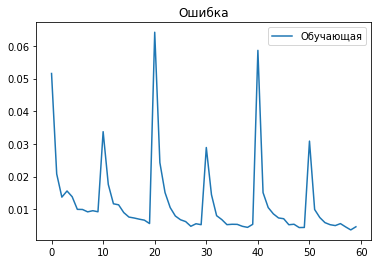

Обучаем с параметрами: linear seed 32
Epoch 1/10
20/20 [==============================] - 29s 447ms/step - loss: 0.0659 - mae: 0.1838
Epoch 2/10
20/20 [==============================] - 9s 454ms/step - loss: 0.0217 - mae: 0.1124
Epoch 3/10
20/20 [==============================] - 9s 456ms/step - loss: 0.0084 - mae: 0.0710
Epoch 4/10
20/20 [==============================] - 9s 449ms/step - loss: 0.0087 - mae: 0.0709
Epoch 5/10
20/20 [==============================] - 9s 448ms/step - loss: 0.0062 - mae: 0.0604
Epoch 6/10
20/20 [==============================] - 9s 441ms/step - loss: 0.0057 - mae: 0.0583
Epoch 7/10
20/20 [==============================] - 9s 440ms/step - loss: 0.0048 - mae: 0.0531
Epoch 8/10
20/20 [==============================] - 9s 441ms/step - loss: 0.0041 - mae: 0.0497
Epoch 9/10
20/20 [==============================] - 9s 443ms/step - loss: 0.0043 - mae: 0.0506
Epoch 10/10
20/20 [==============================] - 9s 445ms/step - loss: 0.0032 - mae: 0.0445


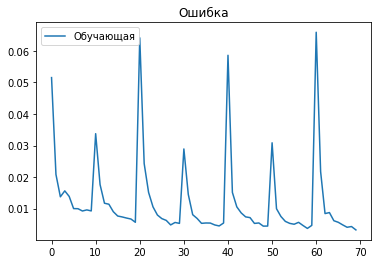

Обучаем с параметрами: sigmoid seed 32
Epoch 1/10
20/20 [==============================] - 30s 451ms/step - loss: 0.0283 - mae: 0.1283
Epoch 2/10
20/20 [==============================] - 9s 459ms/step - loss: 0.0103 - mae: 0.0751
Epoch 3/10
20/20 [==============================] - 9s 460ms/step - loss: 0.0076 - mae: 0.0674
Epoch 4/10
20/20 [==============================] - 9s 459ms/step - loss: 0.0056 - mae: 0.0579
Epoch 5/10
20/20 [==============================] - 9s 453ms/step - loss: 0.0042 - mae: 0.0496
Epoch 6/10
20/20 [==============================] - 9s 448ms/step - loss: 0.0038 - mae: 0.0469
Epoch 7/10
20/20 [==============================] - 9s 448ms/step - loss: 0.0039 - mae: 0.0476
Epoch 8/10
20/20 [==============================] - 9s 447ms/step - loss: 0.0034 - mae: 0.0443
Epoch 9/10
20/20 [==============================] - 9s 447ms/step - loss: 0.0040 - mae: 0.0481
Epoch 10/10
20/20 [==============================] - 9s 448ms/step - loss: 0.0039 - mae: 0.0482


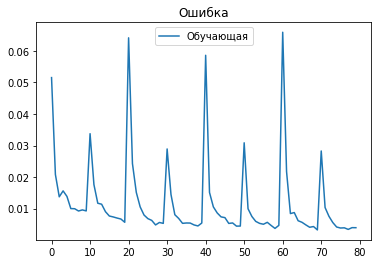

Обучаем с параметрами: linear seed 42
Epoch 1/10
20/20 [==============================] - 31s 452ms/step - loss: 0.0727 - mae: 0.1942
Epoch 2/10
20/20 [==============================] - 9s 459ms/step - loss: 0.0181 - mae: 0.1012
Epoch 3/10
20/20 [==============================] - 9s 461ms/step - loss: 0.0098 - mae: 0.0756
Epoch 4/10
20/20 [==============================] - 9s 457ms/step - loss: 0.0063 - mae: 0.0610
Epoch 5/10
20/20 [==============================] - 9s 450ms/step - loss: 0.0062 - mae: 0.0625
Epoch 6/10
20/20 [==============================] - 9s 449ms/step - loss: 0.0050 - mae: 0.0553
Epoch 7/10
20/20 [==============================] - 9s 449ms/step - loss: 0.0036 - mae: 0.0472
Epoch 8/10
20/20 [==============================] - 9s 452ms/step - loss: 0.0026 - mae: 0.0395
Epoch 9/10
20/20 [==============================] - 9s 448ms/step - loss: 0.0026 - mae: 0.0396
Epoch 10/10
20/20 [==============================] - 9s 453ms/step - loss: 0.0029 - mae: 0.0420


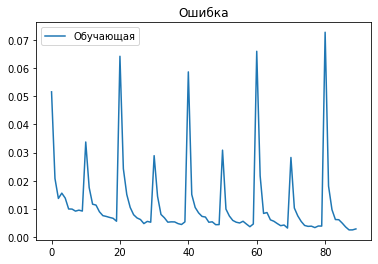

Обучаем с параметрами: sigmoid seed 42
Epoch 1/10
20/20 [==============================] - 31s 448ms/step - loss: 0.0290 - mae: 0.1315
Epoch 2/10
20/20 [==============================] - 9s 456ms/step - loss: 0.0094 - mae: 0.0741
Epoch 3/10
20/20 [==============================] - 9s 459ms/step - loss: 0.0052 - mae: 0.0553
Epoch 4/10
20/20 [==============================] - 9s 453ms/step - loss: 0.0040 - mae: 0.0481
Epoch 5/10
20/20 [==============================] - 9s 447ms/step - loss: 0.0038 - mae: 0.0481
Epoch 6/10
20/20 [==============================] - 9s 446ms/step - loss: 0.0036 - mae: 0.0453
Epoch 7/10
20/20 [==============================] - 9s 444ms/step - loss: 0.0034 - mae: 0.0446
Epoch 8/10
20/20 [==============================] - 9s 443ms/step - loss: 0.0030 - mae: 0.0416
Epoch 9/10
20/20 [==============================] - 9s 445ms/step - loss: 0.0034 - mae: 0.0449
Epoch 10/10
20/20 [==============================] - 9s 447ms/step - loss: 0.0031 - mae: 0.0427


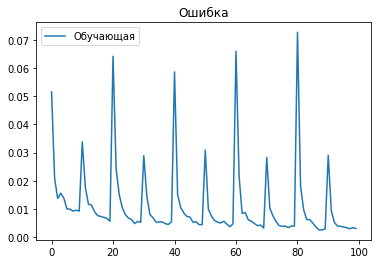

Executed


In [ ]:
hist = [[],[],[],[]]  # запись истории

for i in range(10):
  print('Обучаем с параметрами:', act_conf[i%2], 'seed', i//2*10+2) 
  seed_everything(i//2*10+2)
  model = Model(input_frag, create_back(base_model, act = act_conf[i%2], d1 = 1024, d2 = 512, d3 = 0))
  model.compile(loss='mse',
                optimizer=Adam(learning_rate=1e-3),
                metrics=['mae'])

  # print('генерируем выборку: ', end='')
  # x_train, y_train = get_dataset(resized_img, dataset_size=500)
  # x_val, y_val = get_dataset(resized_img, dataset_size=200)
  # print('success!')

  store = model.fit(train_img[:200], train_xya[:200],
                  epochs = 10,
                  batch_size = 10,
                  verbose = 1,
                  # validation_data = (x_val, y_val),
                  # validation_data = (train_img[600:], train_xya[600:]),
                  # callbacks=[callback]
                  )
  
  # print('predicted:',model.predict([x1_val, x2_val]))

##############################
# выводим результат предсказания
  # p = model.predict(x_test)
  # points = np.int32(list(map(get_points,y_test)))
  # points_pred = np.int32(list(map(get_points,p)))

  # # print(points[0])
  # points[:,[2,3]] = points[:,[3,2]]
  # points_pred[:,[2,3]] = points_pred[:,[3,2]]
  # # tmp_img = resized_img.copy()
  # tmp_img = resize_image(resized_img, width=640)
  
  # for id in range(10):
  #   cv2.polylines(tmp_img, np.int32([points[id]]), 1, (0,0,255), thickness=2)
  #   cv2.circle(tmp_img,(int(y_test[id][0]*tmp_img.shape[1]),int(y_test[id][1]*tmp_img.shape[1])),3,(0,0,255))

  #   cv2.polylines(tmp_img, np.int32([points_pred[id]]), 1, (255,0,0), thickness=2)
  #   cv2.circle(tmp_img,(int(p[id][0]*tmp_img.shape[1]),int(p[id][1]*tmp_img.shape[1])),3,(255,0,0))

  #   pt1 = (int(p[id][0]*tmp_img.shape[1]),int(p[id][1]*tmp_img.shape[1]))
  #   pt2 = (int(y_test[id][0]*tmp_img.shape[1]),int(y_test[id][1]*tmp_img.shape[1]))
  #   color = (0, 255, 0)
  #   thickness=1

  #   # pt1 = (100, 100)
  #   # pt2 = (400, 350)

  #   cv2.line(tmp_img, pt1, pt2,color,thickness)

  # # cv2_imshow(resize_image(tmp_img, width=600))
  # cv2.imwrite(dir_home+'show_training/'+models_name[i]+'_img_pred.png', tmp_img)

  # del model

  # model.save('/content/drive/MyDrive/Aerophoto/weights/3/')
###########################

  # del x_train
  # del y_train

  # del x_val
  # del y_val

  # hist[0].extend(store.history['compute_metric_simp'])
  # hist[1].extend(store.history['val_compute_metric_simp'])
  hist[2].extend(store.history['loss'])
  # hist[3].extend(store.history['val_loss'])

  # plt.plot(hist[0], label='Обучающая')
  # plt.plot(hist[1], label='Проверочная')
  # plt.legend()
  # plt.title('Точность')
  # plt.show()
  plt.plot(hist[2], label='Обучающая')
  # plt.plot(hist[3], label='Проверочная')
  plt.legend()
  plt.title('Ошибка')
  plt.show()

try:
  sound()
  print('Executed')
except:
  print('Executed')

## Финальное обучение здесь

**Своя ошибка**

In [ ]:
def my_loss_fn():
    def loss(y_true: tf.Tensor, y_pred: tf.Tensor) -> tf.Tensor:
        mse = K.square(y_pred-y_true)
        distance = K.sqrt((y_pred[:,0]-y_true[:,0])**2+(y_pred[:,1]-y_true[:,1])**2)
        penalty = 0.1 # будем дополнительно штрафовать, если расстояние больше пересечения фрагментов
        ls = K.minimum(distance, 0.1) * penalty
        # print(K.mean(mse)+K.mean(ls), '\n', K.mean(mse))
        return K.mean(mse)+K.mean(ls)
    return loss

# t1 = tf.constant(train_xya[:11])
# t2 = tf.constant(train_xya[1:12])

# my_loss_fn()(t1, t2)

In [ ]:
train_xya[:1],train_xya[1:2]

(array([[0.31559642, 0.86209032, 0.05449674, 0.72699525]]),
 array([[5.89986662e-01, 2.76057546e-01, 4.82550252e-01, 3.04586493e-04]]))

In [ ]:
t1 = tf.constant([ 0.5, 0.5, 0., 0.])
t2 = tf.constant([ 0.1, 0.1, 0., 0.])

my_loss_fn()(t1, t2)

<tf.Tensor: shape=(), dtype=float32, numpy=0.080000006>

In [ ]:
def scheduler(epoch, lr):
   if epoch < 9:
     return lr
   else:
     return lr * exp(-0.1)

callback = LearningRateScheduler(scheduler)

In [ ]:
checkpoint_filepath = '/content/drive/MyDrive/Aerophoto/fin_weights/cp_1/'
model_checkpoint_callback = ModelCheckpoint(
    filepath=checkpoint_filepath,
    save_weights_only=True,
    monitor='loss',
    mode='min',
    save_best_only=True)


In [ ]:
# восстанавливаем веса
# model.load_weights('/content/drive/MyDrive/Aerophoto/checkpoint/aug/') # create_back(base_model, act = "linear", d1 = 256, d2 = 512, d3 = 128) - score 93.4

In [ ]:
# model.save('/content/drive/MyDrive/Aerophoto/weights/6a/')  # результаты после первого дообучения худших

INFO:tensorflow:Assets written to: /content/drive/MyDrive/Aerophoto/weights/6a/assets


INFO:tensorflow:Assets written to: /content/drive/MyDrive/Aerophoto/weights/6a/assets


#### тренировка с аугментацией с 0

In [ ]:
# тренировка B6
hist = [[],[],[],[]]  # запись истории

seed_everything(42)
# model = Model(input_frag, create_back(base_model, act = "linear", d1 = 1024, d2 = 512, d3 = 0))
model.compile(loss='mse', # my_loss_fn()
# model.compile(loss=BinaryCrossentropy(from_logits=1),
              optimizer=Adam(learning_rate=1e-3),
              metrics=['mae'])


for i in range(1):
  print('Цикл',i)
  ###############################
  # выбираем 25% лучших (для валидации) и худших (для тренировки)
  # val_img_looser,val_xya_looser,add_img,add_xya,val_img,val_xya = val_loosers(num_show=10)
  ###############################

  # print('Результаты до обучения худшие 25%', model.evaluate(val_img_looser, val_xya_looser,verbose=0), '\nлучшие 25%',model.evaluate(val_img, val_xya,verbose=0)) 
  # аугментация перед обучением
  aug_train_img = seq.augment_images(train_img) # аугментация фрагментов из подложки (совпадают с худшими фрагментами)

  X = np.concatenate([train_img,aug_train_img])
  Y = np.concatenate([train_xya,train_xya])

  del aug_train_img # освобождаем память

  store = model.fit(X, Y,
                  epochs = 40,
                  batch_size = 16,
                  verbose = 1,
                  # validation_data = (val_img, val_xya),
                  # validation_data = (train_img[600:], train_xya[600:]),
                  callbacks=[callback,model_checkpoint_callback]
                  )
  
  # print('смотрим ошибку на 25% looser картинках после обучения',model.evaluate(val_img_looser, val_xya_looser,verbose=0))
  


##############################
  # model.save('/content/drive/MyDrive/Aerophoto/weights/6a/')
###########################

  # hist[0].extend(store.history['compute_metric_simp'])
  # hist[1].extend(store.history['val_compute_metric_simp'])
  hist[2].extend(store.history['loss'])
  # hist[3].extend(store.history['val_loss'])

  # plt.plot(hist[0], label='Обучающая')
  # plt.plot(hist[1], label='Проверочная')
  # plt.legend()
  # plt.title('Точность')
  # plt.show()
  plt.plot(hist[2], label='Обучающая')
  # plt.plot(hist[3], label='Проверочная')
  plt.legend()
  plt.title('Ошибка')
  plt.show()

try:
  sound()
  print('Executed')
except:
  print('Executed')

Цикл 0
Epoch 1/40
100/100 [==============================] - 104s 694ms/step - loss: 0.0232 - mae: 0.1034 - lr: 0.0010
Epoch 2/40
100/100 [==============================] - 72s 718ms/step - loss: 0.0145 - mae: 0.0856 - lr: 0.0010
Epoch 3/40
100/100 [==============================] - 71s 710ms/step - loss: 0.0141 - mae: 0.0825 - lr: 0.0010
Epoch 4/40
100/100 [==============================] - 71s 712ms/step - loss: 0.0093 - mae: 0.0694 - lr: 0.0010
Epoch 5/40
100/100 [==============================] - 71s 708ms/step - loss: 0.0086 - mae: 0.0675 - lr: 0.0010
Epoch 6/40
100/100 [==============================] - 71s 714ms/step - loss: 0.0084 - mae: 0.0664 - lr: 0.0010
Epoch 7/40
100/100 [==============================] - 71s 713ms/step - loss: 0.0065 - mae: 0.0601 - lr: 0.0010
Epoch 8/40
100/100 [==============================] - 68s 682ms/step - loss: 0.0083 - mae: 0.0649 - lr: 0.0010
Epoch 9/40
100/100 [==============================] - 68s 678ms/step - loss: 0.0116 - mae: 0.0762 - lr: 

NameError: ignored

In [ ]:
model.save('/content/drive/MyDrive/Aerophoto/fin_weights/7a/')  # 0.928922

INFO:tensorflow:Assets written to: /content/drive/MyDrive/Aerophoto/fin_weights/7a/assets


INFO:tensorflow:Assets written to: /content/drive/MyDrive/Aerophoto/fin_weights/7a/assets


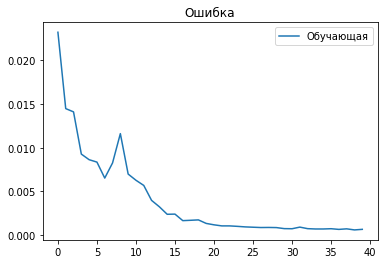

In [ ]:
  hist[2].extend(store.history['loss'])
  # hist[3].extend(store.history['val_loss'])

  # plt.plot(hist[0], label='Обучающая')
  # plt.plot(hist[1], label='Проверочная')
  # plt.legend()
  # plt.title('Точность')
  # plt.show()
  plt.plot(hist[2], label='Обучающая')
  # plt.plot(hist[3], label='Проверочная')
  plt.legend()
  plt.title('Ошибка')
  plt.show()

In [ ]:
# дообучение
hist = [[],[],[],[]]  # запись истории

seed_everything(42)
# model = Model(input_frag, create_back(base_model, act = "linear", d1 = 1024, d2 = 512, d3 = 0))
# model.compile(loss='mse', # my_loss_fn()
# # model.compile(loss=BinaryCrossentropy(from_logits=1),
#               optimizer=Adam(learning_rate=1e-3),
#               metrics=['mae'])


for i in range(1):
  print('Цикл',i)
  ###############################
  # выбираем 25% лучших (для валидации) и худших (для тренировки)
  # val_img_looser,val_xya_looser,add_img,add_xya,val_img,val_xya = val_loosers(num_show=10)
  ###############################

  # print('Результаты до обучения худшие 25%', model.evaluate(val_img_looser, val_xya_looser,verbose=0), '\nлучшие 25%',model.evaluate(val_img, val_xya,verbose=0)) 
  # аугментация перед обучением
  aug_train_img = seq.augment_images(train_img) # аугментация фрагментов из подложки (совпадают с худшими фрагментами)

  X = np.concatenate([train_img,aug_train_img])
  Y = np.concatenate([train_xya,train_xya])

  del aug_train_img # освобождаем память

  store = model.fit(X, Y,
                  epochs = 40,
                  batch_size = 16,
                  verbose = 1,
                  # validation_data = (val_img, val_xya),
                  # validation_data = (train_img[600:], train_xya[600:]),
                  callbacks=[callback,model_checkpoint_callback]
                  )
  
  # print('смотрим ошибку на 25% looser картинках после обучения',model.evaluate(val_img_looser, val_xya_looser,verbose=0))
  


##############################
  # model.save('/content/drive/MyDrive/Aerophoto/weights/6a/')
###########################

  # hist[0].extend(store.history['compute_metric_simp'])
  # hist[1].extend(store.history['val_compute_metric_simp'])
  hist[2].extend(store.history['loss'])
  # hist[3].extend(store.history['val_loss'])

  # plt.plot(hist[0], label='Обучающая')
  # plt.plot(hist[1], label='Проверочная')
  # plt.legend()
  # plt.title('Точность')
  # plt.show()
  plt.plot(hist[2], label='Обучающая')
  # plt.plot(hist[3], label='Проверочная')
  plt.legend()
  plt.title('Ошибка')
  plt.show()

try:
  sound()
  print('Executed')
except:
  print('Executed')

Цикл 0
Epoch 1/40
100/100 [==============================] - 74s 684ms/step - loss: 0.0039 - mae: 0.0308 - lr: 1.4996e-05
Epoch 2/40
 12/100 [==>...........................] - ETA: 1:00 - loss: 0.0028 - mae: 0.0285

In [ ]:
model.save('/content/drive/MyDrive/Aerophoto/fin_weights/7a_2/')

INFO:tensorflow:Assets written to: /content/drive/MyDrive/Aerophoto/fin_weights/7a_2/assets


INFO:tensorflow:Assets written to: /content/drive/MyDrive/Aerophoto/fin_weights/7a_2/assets


#### тренировка на худших (не пошло)

Цикл 0
Результаты до обучения худшие 25% [0.0009584423969499767, 0.0237105805426836] 
лучшие 25% [0.0005339013296179473, 0.017899036407470703]
Epoch 1/10
20/20 [==============================] - 44s 1s/step - loss: 0.0330 - mae: 0.1101 - val_loss: 5.3321e-04 - val_mae: 0.0176 - lr: 1.0000e-05
Epoch 2/10
20/20 [==============================] - 21s 1s/step - loss: 0.0323 - mae: 0.1080 - val_loss: 5.4379e-04 - val_mae: 0.0179 - lr: 1.0000e-05
Epoch 3/10
20/20 [==============================] - 21s 1s/step - loss: 0.0289 - mae: 0.1037 - val_loss: 5.7441e-04 - val_mae: 0.0185 - lr: 1.0000e-05
Epoch 4/10
20/20 [==============================] - 22s 1s/step - loss: 0.0286 - mae: 0.1023 - val_loss: 6.1901e-04 - val_mae: 0.0193 - lr: 1.0000e-05
Epoch 5/10
20/20 [==============================] - 22s 1s/step - loss: 0.0271 - mae: 0.0992 - val_loss: 6.4307e-04 - val_mae: 0.0197 - lr: 1.0000e-05
Epoch 6/10
20/20 [==============================] - 21s 1s/step - loss: 0.0267 - mae: 0.0993 - val_los

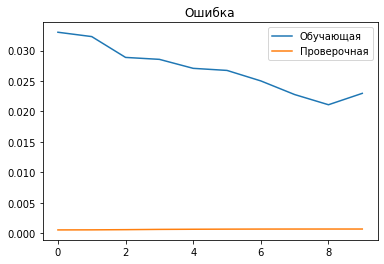

Цикл 1
Результаты до обучения худшие 25% [0.0011491917539387941, 0.025742031633853912] 
лучшие 25% [0.0006790353218093514, 0.020460382103919983]
Epoch 1/10
20/20 [==============================] - 18s 913ms/step - loss: 0.0278 - mae: 0.0991 - val_loss: 6.7411e-04 - val_mae: 0.0203 - lr: 9.0484e-06
Epoch 2/10
20/20 [==============================] - 18s 880ms/step - loss: 0.0261 - mae: 0.0956 - val_loss: 6.9343e-04 - val_mae: 0.0206 - lr: 9.0484e-06
Epoch 3/10
20/20 [==============================] - 18s 926ms/step - loss: 0.0259 - mae: 0.0956 - val_loss: 7.0175e-04 - val_mae: 0.0208 - lr: 9.0484e-06
Epoch 4/10
20/20 [==============================] - 17s 879ms/step - loss: 0.0241 - mae: 0.0930 - val_loss: 7.1723e-04 - val_mae: 0.0210 - lr: 9.0484e-06
Epoch 5/10
20/20 [==============================] - 18s 924ms/step - loss: 0.0239 - mae: 0.0928 - val_loss: 7.1133e-04 - val_mae: 0.0209 - lr: 9.0484e-06
Epoch 6/10
20/20 [==============================] - 18s 888ms/step - loss: 0.0225 - m

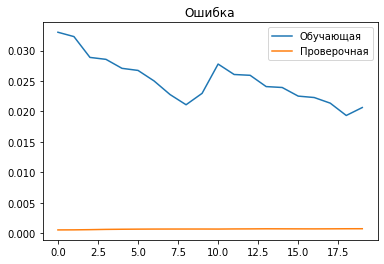

Executed


In [ ]:
# тренировака B6 на худших, скор упал(
hist = [[],[],[],[]]  # запись истории

seed_everything(42)
# model = Model(input_frag, create_back(base_model, act = "linear", d1 = 1024, d2 = 512, d3 = 0))
model.compile(loss='mse', # my_loss_fn()
# model.compile(loss=BinaryCrossentropy(from_logits=1),
              optimizer=Adam(learning_rate=1e-3),
              metrics=['mae'])


for i in range(2):
  print('Цикл',i)
  ###############################
  # выбираем 25% лучших (для валидации) и худших (для тренировки)
  # val_img_looser,val_xya_looser,add_img,add_xya = val_loosers(num_show=10)
  ###############################

  print('Результаты до обучения худшие 25%', model.evaluate(val_img_looser, val_xya_looser,verbose=0), '\nлучшие 25%',model.evaluate(val_img, val_xya,verbose=0)) 
  # аугментация перед обучением
  aug_train_img = seq.augment_images(add_img) # аугментация фрагментов из подложки (совпадают с худшими фрагментами)
  X = np.concatenate([val_img_looser,aug_train_img])
  Y = np.concatenate([val_xya_looser,add_xya])

  store = model.fit(X, Y,
                  epochs = 10,
                  batch_size = 20,
                  verbose = 1,
                  validation_data = (val_img, val_xya),
                  # validation_data = (train_img[600:], train_xya[600:]),
                  callbacks=[callback,model_checkpoint_callback]
                  )
  
  print('смотрим ошибку на 25% looser картинках после обучения',model.evaluate(val_img_looser, val_xya_looser,verbose=0))
  


##############################
  # model.save('/content/drive/MyDrive/Aerophoto/weights/6a/')
###########################

  # hist[0].extend(store.history['compute_metric_simp'])
  # hist[1].extend(store.history['val_compute_metric_simp'])
  hist[2].extend(store.history['loss'])
  hist[3].extend(store.history['val_loss'])

  # plt.plot(hist[0], label='Обучающая')
  # plt.plot(hist[1], label='Проверочная')
  # plt.legend()
  # plt.title('Точность')
  # plt.show()
  plt.plot(hist[2], label='Обучающая')
  plt.plot(hist[3], label='Проверочная')
  plt.legend()
  plt.title('Ошибка')
  plt.show()

try:
  sound()
  print('Executed')
except:
  print('Executed')

In [ ]:
model.evaluate(val_img_looser, val_xya_looser,verbose=1)

7/7 [==============================] - 2s 239ms/step - loss: 0.0040 - mae: 0.0460


[0.003953632898628712, 0.046037573367357254]

### B7

Обучаем со своим лосс
Epoch 1/20
100/100 [==============================] - 74s 479ms/step - loss: 0.0378 - mae: 0.1453 - lr: 0.0010
Epoch 2/20
100/100 [==============================] - 48s 484ms/step - loss: 0.0441 - mae: 0.1596 - lr: 0.0010
Epoch 3/20
100/100 [==============================] - 48s 483ms/step - loss: 0.0366 - mae: 0.1469 - lr: 0.0010
Epoch 4/20
100/100 [==============================] - 48s 483ms/step - loss: 0.0274 - mae: 0.1251 - lr: 0.0010
Epoch 5/20
100/100 [==============================] - 48s 484ms/step - loss: 0.0294 - mae: 0.1287 - lr: 0.0010
Epoch 6/20
100/100 [==============================] - 48s 483ms/step - loss: 0.0231 - mae: 0.1136 - lr: 0.0010
Epoch 7/20
100/100 [==============================] - 48s 483ms/step - loss: 0.0217 - mae: 0.1110 - lr: 0.0010
Epoch 8/20
100/100 [==============================] - 48s 483ms/step - loss: 0.0200 - mae: 0.1060 - lr: 0.0010
Epoch 9/20
100/100 [==============================] - 48s 483ms/step - loss: 0.0215 - mae:

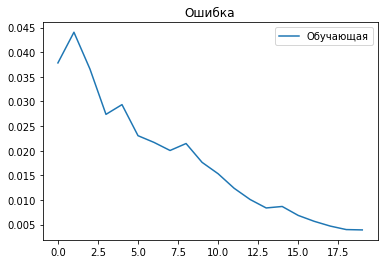

Обучаем со своим лосс
Epoch 1/20
100/100 [==============================] - 48s 481ms/step - loss: 0.0038 - mae: 0.0468 - lr: 3.3287e-04
Epoch 2/20
100/100 [==============================] - 49s 493ms/step - loss: 0.0034 - mae: 0.0444 - lr: 3.3287e-04
Epoch 3/20
100/100 [==============================] - 48s 481ms/step - loss: 0.0031 - mae: 0.0423 - lr: 3.3287e-04
Epoch 4/20
100/100 [==============================] - 48s 484ms/step - loss: 0.0027 - mae: 0.0405 - lr: 3.3287e-04
Epoch 5/20
100/100 [==============================] - 48s 482ms/step - loss: 0.0030 - mae: 0.0418 - lr: 3.3287e-04
Epoch 6/20
100/100 [==============================] - 49s 489ms/step - loss: 0.0029 - mae: 0.0399 - lr: 3.3287e-04
Epoch 7/20
100/100 [==============================] - 49s 492ms/step - loss: 0.0026 - mae: 0.0392 - lr: 3.3287e-04
Epoch 8/20
100/100 [==============================] - 49s 486ms/step - loss: 0.0026 - mae: 0.0385 - lr: 3.3287e-04
Epoch 9/20
100/100 [==============================] - 48s 

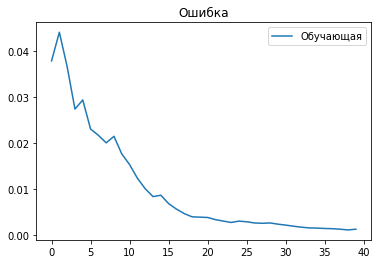

Обучаем со своим лосс
Epoch 1/20
100/100 [==============================] - 49s 486ms/step - loss: 0.0012 - mae: 0.0264 - lr: 1.1080e-04
Epoch 2/20
100/100 [==============================] - 48s 481ms/step - loss: 9.7999e-04 - mae: 0.0241 - lr: 1.1080e-04
Epoch 3/20
100/100 [==============================] - 48s 484ms/step - loss: 8.8493e-04 - mae: 0.0231 - lr: 1.1080e-04
Epoch 4/20
100/100 [==============================] - 48s 484ms/step - loss: 8.8110e-04 - mae: 0.0230 - lr: 1.1080e-04
Epoch 5/20
100/100 [==============================] - 48s 483ms/step - loss: 0.0011 - mae: 0.0249 - lr: 1.1080e-04
Epoch 6/20
100/100 [==============================] - 48s 484ms/step - loss: 9.9606e-04 - mae: 0.0236 - lr: 1.1080e-04
Epoch 7/20
100/100 [==============================] - 48s 483ms/step - loss: 9.4931e-04 - mae: 0.0236 - lr: 1.1080e-04
Epoch 8/20
100/100 [==============================] - 48s 484ms/step - loss: 8.1880e-04 - mae: 0.0221 - lr: 1.1080e-04
Epoch 9/20
100/100 [==============

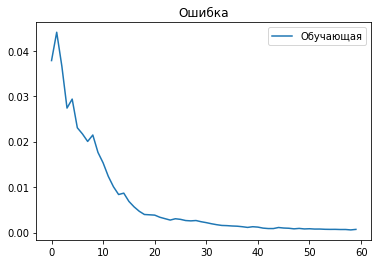

Обучаем со своим лосс
Epoch 1/20
100/100 [==============================] - 49s 485ms/step - loss: 6.5992e-04 - mae: 0.0196 - lr: 3.6883e-05
Epoch 2/20
100/100 [==============================] - 48s 483ms/step - loss: 5.5487e-04 - mae: 0.0182 - lr: 3.6883e-05
Epoch 3/20
100/100 [==============================] - 48s 483ms/step - loss: 5.1014e-04 - mae: 0.0175 - lr: 3.6883e-05
Epoch 4/20
100/100 [==============================] - 48s 482ms/step - loss: 5.1356e-04 - mae: 0.0176 - lr: 3.6883e-05
Epoch 5/20
100/100 [==============================] - 49s 486ms/step - loss: 6.1423e-04 - mae: 0.0186 - lr: 3.6883e-05
Epoch 6/20
100/100 [==============================] - 48s 483ms/step - loss: 5.5509e-04 - mae: 0.0180 - lr: 3.6883e-05
Epoch 7/20
100/100 [==============================] - 48s 483ms/step - loss: 5.1941e-04 - mae: 0.0175 - lr: 3.6883e-05
Epoch 8/20
100/100 [==============================] - 48s 484ms/step - loss: 4.6542e-04 - mae: 0.0165 - lr: 3.6883e-05
Epoch 9/20
100/100 [======

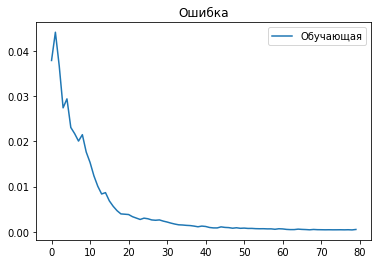

Executed


In [ ]:
# тренировка B7 Score = 0.929666
hist = [[],[],[],[]]  # запись истории

seed_everything(42)
# model = Model(input_frag, create_back(base_model, act = "linear", d1 = 1024, d2 = 512, d3 = 0))
model.compile(loss='mse', # my_loss_fn()
# model.compile(loss=BinaryCrossentropy(from_logits=1),
              optimizer=Adam(learning_rate=1e-5),
              metrics=['mae'])


for i in range(1):
  print('Обучаем',i) 

  # print('генерируем выборку: ', end='')
  # x_train, y_train = get_dataset(resized_img, dataset_size=500)
  # x_val, y_val = get_dataset(resized_img, dataset_size=200)
  # print('success!')

  store = model.fit(train_img[:], train_xya[:],
                  epochs = 20,
                  batch_size = 8,
                  verbose = 1,
                  # validation_data = (x_val, y_val),
                  # validation_data = (train_img[600:], train_xya[600:]),
                  callbacks=[callback]
                  )
  

##############################
# выводим результат предсказания
  # p = model.predict(x_test)
  # points = np.int32(list(map(get_points,y_test)))
  # points_pred = np.int32(list(map(get_points,p)))

  # # print(points[0])
  # points[:,[2,3]] = points[:,[3,2]]
  # points_pred[:,[2,3]] = points_pred[:,[3,2]]
  # # tmp_img = resized_img.copy()
  # tmp_img = resize_image(resized_img, width=640)
  
  # for id in range(10):
  #   cv2.polylines(tmp_img, np.int32([points[id]]), 1, (0,0,255), thickness=2)
  #   cv2.circle(tmp_img,(int(y_test[id][0]*tmp_img.shape[1]),int(y_test[id][1]*tmp_img.shape[1])),3,(0,0,255))

  #   cv2.polylines(tmp_img, np.int32([points_pred[id]]), 1, (255,0,0), thickness=2)
  #   cv2.circle(tmp_img,(int(p[id][0]*tmp_img.shape[1]),int(p[id][1]*tmp_img.shape[1])),3,(255,0,0))

  #   pt1 = (int(p[id][0]*tmp_img.shape[1]),int(p[id][1]*tmp_img.shape[1]))
  #   pt2 = (int(y_test[id][0]*tmp_img.shape[1]),int(y_test[id][1]*tmp_img.shape[1]))
  #   color = (0, 255, 0)
  #   thickness=1

  #   # pt1 = (100, 100)
  #   # pt2 = (400, 350)

  #   cv2.line(tmp_img, pt1, pt2,color,thickness)

  # # cv2_imshow(resize_image(tmp_img, width=600))
  # cv2.imwrite(dir_home+'show_training/final_img_pred.png', tmp_img)

  # del model

  model.save('/content/drive/MyDrive/Aerophoto/weights/4/')
###########################

  # hist[0].extend(store.history['compute_metric_simp'])
  # hist[1].extend(store.history['val_compute_metric_simp'])
  hist[2].extend(store.history['loss'])
  # hist[3].extend(store.history['val_loss'])

  # plt.plot(hist[0], label='Обучающая')
  # plt.plot(hist[1], label='Проверочная')
  # plt.legend()
  # plt.title('Точность')
  # plt.show()
  plt.plot(hist[2], label='Обучающая')
  # plt.plot(hist[3], label='Проверочная')
  plt.legend()
  plt.title('Ошибка')
  plt.show()

try:
  sound()
  print('Executed')
except:
  print('Executed')

In [ ]:
# model.load_weights('/content/drive/MyDrive/Aerophoto/weights/4/')
model.load_weights('/content/drive/MyDrive/Aerophoto/checkpoint/weight/')

Обучаем 0
Epoch 1/100
50/50 [==============================] - 51s 991ms/step - loss: 3.2155e-04 - mae: 0.0138 - lr: 1.1109e-05
Epoch 2/100
50/50 [==============================] - 51s 1s/step - loss: 2.9125e-04 - mae: 0.0131 - lr: 1.1109e-05
Epoch 3/100
50/50 [==============================] - 50s 1s/step - loss: 2.7789e-04 - mae: 0.0130 - lr: 1.1109e-05
Epoch 4/100
50/50 [==============================] - 45s 906ms/step - loss: 2.8569e-04 - mae: 0.0131 - lr: 1.1109e-05
Epoch 5/100
50/50 [==============================] - 45s 910ms/step - loss: 3.0433e-04 - mae: 0.0132 - lr: 1.1109e-05
Epoch 6/100
50/50 [==============================] - 45s 905ms/step - loss: 2.8390e-04 - mae: 0.0129 - lr: 1.1109e-05
Epoch 7/100
50/50 [==============================] - 50s 1s/step - loss: 2.7771e-04 - mae: 0.0128 - lr: 1.1109e-05
Epoch 8/100
50/50 [==============================] - 56s 1s/step - loss: 2.4907e-04 - mae: 0.0123 - lr: 1.1109e-05
Epoch 9/100
50/50 [==============================] - 45s 9

INFO:tensorflow:Assets written to: /content/drive/MyDrive/Aerophoto/weights/4/assets


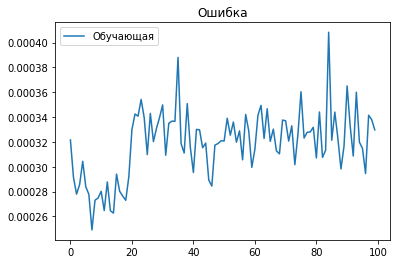

Обучаем 1
Epoch 1/100
50/50 [==============================] - 50s 1s/step - loss: 2.4747e-04 - mae: 0.0121 - lr: 1.2405e-09
Epoch 2/100
50/50 [==============================] - 50s 1s/step - loss: 2.3976e-04 - mae: 0.0120 - lr: 1.2405e-09
Epoch 3/100
50/50 [==============================] - 45s 907ms/step - loss: 2.4369e-04 - mae: 0.0119 - lr: 1.2405e-09
Epoch 4/100
50/50 [==============================] - 45s 906ms/step - loss: 2.4095e-04 - mae: 0.0119 - lr: 1.2405e-09
Epoch 5/100
50/50 [==============================] - 45s 904ms/step - loss: 2.5407e-04 - mae: 0.0123 - lr: 1.2405e-09
Epoch 6/100
50/50 [==============================] - 45s 905ms/step - loss: 2.5036e-04 - mae: 0.0119 - lr: 1.2405e-09
Epoch 7/100
45/50 [==========================>...] - ETA: 4s - loss: 2.3676e-04 - mae: 0.0119

In [ ]:
# Дообучение

hist = [[],[],[],[]]  # запись истории

# seed_everything(42)
# model = Model(input_frag, create_back(base_model, act = "linear", d1 = 1024, d2 = 512, d3 = 0))
# model.compile(loss='mse', # my_loss_fn()
# # model.compile(loss=BinaryCrossentropy(from_logits=1),
#               optimizer=Adam(learning_rate=1e-3),
#               metrics=['mae'])


for i in range(2):
  print('Обучаем',i) 

  # print('генерируем выборку: ', end='')
  # x_train, y_train = get_dataset(resized_img, dataset_size=500)
  # x_val, y_val = get_dataset(resized_img, dataset_size=200)
  # print('success!')

  store = model.fit(train_img[:], train_xya[:],
                  epochs = 100,
                  batch_size = 16,
                  verbose = 1,
                  # validation_data = (x_val, y_val),
                  # validation_data = (train_img[600:], train_xya[600:]),
                  callbacks=[callback,model_checkpoint_callback]
                  )
  

##############################
# выводим результат предсказания
  # p = model.predict(x_test)
  # points = np.int32(list(map(get_points,y_test)))
  # points_pred = np.int32(list(map(get_points,p)))

  # # print(points[0])
  # points[:,[2,3]] = points[:,[3,2]]
  # points_pred[:,[2,3]] = points_pred[:,[3,2]]
  # # tmp_img = resized_img.copy()
  # tmp_img = resize_image(resized_img, width=640)
  
  # for id in range(10):
  #   cv2.polylines(tmp_img, np.int32([points[id]]), 1, (0,0,255), thickness=2)
  #   cv2.circle(tmp_img,(int(y_test[id][0]*tmp_img.shape[1]),int(y_test[id][1]*tmp_img.shape[1])),3,(0,0,255))

  #   cv2.polylines(tmp_img, np.int32([points_pred[id]]), 1, (255,0,0), thickness=2)
  #   cv2.circle(tmp_img,(int(p[id][0]*tmp_img.shape[1]),int(p[id][1]*tmp_img.shape[1])),3,(255,0,0))

  #   pt1 = (int(p[id][0]*tmp_img.shape[1]),int(p[id][1]*tmp_img.shape[1]))
  #   pt2 = (int(y_test[id][0]*tmp_img.shape[1]),int(y_test[id][1]*tmp_img.shape[1]))
  #   color = (0, 255, 0)
  #   thickness=1

  #   # pt1 = (100, 100)
  #   # pt2 = (400, 350)

  #   cv2.line(tmp_img, pt1, pt2,color,thickness)

  # # cv2_imshow(resize_image(tmp_img, width=600))
  # cv2.imwrite(dir_home+'show_training/final_img_pred.png', tmp_img)

  # del model

  model.save('/content/drive/MyDrive/Aerophoto/weights/4/')
###########################

  # hist[0].extend(store.history['compute_metric_simp'])
  # hist[1].extend(store.history['val_compute_metric_simp'])
  hist[2].extend(store.history['loss'])
  # hist[3].extend(store.history['val_loss'])

  # plt.plot(hist[0], label='Обучающая')
  # plt.plot(hist[1], label='Проверочная')
  # plt.legend()
  # plt.title('Точность')
  # plt.show()
  plt.plot(hist[2], label='Обучающая')
  # plt.plot(hist[3], label='Проверочная')
  plt.legend()
  plt.title('Ошибка')
  plt.show()

try:
  sound()
  print('Executed')
except:
  print('Executed')

### С дополнением перекрестными d_xya

Идея: добавить слой с растояниями между тестовыми фрагментами

In [120]:
def create_model(training=False):
  # preproc = efficientnet.preprocess_input(input_frag) # не требуется

  base_model = EfficientNetB6(weights="imagenet", pooling='avg', include_top=False)

  base_model.trainable = training

  base_model = base_model(input_frag, training=training)

  x = Dense(1024, activation="elu", name="dense_core")(base_model)

  output_d_xy = Dense(1600, activation="sigmoid", name="d_xy")(x)
  output_d_a = Dense(1600, activation="sigmoid", name="d_a")(x)

  concat = concatenate([x, output_d_xy, output_d_a])
  vec = Dense(512, activation="elu")(concat)

  output_xy = Dense(2, activation="linear", name="xy")(vec)
  output_a = Dense(2, activation="sigmoid", name="a")(vec)
  
  return Model(inputs=input_frag, outputs=[output_xy, output_a, output_d_xy, output_d_a])

In [121]:
frag_height = 224 # Высота 
frag_width = 224 # Ширина 

chanels = 3 # Количество каналов  

input_frag_shape = (frag_height, frag_width, chanels)  # на этот вход подаем фрагмент  

input_frag = Input(shape=input_frag_shape)

# базовая модель
model = create_model(training=False)

In [106]:
base_model.shape

TensorShape([None, 2304])

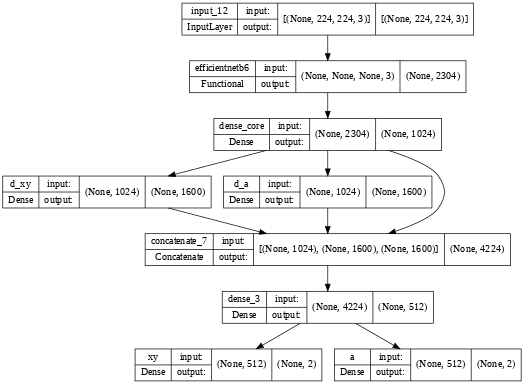

In [122]:
from tensorflow.keras.utils import plot_model
plot_model(model,show_shapes=True,dpi=50, show_layer_names=True)

In [123]:
model.summary()

Model: "model_8"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_12 (InputLayer)          [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 efficientnetb6 (Functional)    (None, 2304)         40960143    ['input_12[0][0]']               
                                                                                                  
 dense_core (Dense)             (None, 1024)         2360320     ['efficientnetb6[0][0]']         
                                                                                                  
 d_xy (Dense)                   (None, 1600)         1640000     ['dense_core[0][0]']       

#### Готовим датасет
1. Тренировочные картинки уже есть в train_img
2. Создаем Ydxya (800,800,4) разница между true и координатами тренировочного фрагмента

In [109]:
train_img.shape, train_xya.shape

((800, 224, 224, 3), (800, 4))

In [111]:
train_d_xya = np.array([tr_xya-train_xya for tr_xya in train_xya])

In [119]:
# проверка. Позиция id всегда будет 0
train_d_xya.shape, '', train_d_xya[1]

((800, 800, 4),
 '',
 array([[-0.10394436, -0.55678354,  0.3308429 , -0.67832848],
        [ 0.        ,  0.        ,  0.        ,  0.        ],
        [-0.36899771, -0.34756098,  0.2489433 ,  0.25778833],
        ...,
        [-0.44974276, -0.57788681, -0.03974757, -0.19536556],
        [-0.56850229, -0.05182927, -0.03056117, -0.09996107],
        [-0.10794588, -0.62452363,  0.6312625 , -0.66521187]]))

#### Обучение НС

In [124]:
# 1. приближение относительно начальной точки важнее абсолютного смещения (компенсирует смещения на малых расстояниях)
# для этого mse делим на y_true
def loss_dxya2():
    def loss(y_true: tf.Tensor, y_pred: tf.Tensor) -> tf.Tensor:
        return K.mean(K.square((y_pred-y_true)/y_true))
    return loss

# 2. Если расстояние увеличивается от начального, метрика становится отрицательной. И наоборот
def dxy_metric(y_true: tf.Tensor, y_pred: tf.Tensor) -> tf.Tensor:
    # mse = K.square(y_pred-y_true)
    true_distance = K.sqrt((y_true[:,0])**2+(y_true[:,1])**2) # отклонение до предсказания 
    new_distance = K.sqrt((y_pred[:,0]-y_true[:,0])**2+(y_pred[:,1]-y_true[:,1])**2)  # отклонение после смещения на предсказанное расстояние
    return K.mean(true_distance-new_distance)

In [126]:
checkpoint_filepath = '/content/drive/MyDrive/Aerophoto/fin_weights/cp_3/'
model_checkpoint_callback = ModelCheckpoint(
    filepath=checkpoint_filepath,
    save_weights_only=True,
    monitor='loss',
    mode='min',
    save_best_only=True)

In [127]:
def scheduler(epoch, lr):
   if epoch < 9:
     return lr
   else:
     return lr * exp(-0.1)

callback = LearningRateScheduler(scheduler)

In [129]:
model.outputs

[<KerasTensor: shape=(None, 2) dtype=float32 (created by layer 'xy')>,
 <KerasTensor: shape=(None, 2) dtype=float32 (created by layer 'a')>,
 <KerasTensor: shape=(None, 1600) dtype=float32 (created by layer 'd_xy')>,
 <KerasTensor: shape=(None, 1600) dtype=float32 (created by layer 'd_a')>]

In [162]:
seed_everything(42)
model.compile(loss=['mse', 'mse', 'mse', 'mse'],
              optimizer=Adam(learning_rate=1e-3),
              metrics=['mae'])

In [143]:
train_xya[:val_th,:2].shape, train_xya[:val_th,2:].shape, np.reshape(train_d_xya[:val_th,:,:2], (100,-1)).shape, train_d_xya[:val_th,:,2:].shape

((100, 2), (100, 2), (100, 1600), (100, 800, 2))

In [153]:
np.reshape(train_d_xya[:val_th,:,2:],(100,-1)).shape

(100, 1600)

Обучаем модель EfficientNetB6 0
Epoch 1/5
10/10 [==============================] - 32s 3s/step - loss: 1.0917 - xy_loss: 0.0550 - a_loss: 0.1216 - d_xy_loss: 0.4221 - d_a_loss: 0.4929 - xy_mae: 0.1903 - a_mae: 0.2985 - d_xy_mae: 0.5439 - d_a_mae: 0.5688
Epoch 2/5
10/10 [==============================] - 25s 2s/step - loss: 1.0329 - xy_loss: 0.0569 - a_loss: 0.1261 - d_xy_loss: 0.3899 - d_a_loss: 0.4600 - xy_mae: 0.1955 - a_mae: 0.3137 - d_xy_mae: 0.5192 - d_a_mae: 0.5472
Epoch 3/5
10/10 [==============================] - 26s 3s/step - loss: 0.9698 - xy_loss: 0.0513 - a_loss: 0.1347 - d_xy_loss: 0.3571 - d_a_loss: 0.4267 - xy_mae: 0.1854 - a_mae: 0.3111 - d_xy_mae: 0.4939 - d_a_mae: 0.5253
Epoch 4/5
10/10 [==============================] - 45s 5s/step - loss: 0.9008 - xy_loss: 0.0496 - a_loss: 0.1302 - d_xy_loss: 0.3250 - d_a_loss: 0.3960 - xy_mae: 0.1827 - a_mae: 0.3165 - d_xy_mae: 0.4682 - d_a_mae: 0.5039
Epoch 5/5
10/10 [==============================] - 32s 3s/step - loss: 0.8319 - 

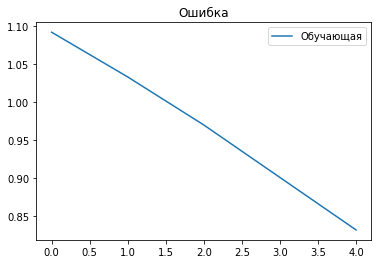

Обучаем модель EfficientNetB6 1
Epoch 1/5
 5/10 [==============>...............] - ETA: 12s - loss: 0.7309 - xy_loss: 0.0388 - a_loss: 0.1123 - d_xy_loss: 0.2634 - d_a_loss: 0.3164 - xy_mae: 0.1650 - a_mae: 0.2910 - d_xy_mae: 0.4160 - d_a_mae: 0.4456

KeyboardInterrupt: ignored

In [166]:
hist = [[],[],[],[]]  # запись истории
val_th = 100

for i in range(3):
  print('Обучаем модель EfficientNetB6', i)

  X = train_img[:val_th]
  Y = [train_xya[:val_th,:2], train_xya[:val_th,2:],np.reshape(train_d_xya[:val_th,:,:2],(100,-1)),np.reshape(train_d_xya[:val_th,:,2:],(100,-1))]

  X_val = train_img[val_th:]
  Y_val = [train_xya[val_th:,:2], train_xya[val_th:,2:],np.reshape(train_d_xya[val_th:,:,:2],(100,-1)),np.reshape(train_d_xya[val_th:,:,2:],(100,-1))]

  store = model.fit(X, Y,
                  epochs = 5,
                  batch_size = 10,
                  verbose = 1,
                  validation_data = (X_val, Y_val),
                  # validation_data = ([train_img_64[600:],train_frag[600:]], train_d_xya[600:]*20),
                  # callbacks=[callback]
                  )
  
  # print('predicted:',model.predict([x1_val, x2_val]))

##############################
  # model.save('/content/drive/MyDrive/Aerophoto/weights/4/')
###########################


  # hist[0].extend(store.history['dxy_metric'])
  # hist[1].extend(store.history['val_dxy_metric'])
  hist[2].extend(store.history['loss'])
  # hist[3].extend(store.history['val_loss'])

  # plt.plot(hist[0], label='Обучающая')
  # plt.plot(hist[1], label='Проверочная')
  # plt.legend()
  # plt.title('Точность')
  plt.show()
  plt.plot(hist[2], label='Обучающая')
  # plt.plot(hist[3], label='Проверочная')
  plt.legend()
  plt.title('Ошибка')
  plt.show()

try:
  sound()
  print('Executed')
except:
  print('Executed')

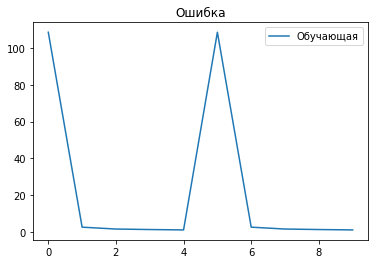

In [165]:
  hist[2].extend(store.history['loss'])
  # hist[3].extend(store.history['val_loss'])

  # plt.plot(hist[0], label='Обучающая')
  # plt.plot(hist[1], label='Проверочная')
  # plt.legend()
  # plt.title('Точность')
  plt.show()
  plt.plot(hist[2], label='Обучающая')
  # plt.plot(hist[3], label='Проверочная')
  plt.legend()
  plt.title('Ошибка')
  plt.show()

## Обучение с подложкой (не полетело)

### Создаем НС

In [ ]:
from tensorflow.keras.applications import InceptionResNetV2, EfficientNetB6, ResNet50, ResNet152, ResNet50V2, EfficientNetB2
# для создания сети
from tensorflow.keras.models import Sequential, Model

# для создания слоев
from tensorflow.keras.layers import Dense, Conv2D, MaxPooling2D, Flatten, Dropout, BatchNormalization, SpatialDropout2D, RandomRotation
from tensorflow.keras.layers import Input, concatenate, GlobalAveragePooling2D, Softmax, ReLU, GlobalMaxPooling2D
from tensorflow.keras.layers import Resizing, Concatenate, Reshape, AveragePooling2D


# для работы с изображениями
from tensorflow.keras.preprocessing import image

from tensorflow.keras.metrics import binary_accuracy, CategoricalAccuracy 

from tensorflow.keras.losses import BinaryCrossentropy, binary_crossentropy, categorical_crossentropy, CosineSimilarity

# оптимизатор
from tensorflow.keras.optimizers import Adam, SGD

from tensorflow.keras.callbacks import LambdaCallback, EarlyStopping, Callback, LearningRateScheduler, ModelCheckpoint

# from tensorflow.keras.applications.resnet_v2 import preprocess_input
from tensorflow.keras.applications import resnet_v2, efficientnet, efficientnet_v2, xception, inception_resnet_v2

# модуль для отсчета времени
import time 
# import datetime

import matplotlib.pyplot as plt

from tensorflow.keras import backend as K

In [ ]:
org_shape, resized_img.shape

((10496, 10496, 3), (2294, 2294, 3))

In [ ]:
2294/2, 2294/224, 10496/1024

(1147.0, 10.241071428571429, 10.25)

In [ ]:
k = 16
10496/k, 1024/k

(656.0, 64.0)

In [ ]:
# входные размеры

sec_height = 256 # Высота подложки (2294) 10496/16=656
sec_width = 256 # Ширина подложки

frag_height = 64 # Высота фрагмента (224/2)
frag_width = 64 # Ширина фрагмента

chanels = 3 # Количество каналов  

input_sec_shape = (sec_height, sec_width, chanels)  # на этот вход подаем сектор

input_frag_shape = (frag_height, frag_width, chanels)  # на этот вход подаем фрагмент


In [ ]:
# базовая модель

# base_model = EfficientNetB2(weights="imagenet", include_top=False)  #([input_sec,input_frag])
base_model = EfficientNetB6(weights="imagenet", include_top=False)  #([input_sec,input_frag])

model = Model(inputs=base_model.input, outputs=base_model.output)

In [ ]:
embedding1 = Model(model.input, base_model.output, name='emb_sec')
embedding2 = Model(model.input, base_model.output, name='emb_frag')

In [ ]:
# векторы признаков

input_sec = Input(shape=input_sec_shape)

# input_frag = Input(shape=input_frag_shape)
input_frag = Input(shape=(64,64,3))
# input_frag2 = Resizing(frag_height,frag_width)(input_frag)

vec_sec = (embedding1(input_sec)) # вектор подложки
vec_frag = (embedding2(input_frag)) # вектор фрагмента

# preproc = efficientnet.preprocess_input(input_frag)

In [ ]:
# размеры выходов
vec_sec.shape, vec_frag.shape

(TensorShape([None, 8, 8, 2304]), TensorShape([None, 2, 2, 2304]))

In [ ]:
# уменьшим в 2 раза
vec_sec = AveragePooling2D(2)(vec_sec)
vec_frag = AveragePooling2D(2)(vec_frag)

vec_sec =Conv2D(512, kernel_size=(1, 1), activation="relu", padding="same")(vec_sec)
vec_frag = Conv2D(512, kernel_size=(1, 1), activation="relu", padding="same")(vec_frag)

vec_sec.shape, vec_frag.shape

(TensorShape([None, 4, 4, 512]), TensorShape([None, 1, 1, 512]))

In [ ]:
vec_frag = GlobalAveragePooling2D()(vec_frag)

In [ ]:
vec_sec.shape, vec_frag.shape

(TensorShape([None, 8, 8, 2304]), TensorShape([None, 2304]))

In [ ]:
# карту фрагмента дублируем под размер подложки
vec_frag = Reshape((1,1,2304))(vec_frag)
vec_frag = Concatenate(axis=1)([vec_frag for _ in range(8)])
vec_frag = Concatenate(axis=2)([vec_frag for _ in range(8)])

In [ ]:
# объединяем карту фрагмента с картой подложки
concat = concatenate([vec_sec,vec_frag])

In [ ]:
# fusion_module
def scale_block(inp, ch):
  scale_block1 = Conv2D(ch, kernel_size=(1, 1), activation="relu", padding="same")(inp)
  scale_block2 = Conv2D(ch, kernel_size=(3, 3), activation="relu", padding="same")(inp)
  # scale_block3 = Conv2D(ch, kernel_size=(5, 5), activation="relu", padding="same")(inp)
  # scale_block4 = Conv2D(ch, kernel_size=(7, 7), activation="relu", padding="same")(inp)

  return concatenate([scale_block1,scale_block2])

# scale_block1 = scale_block(concat, 512)

# scale_block2 = scale_block(scale_block1, 256)

fusion_out = scale_block(concat, 1024)

In [ ]:
x = Conv2D(1024, kernel_size=(1, 1), activation="sigmoid", padding="same")(fusion_out)
# x = Conv2D(512, kernel_size=(3, 3), activation="relu", padding="same")(x)
# x = Conv2D(512, kernel_size=(3, 3), activation="relu", padding="same")(x)
# x = MaxPooling2D(2)(x)
# x = MaxPooling2D(2)(fusion_out)
# x = MaxPooling2D(2)(concat)
x = GlobalAveragePooling2D()(x)
# x = Flatten()(x)

x = Dense(1024, activation="relu", name="dense1")(x)
# x = Dense(256, activation="relu", name="dense2")(x)

output = (Dense(4, activation="linear", name="output")(x))  

In [ ]:
model_fin = Model([input_sec, input_frag], output) 

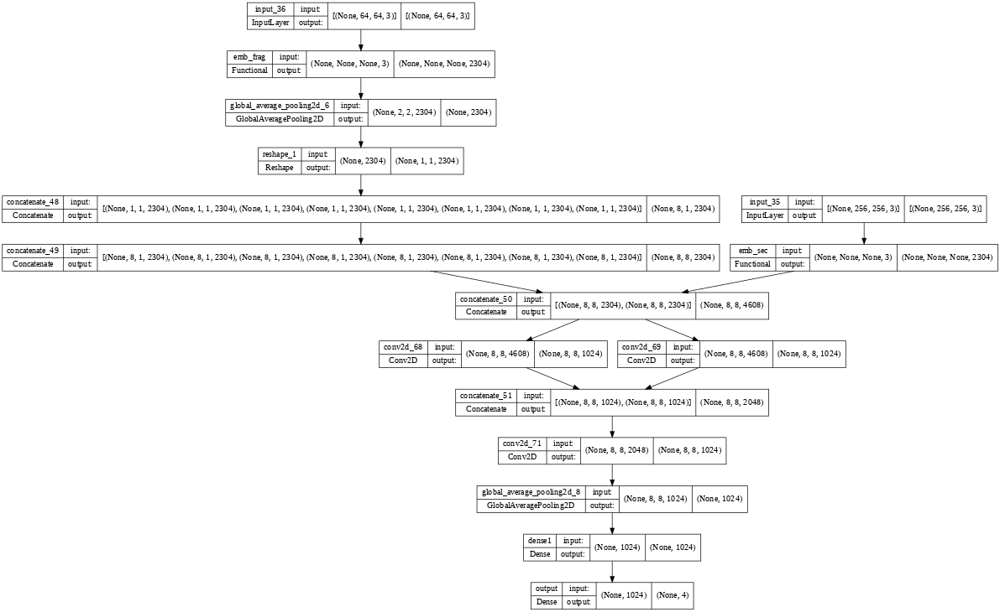

In [ ]:
from tensorflow.keras.utils import plot_model
plot_model(model_fin,show_shapes=True,dpi=50, show_layer_names=True)

In [ ]:
model_fin.summary()

Model: "model_21"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_36 (InputLayer)          [(None, 64, 64, 3)]  0           []                               
                                                                                                  
 emb_frag (Functional)          (None, None, None,   40960143    ['input_36[0][0]']               
                                2304)                                                             
                                                                                                  
 global_average_pooling2d_6 (Gl  (None, 2304)        0           ['emb_frag[3][0]']               
 obalAveragePooling2D)                                                                            
                                                                                           

### Тренировка НС

In [ ]:
def scheduler(epoch, lr):
   if epoch < 9:
     return lr
   else:
     return lr * exp(-0.1)

callback = LearningRateScheduler(scheduler)

In [ ]:
seed_everything(42)
model_fin.compile(loss='mse',
              optimizer=Adam(learning_rate=1e-3),
              metrics=['mae'])

In [ ]:
train_img.shape

(800, 224, 224, 3)

In [ ]:
# меняем размер подложки на 656
# img_656 = resize_image(original_image, width=656)
img_256 = resize_image(original_image, width=256)
print('размер подложки был -',original_image.shape, ', стал -', img_256.shape)

размер подложки был - (10496, 10496, 3) , стал - (256, 256, 3)


In [ ]:
train_img[-100:].shape

(100, 224, 224, 3)

In [ ]:
train_img_64 = np.array([resize_image(im, width=64) for im in train_img])

In [ ]:
hist = [[],[],[],[]]  # запись истории

step = 400 # сколько в train 
# img_656_lst = np.array([img_656 for _ in range(step)])
img_256_lst = np.array([img_256 for _ in range(step)])

for i in range(2):
  stop = step*(i+1)
  print('Обучаем модель EfficientNetB6. Данные', stop-step, '-', stop)


  # print('генерируем выборку: ', end='')
  # x_train, y_train = get_dataset(resized_img, dataset_size=500)
  # x_val, y_val = get_dataset(resized_img, dataset_size=200)
  # print('success!')

  store = model_fin.fit([img_256_lst[:], train_img_64[stop-step:stop]], train_xya[stop-step:stop],
                  epochs = 20,
                  batch_size = 10,
                  verbose = 1,
                  # validation_data = (x_val, y_val),
                  # validation_data = ([img_256_lst[-100:],train_img[-100:]], train_xya[-100:]),
                  callbacks=[callback]
                  )
  
  # print('predicted:',model.predict([x1_val, x2_val]))

##############################
# выводим результат предсказания
  # p = model_fin.predict(x_test)
  # points = np.int32(list(map(get_points,y_test)))
  # points_pred = np.int32(list(map(get_points,p)))

  # # print(points[0])
  # points[:,[2,3]] = points[:,[3,2]]
  # points_pred[:,[2,3]] = points_pred[:,[3,2]]
  # # tmp_img = resized_img.copy()
  # tmp_img = resize_image(resized_img, width=640)
  
  # for id in range(10):
  #   cv2.polylines(tmp_img, np.int32([points[id]]), 1, (0,0,255), thickness=2)
  #   cv2.circle(tmp_img,(int(y_test[id][0]*tmp_img.shape[1]),int(y_test[id][1]*tmp_img.shape[1])),3,(0,0,255))

  #   cv2.polylines(tmp_img, np.int32([points_pred[id]]), 1, (255,0,0), thickness=2)
  #   cv2.circle(tmp_img,(int(p[id][0]*tmp_img.shape[1]),int(p[id][1]*tmp_img.shape[1])),3,(255,0,0))

  #   pt1 = (int(p[id][0]*tmp_img.shape[1]),int(p[id][1]*tmp_img.shape[1]))
  #   pt2 = (int(y_test[id][0]*tmp_img.shape[1]),int(y_test[id][1]*tmp_img.shape[1]))
  #   color = (0, 255, 0)
  #   thickness=1

    # pt1 = (100, 100)
    # pt2 = (400, 350)

    # cv2.line(tmp_img, pt1, pt2,color,thickness)

  # cv2_imshow(resize_image(tmp_img, width=600))
  # cv2.imwrite(dir_home+'show_training/'+models_name[i]+'_img_pred.png', tmp_img)

  # del model

  # model.save('/content/drive/MyDrive/Aerophoto/weights/4/')
###########################

  # del x_train
  # del y_train

  # del x_val
  # del y_val

  # hist[0].extend(store.history['compute_metric_simp'])
  # hist[1].extend(store.history['val_compute_metric_simp'])
  hist[2].extend(store.history['loss'])
  # hist[3].extend(store.history['val_loss'])

  # plt.plot(hist[0], label='Обучающая')
  # plt.plot(hist[1], label='Проверочная')
  # plt.legend()
  # plt.title('Точность')
  # plt.show()
  plt.plot(hist[2], label='Обучающая')
  # plt.plot(hist[3], label='Проверочная')
  plt.legend()
  plt.title('Ошибка')
  plt.show()

try:
  sound()
  print('Executed')
except:
  print('Executed')

Обучаем модель EfficientNetB6. Данные 0 - 400
Epoch 1/20
40/40 [==============================] - 126s 722ms/step - loss: 1.3373 - mae: 0.5482 - lr: 0.0010
Epoch 2/20
40/40 [==============================] - 29s 727ms/step - loss: 0.1081 - mae: 0.2742 - lr: 0.0010
Epoch 3/20
40/40 [==============================] - 29s 718ms/step - loss: 0.1023 - mae: 0.2693 - lr: 0.0010
Epoch 4/20
40/40 [==============================] - 29s 720ms/step - loss: 0.1003 - mae: 0.2645 - lr: 0.0010
Epoch 5/20
40/40 [==============================] - 29s 724ms/step - loss: 0.1115 - mae: 0.2762 - lr: 0.0010
Epoch 6/20
40/40 [==============================] - 29s 721ms/step - loss: 0.1087 - mae: 0.2749 - lr: 0.0010
Epoch 7/20
40/40 [==============================] - 29s 721ms/step - loss: 0.1159 - mae: 0.2816 - lr: 0.0010
Epoch 8/20
40/40 [==============================] - 29s 723ms/step - loss: 0.1030 - mae: 0.2717 - lr: 0.0010
Epoch 9/20
40/40 [==============================] - 29s 723ms/step - loss: 0.1135

KeyboardInterrupt: ignored

In [ ]:
sound()

### Вариант с подложкой 2

Идея: после первой сетки надо предсказать смещение гляда на трейн и фрагмент подложки

In [ ]:
np.min(train_xya[:]-p[:]), np.max(train_xya[:]-p[:]), np.mean(train_xya[:]-p[:]), np.min(p[:,:2]), np.max(p[:,:2])

(-0.11712168193444972,
 0.07868365628747837,
 -0.0015205954117067893,
 0.106778465,
 1.0258446)

In [ ]:
# меняем размер подложки на 656 (для фрагмента 64)
img_656 = resize_image(original_image, width=656)
# img_256 = resize_image(original_image, width=256)
print('размер подложки был -',original_image.shape, ', стал -', img_656.shape)

размер подложки был - (10496, 10496, 3) , стал - (656, 656, 3)


In [ ]:
train_img_64 = np.array([resize_image(im, width=64) for im in train_img])

(720, 720, 3)


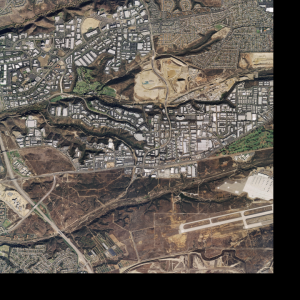

In [ ]:
# добавляем бордюр для случаев, когда фрагмент уходит за край
offset=64
z_img_left = np.zeros((img_656.shape[0],offset,3))
z_img_bott = np.zeros((offset,img_656.shape[1]+offset,3))
w_res_image = np.hstack([img_656,z_img_left])
# print(w_res_image.shape, z_img_bott.shape)
w_res_image = np.vstack([w_res_image,z_img_bott])
print(w_res_image.shape)

cv2_imshow(resize_image(w_res_image, width=300))

In [ ]:
z_img_64 = np.zeros((64,4,3)) # дубль

In [ ]:
img_656.shape[:2]

(656, 656)

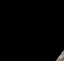

Ahtung! (61, 64, 3) 395 (90, 691) [0.13793832 1.0544637  0.20690264 0.11425674] [0.1858327  0.94412157 0.1786062  0.11697778]


array([ 0.04789438, -0.11034217, -0.02829644,  0.00272104])

In [ ]:
# создаем дубли из подложки для которых будем определять смещение dx, dy, dxa, dya
# функция возвращает дельту и фрагмент подложки
def get_fragment_for_train(tr_img, tr_xya, pr_xya):
  # print('средний score',np.mean(score), 'порог', threshold)

  dxya = tr_xya - pr_xya # смещение для сдвига тестового фрагмента в правильные координаты

  # вырезаем фрагмент по координатам центра и значению угла
  x, y, xa, ya = pr_xya
  x = int(x * img_656.shape[1])
  y = int(y * img_656.shape[0])
  ang = xy2ang(xa,ya)  
  fragment = subimage(image=w_res_image, center=(x, y), theta=ang, width=offset, height=offset, shp=img_656.shape[:2]) #w_res_image - это подложка с бордюром слева и снизу, offset=64
  cv2_imshow(fragment)
  if fragment.shape != (offset,offset,3):
    print('Ahtung!',fragment.shape, id, (x,y), pr_xya, tr_xya)
  # cv2_imshow(np.hstack([fragment,z_img_64, tr_img]))

  return fragment, dxya

id = 395
fragment, dxya = get_fragment_for_train(train_img_64[id], train_xya[id], p[id]) #p[id]
dxya


In [ ]:
train_frag[395].shape

(64, 64, 3)

In [ ]:
# сохраним, чтобы в след раз не конвертировать
import pickle

# pred_dump_file = '/content/drive/MyDrive/Aerophoto/'+'train_frag_64'

# with open(pred_dump_file, "wb") as fp:   #Pickling
#   pickle.dump(train_frag, fp)

# pred_dump_file = '/content/drive/MyDrive/Aerophoto/'+'train_img_64'

# with open(pred_dump_file, "wb") as fp:   #Pickling
#   pickle.dump(train_img_64, fp)

# pred_dump_file = '/content/drive/MyDrive/Aerophoto/'+'train_d_xya'

# with open(pred_dump_file, "wb") as fp:   #Pickling
#   pickle.dump(train_d_xya, fp)

In [ ]:
# загружаем результаты предсказания
import pickle

pred_dump_file = '/content/drive/MyDrive/Aerophoto/'+'train_frag_64'
with open(pred_dump_file, "rb") as fp:   # Unpickling
  train_frag = np.array(pickle.load(fp))
 
pred_dump_file = '/content/drive/MyDrive/Aerophoto/'+'train_img_64'
with open(pred_dump_file, "rb") as fp:   # Unpickling
  train_img_64 = pickle.load(fp)

pred_dump_file = '/content/drive/MyDrive/Aerophoto/'+'train_d_xya'
with open(pred_dump_file, "rb") as fp:   # Unpickling
  train_d_xya = np.array(pickle.load(fp))

# train_xya грузить не надо, он не меняется

train_frag.shape, train_img_64.shape, train_d_xya.shape

((800, 64, 64, 3), (800, 64, 64, 3), (800, 4))

In [ ]:
resized_img.shape, w_res_image.shape

((2294, 2294, 3), (720, 720, 3))

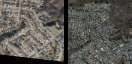

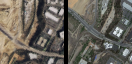

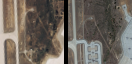

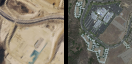

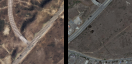

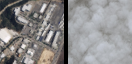

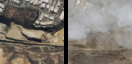

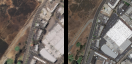

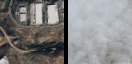

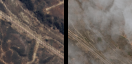

Ahtung! (61, 64, 3) 395 (90, 691) [0.13793832 1.0544637  0.20690264 0.11425674] [0.1858327  0.94412157 0.1786062  0.11697778]


In [ ]:
# готовим данные для обучения (сжирает память!)
train_frag, train_d_xya = [], []

for id, tr_im in enumerate(train_img_64[:]):
  fragment, dxya = get_fragment_for_train(tr_im, train_xya[id], p[id]) #p[id]
  train_frag.append(fragment)
  train_d_xya.append(dxya)

  # проверка
  if id<10:
    cv2_imshow(np.hstack([train_frag[id],z_img, train_img_64[id]]))

In [ ]:
len(train_frag)

800

In [ ]:
# обратное вычисление старого предсказания (из сохраненных dxya, чтобы не тратить время на сбор модли)
p_old = train_xya - train_d_xya

In [ ]:
p_old[:2]

array([[0.68650559, 0.92561559, 0.78887047, 0.89010593],
       [0.83514202, 0.91587871, 0.82680915, 0.155683  ]])

In [ ]:
train_xya[:2]

array([[0.68592797, 0.90343941, 0.77959645, 0.91451879],
       [0.81550114, 0.91249047, 0.84732919, 0.1403301 ]])

In [ ]:
# создаем список тренировочных пар
dxy_dataset_lst = []

for i in range(len(train_xya)):
  tmp_lst = []
  for j in range(len(train_xya)):
    tmp_lst.append(get_dxya(train_xya[i], p_old[j]))
    
  dxy_dataset_lst.append(tmp_lst)

In [ ]:
dxy_dataset_lst = np.array(dxy_dataset_lst)

In [ ]:
dxy_dataset_lst[1][0] # индексы: 1 - tr, 0 - p

array([ 0.12899555, -0.01312512,  0.05845871, -0.74977583])

In [ ]:
train_xya[ids_tr] - p_old[ids_fr]

array([[-0.0560295 , -0.30993524,  0.04909982, -0.0385964 ],
       [-0.11731388, -0.14737536, -0.49150985, -0.28787634]])

### Создаем НС которая будет искать смещения

In [ ]:
# входные размеры

sec_height = 64 # Высота подложки (2294) 10496/16=656
sec_width = 64 # Ширина подложки

frag_height = 64 # Высота фрагмента (224/2)
frag_width = 64 # Ширина фрагмента

chanels = 3 # Количество каналов  

input_sec_shape = (sec_height, sec_width, chanels)  # на этот вход подаем сектор

input_frag_shape = (frag_height, frag_width, chanels)  # на этот вход подаем фрагмент

In [ ]:
# базовая модель

# base_model = EfficientNetB2(weights="imagenet", include_top=False)  #([input_sec,input_frag])
base_model_2 = EfficientNetB6(weights="imagenet",  pooling="avg", include_top=False)  #([input_sec,input_frag])

model_2 = Model(inputs=base_model_2.input, outputs=base_model_2.output)

In [ ]:
embedding1 = Model(model_2.input, base_model_2.output, name='emb_sec')
embedding2 = Model(model_2.input, base_model_2.output, name='emb_frag')

In [ ]:
# векторы признаков

input_sec = Input(shape=input_sec_shape)

input_frag = Input(shape=input_frag_shape)

vec_sec = (embedding1(input_sec)) # вектор подложки
vec_frag = (embedding2(input_frag)) # вектор фрагмента

# preproc = efficientnet.preprocess_input(input_frag)

In [ ]:
vec_sec.shape, vec_frag.shape

(TensorShape([None, 2304]), TensorShape([None, 2304]))

In [ ]:
# vec_sec =Conv2D(256, kernel_size=(1, 1), activation="relu", padding="same")(vec_sec)
# vec_frag = Conv2D(256, kernel_size=(1, 1), activation="relu", padding="same")(vec_frag)

# vec_sec.shape, vec_frag.shape

(TensorShape([None, 2, 2, 256]), TensorShape([None, 2, 2, 256]))

In [ ]:
# объединяем карту фрагмента с картой подложки
concat = concatenate([vec_sec,vec_frag])
concat.shape

TensorShape([None, 4608])

In [ ]:
# fusion_module
def scale_block(inp, ch):
  scale_block1 = Conv2D(ch, kernel_size=(1, 1), activation="relu", padding="same")(inp)
  scale_block2 = Conv2D(ch, kernel_size=(3, 3), activation="relu", padding="same")(inp)

  return concatenate([scale_block1,scale_block2])


fusion_out = scale_block(concat, 512)

In [ ]:
# x = Conv2D(1024, kernel_size=(1, 1), activation="sigmoid", padding="same")(fusion_out)
# x = Conv2D(512, kernel_size=(3, 3), activation="relu", padding="same")(x)
# x = Conv2D(512, kernel_size=(3, 3), activation="relu", padding="same")(x)
# x = MaxPooling2D(2)(x)
# x = MaxPooling2D(2)(fusion_out)
# x = MaxPooling2D(2)(concat)
# x = GlobalAveragePooling2D()(x)
# x = Flatten()(fusion_out)
# x = Flatten()(concat)

x = Dense(1024, activation="relu", name="dense1")(concat)
x = Dense(256, activation="relu", name="dense2")(x)

output = (Dense(4, activation="linear", name="output")(x))  

In [ ]:
model_fin = Model([input_sec, input_frag], output) 

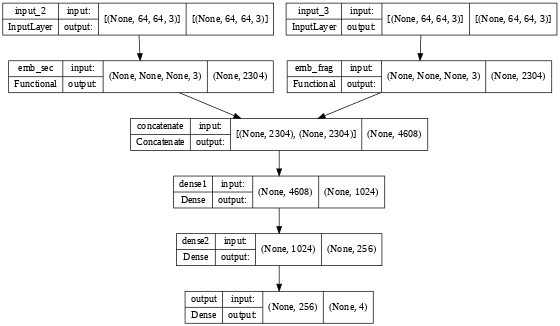

In [ ]:
from tensorflow.keras.utils import plot_model
plot_model(model_fin,show_shapes=True,dpi=50, show_layer_names=True)

In [ ]:
model_fin.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 64, 64, 3)]  0           []                               
                                                                                                  
 input_3 (InputLayer)           [(None, 64, 64, 3)]  0           []                               
                                                                                                  
 emb_sec (Functional)           (None, 2304)         40960143    ['input_2[0][0]']                
                                                                                                  
 emb_frag (Functional)          (None, 2304)         40960143    ['input_3[0][0]']                
                                                                                            

### Тренировка НС поиска смещения

In [ ]:
def loss_dxya():
    def loss(y_true: tf.Tensor, y_pred: tf.Tensor) -> tf.Tensor:
        # mse = K.square(y_pred-y_true)
        true_distance = K.sqrt((y_true[:,0])**2+(y_true[:,1])**2) # отклонение до предсказания 
        new_distance = K.sqrt((y_pred[:,0]-y_true[:,0])**2+(y_pred[:,1]-y_true[:,1])**2)  # отклонение после смещения на предсказанное расстояние
        # penalty = 0.1 # будем дополнительно штрафовать, если расстояние больше пересечения фрагментов
        # ls = K.minimum(distance, 0.1) * penalty
        # print(K.mean(mse)+K.mean(ls), '\n', K.mean(mse))
        # return K.mean(mse)+K.mean(ls)
        return K.mean(K.abs(true_distance-new_distance))
    return loss

# t1 = tf.constant(train_xya[:11])
# t2 = tf.constant(train_xya[1:12])

# my_loss_fn()(t1, t2)

def dxy_metric(y_true: tf.Tensor, y_pred: tf.Tensor) -> tf.Tensor:
    # mse = K.square(y_pred-y_true)
    true_distance = K.sqrt((y_true[:,0])**2+(y_true[:,1])**2) # отклонение до предсказания 
    new_distance = K.sqrt((y_pred[:,0]-y_true[:,0])**2+(y_pred[:,1]-y_true[:,1])**2)  # отклонение после смещения на предсказанное расстояние
    # penalty = 0.1 # будем дополнительно штрафовать, если расстояние больше пересечения фрагментов
    # ls = K.minimum(distance, 0.1) * penalty
    # print(K.mean(mse)+K.mean(ls), '\n', K.mean(mse))
    # return K.mean(mse)+K.mean(ls)
    return K.mean(true_distance-new_distance)

In [ ]:
checkpoint_filepath = '/content/drive/MyDrive/Aerophoto/fin_weights/cp_2/'
model_checkpoint_callback = ModelCheckpoint(
    filepath=checkpoint_filepath,
    save_weights_only=True,
    monitor='loss',
    mode='min',
    save_best_only=True)

In [ ]:
def scheduler(epoch, lr):
   if epoch < 9:
     return lr
   else:
     return lr * exp(-0.1)

callback = LearningRateScheduler(scheduler)

In [ ]:
seed_everything(42)
model_fin.compile(loss='mse',
              optimizer=Adam(learning_rate=1e-3),
              metrics=[dxy_metric])

Обучаем модель EfficientNetB6 0
Epoch 1/100
60/60 [==============================] - 58s 303ms/step - loss: 0.2118 - dxy_metric: -0.0746 - val_loss: 0.1608 - val_dxy_metric: -0.0210 - lr: 0.0010
Epoch 2/100
60/60 [==============================] - 11s 190ms/step - loss: 0.1467 - dxy_metric: 0.0184 - val_loss: 0.1566 - val_dxy_metric: 6.1427e-04 - lr: 0.0010
Epoch 3/100
60/60 [==============================] - 13s 219ms/step - loss: 0.1314 - dxy_metric: 0.0613 - val_loss: 0.1678 - val_dxy_metric: -0.0080 - lr: 0.0010
Epoch 4/100
60/60 [==============================] - 12s 195ms/step - loss: 0.1201 - dxy_metric: 0.0870 - val_loss: 0.1476 - val_dxy_metric: 0.0028 - lr: 0.0010
Epoch 5/100
60/60 [==============================] - 12s 194ms/step - loss: 0.1078 - dxy_metric: 0.1266 - val_loss: 0.1777 - val_dxy_metric: -0.0250 - lr: 0.0010
Epoch 6/100
60/60 [==============================] - 12s 194ms/step - loss: 0.0996 - dxy_metric: 0.1378 - val_loss: 0.1709 - val_dxy_metric: -0.0195 - lr: 

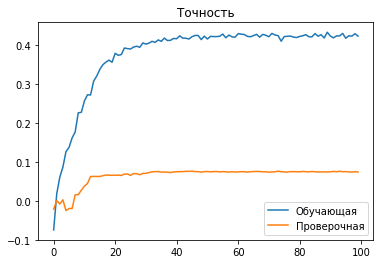

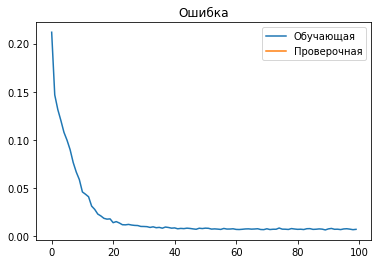

Executed


In [ ]:
hist = [[],[],[],[]]  # запись истории


for i in range(1):
  print('Обучаем модель EfficientNetB6', i)


  store = model_fin.fit([train_img_64[:600], train_frag[:600]], train_d_xya[:600]*20,
                  epochs = 100,
                  batch_size = 10,
                  verbose = 1,
                  # validation_data = (x_val, y_val),
                  validation_data = ([train_img_64[600:],train_frag[600:]], train_d_xya[600:]*20),
                  callbacks=[callback]
                  )
  
  # print('predicted:',model.predict([x1_val, x2_val]))

##############################
  # model.save('/content/drive/MyDrive/Aerophoto/weights/4/')
###########################


  hist[0].extend(store.history['dxy_metric'])
  hist[1].extend(store.history['val_dxy_metric'])
  hist[2].extend(store.history['loss'])
  hist[3].extend(store.history['val_loss'])

  plt.plot(hist[0], label='Обучающая')
  plt.plot(hist[1], label='Проверочная')
  plt.legend()
  plt.title('Точность')
  plt.show()
  plt.plot(hist[2], label='Обучающая')
  plt.plot(hist[3], label='Проверочная')
  plt.legend()
  plt.title('Ошибка')
  plt.show()

try:
  sound()
  print('Executed')
except:
  print('Executed')

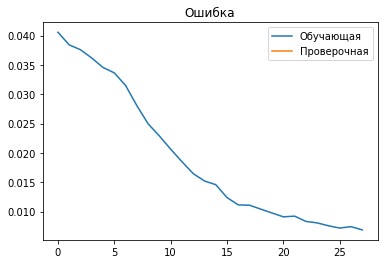

In [ ]:
  # plt.plot(hist[0], label='Обучающая')
  # plt.plot(hist[1], label='Проверочная')
  # plt.legend()
  # plt.title('Точность')
  # plt.show()
  plt.plot(hist[2][2:], label='Обучающая')
  plt.plot(hist[3][2:], label='Проверочная')
  plt.legend()
  plt.title('Ошибка')
  plt.show()

In [ ]:
model_fin.save('/content/drive/MyDrive/Aerophoto/fin_weights/8/') # 20.07 

INFO:tensorflow:Assets written to: /content/drive/MyDrive/Aerophoto/fin_weights/8/assets


INFO:tensorflow:Assets written to: /content/drive/MyDrive/Aerophoto/fin_weights/8/assets


**перекрестная тренировка**

In [ ]:
# алгоритм
# 
# tr_img, fr_img - массивы изорбражений размером 64
def get_dxy_dataset(tr_img, fr_img, tr_xya, fr_xya, ds_size=100):
  ids_tr = np.random.randint(0, high=len(tr_img), size=ds_size)
  ids_fr = np.random.randint(0, high=len(fr_img), size=ds_size)
  return ids_tr, ids_fr, tr_xya[ids_tr]-fr_xya[ids_fr]


ids_tr, ids_fr, Y_dxya = get_dxy_dataset(train_img_64, train_frag, train_xya, p_old, ds_size=2)

In [ ]:
ids_tr, ids_fr, Y_dxya

(array([241, 155]),
 array([ 31, 678]),
 array([[-0.11015902,  0.13912007, -0.78353473, -0.19309933],
        [-0.10281388,  0.27073626,  0.01514085,  0.09335948]]))

In [ ]:
train_xya[ids_tr], p_old[ids_fr]

(array([[0.25404916, 0.416492  , 0.89400538, 0.80783074],
        [0.77434261, 0.75347752, 0.04322727, 0.70336832]]),
 array([[0.31007866, 0.72642723, 0.84490556, 0.84642714],
        [0.89165649, 0.90085287, 0.53473712, 0.99124466]]))

In [ ]:
ids_tr, ids_fr, Y_dxya = get_dxy_dataset(train_img_64, train_frag, train_xya, p_old, ds_size=20)

In [ ]:
ids_tr, ids_fr, Y_dxya

(array([345,  19]),
 array([320, 582]),
 array([[-0.32305606,  0.69882866, -0.43347541,  0.01659778],
        [-0.15925318, -0.53483773, -0.44135393,  0.46759357]]))

In [ ]:
train_xya[:2]

array([[0.68592797, 0.90343941, 0.77959645, 0.91451879],
       [0.81550114, 0.91249047, 0.84732919, 0.1403301 ]])

In [ ]:
np.mean(np.square(Y_dxya[:-15]-Y_dxya[15:]))

0.1920504033902415

In [ ]:
np.mean(np.square(train_d_xya[:-100]-train_d_xya[100:]))

0.0007625219781107795

In [ ]:
len(Y_dxya[(np.abs(Y_dxya[:,0]) < 0.006)])

8237

In [ ]:
mask_min = np.abs(Y_dxya[:,0]) < 0.006

In [ ]:
680*800/50

10880.0

In [ ]:
def loss_dxya2():
    def loss(y_true: tf.Tensor, y_pred: tf.Tensor) -> tf.Tensor:
        mse = K.square((y_pred-y_true)/y_true)
        # true_distance = K.sqrt((y_true[:,0])**2+(y_true[:,1])**2) # отклонение до предсказания 
        # new_distance = K.sqrt((y_pred[:,0]-y_true[:,0])**2+(y_pred[:,1]-y_true[:,1])**2)  # отклонение после смещения на предсказанное расстояние
        # penalty = 0.1 # будем дополнительно штрафовать, если расстояние больше пересечения фрагментов
        # ls = K.minimum(distance, 0.1) * penalty
        # print(K.mean(mse)+K.mean(ls), '\n', K.mean(mse))
        # return K.mean(mse)+K.mean(ls)
        return K.mean(mse)
    return loss

In [ ]:
seed_everything(42)
# model_fin = Model([input_sec, input_frag], output) 
model_fin.compile(loss=[loss_dxya2()],
              optimizer=Adam(learning_rate=1e-4),
              metrics=['mse',dxy_metric])

In [ ]:
hist = [[],[],[],[]]  # запись истории

ids_tr, ids_fr, Y_dxya = get_dxy_dataset(train_img_64[:680], train_frag[:800], train_xya[:680], p_old[:800], ds_size=680*800)
step = 1000

# ids_tr, ids_fr, Y_dxya = ids_tr[mask_min], ids_fr[mask_min], Y_dxya[mask_min]

for i in range(10):
  print('Обучаем модель EfficientNetB6, с валидацией', i,'\nинтервал c', i*step,'по',i*step+step)
  


  store = model_fin.fit([train_img_64[ids_tr[i*step:i*step+step]], train_frag[ids_fr[i*step:i*step+step]]], Y_dxya[i*step:i*step+step],
  # store = model_fin.fit([train_img_64[680:],train_frag[680:]], train_xya[680:]-p_old[680:],
                  epochs = 20,
                  batch_size = 20,
                  verbose = 1,
                  # validation_data = (x_val, y_val),
                  validation_data = ([train_img_64[680:],train_frag[680:]], train_xya[680:]-p_old[680:]),
                  # callbacks=[callback]
                  )
  
  # print('predicted:',model.predict([x1_val, x2_val]))

##############################
  # model.save('/content/drive/MyDrive/Aerophoto/weights/4/')
###########################


hist[0].extend(store.history['dxy_metric'])
hist[1].extend(store.history['val_dxy_metric'])
hist[2].extend(store.history['loss'])
hist[3].extend(store.history['val_loss'])

plt.plot(hist[0], label='Обучающая')
plt.plot(hist[1], label='Проверочная')
plt.legend()
plt.title('Точность')
plt.show()
plt.plot(hist[2], label='Обучающая')
plt.plot(hist[3], label='Проверочная')
plt.legend()
plt.title('Ошибка')
plt.show()

try:
  sound()
  print('Executed')
except:
  print('Executed')

Обучаем модель EfficientNetB6, с валидацией 0 
интервал c 0 по 1000
Epoch 1/20
50/50 [==============================] - 101s 356ms/step - loss: 402.9138 - mse: 0.1755 - dxy_metric: -9.3175e-07 - val_loss: 261.5518 - val_mse: 6.3320e-04 - val_dxy_metric: -3.6344e-05
Epoch 2/20
50/50 [==============================] - 11s 221ms/step - loss: 372.7513 - mse: 0.1755 - dxy_metric: -6.0899e-06 - val_loss: 237.9806 - val_mse: 6.2132e-04 - val_dxy_metric: -7.2647e-06
Epoch 3/20
50/50 [==============================] - 11s 227ms/step - loss: 340.4243 - mse: 0.1754 - dxy_metric: -4.1146e-06 - val_loss: 215.0183 - val_mse: 6.0948e-04 - val_dxy_metric: -3.5501e-05
Epoch 4/20
50/50 [==============================] - 11s 226ms/step - loss: 310.2940 - mse: 0.1754 - dxy_metric: -9.5066e-07 - val_loss: 195.5211 - val_mse: 5.9842e-04 - val_dxy_metric: -4.0121e-05
Epoch 5/20
50/50 [==============================] - 11s 224ms/step - loss: 284.0711 - mse: 0.1754 - dxy_metric: 6.4314e-07 - val_loss: 177.4386

In [ ]:
model_fin.save('/content/drive/MyDrive/Aerophoto/fin_weights/9_cross/') # 20.07 

In [ ]:
# обратное вычисление старого предсказания
p_old = train_xya - train_d_xya

In [ ]:
# score был веса 
data = list(zip(train_xya[600:],p_old[600:]))

score = sum([compute_metric_simp(d[0], d[1]) for d in data])/len(data)
score

0.9872858633434146

In [ ]:
d_xya = model_fin.predict([train_img_64[600:],train_frag[600:]])

In [ ]:
# score стал
p_new = p_old[600:] + d_xya/20

In [ ]:
data = list(zip(train_xya[600:],p_new))

score = sum([compute_metric_simp(d[0], d[1]) for d in data])/len(data)
score

0.9890459359401557

In [ ]:
# веса в 7a_2
score = sum([compute_metric_simp(d[0], d[1]) for d in data])/len(data)
score

0.9866478501336238

In [ ]:
# веса в 7a
score = sum([compute_metric_simp(d[0], d[1]) for d in data])/len(data)
score

0.9870288064389097

# Предсказания для загрузки на портал

In [ ]:
model.load_weights('/content/drive/MyDrive/Aerophoto')  # загружаем веса

In [ ]:
train_xya[0], train_ang[0]

(array([0.15553544, 0.93888148, 0.99878203, 0.46512176]), 356)

In [ ]:
# преобразуем x и y координаты в угол
def xy2ang(xa,ya):
  a_cos, a_sin = (xa-0.5)*2, (ya-0.5)*2
  angle = np.arctan2(a_sin,a_cos)*180/pi
  if angle < 0: angle += 360
  return angle  #угол в градусах

xy2ang(*train_xya[6][2:]), 

(0.9999999999999976,)

In [ ]:
# !!! повтор выше !!!
def compute_metric_simp(data_true, data_pred, outImageW = org_shape[1], outImageH = org_shape[0]):

  x_center_true = data_true[0]
  y_center_true = data_true[1]

  x_metr = x_center_true - data_pred[0]
  y_metr = y_center_true - data_pred[1] 

  angle_true = xy2ang(data_true[2], data_true[3])
  angle_pred = xy2ang(data_pred[2], data_pred[3])

  # print('x_metr, y_metr:', x_metr, y_metr, '\nangle_true, angle_pred:', angle_true, angle_pred)
  # print()

  metr =  1- (0.7 * 0.5 * (abs(x_metr) + abs(y_metr)) + 0.3 *min(abs(angle_true - angle_pred), abs(abs(angle_true - angle_pred)-360))/360)
  return metr

compute_metric_simp(train_xya[0], train_xya[6])

0.7917981453252032

In [ ]:
train_xya[6], train_ang[6]

(array([0.39181593, 0.76814977, 0.99627308, 0.43906533]), 353)

In [ ]:
train_xya[0]

array([0.31559642, 0.86209032, 0.05449674, 0.72699525])

In [ ]:
model.load_weights('/content/drive/MyDrive/Aerophoto/checkpoint/weight/')

In [ ]:
# тест на реальных данных
p = model.evaluate(train_img[:], train_xya[:])

**проверка на своих данных**

In [ ]:
p_test = model.predict(x_test[:])

In [ ]:
data = list(zip(y_test,p_test))

In [ ]:
# прошлый
score = sum([compute_metric_simp(d[0], d[1]) for d in data])/len(data)
score

0.9916627571609301

In [ ]:
len(data)

100

**проверка на тренировочных данных**

In [ ]:
p = model.predict(train_img[:])

In [ ]:
data = list(zip(train_xya,p))

In [ ]:
# веса в 7a_2
score = sum([compute_metric_simp(d[0], d[1]) for d in data])/len(data)
score

0.9866478501336238

In [ ]:
# веса в 7a
score = sum([compute_metric_simp(d[0], d[1]) for d in data])/len(data)
score

0.9870288064389097

In [ ]:
# новый B7 loss mae 0.0120
score = sum([compute_metric_simp(d[0], d[1]) for d in data])/len(data)
score

0.9946166987662991

In [ ]:
# EfB6 с Score 93.4
score = sum([compute_metric_simp(d[0], d[1]) for d in data])/len(data)
score

0.9903321538912606

In [ ]:
train_xya[i:i+1]

array([[0.50938453, 0.18973895, 0.71130913, 0.04684611]])

In [ ]:
p_img[:1]

array([[0.53157115, 0.20241848, 0.77283186, 0.07037923]], dtype=float32)

### Исследуем на чем падает скор

In [ ]:
z_img[:,:,0].shape

(224, 4)

score 0.9877170057029271
score 0.9974965676121289
score 0.9721262707296612
Фрагменты id = 9


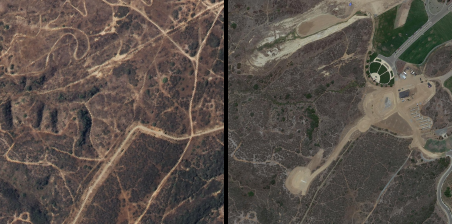

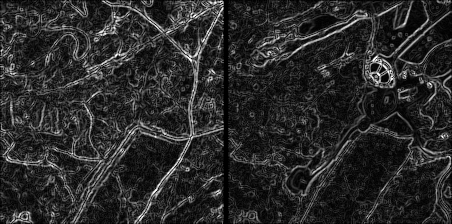

score 0.9851300187933446
score 0.9932022597179319
score 0.9904881405799418
score 0.9904064989515373
score 0.9920628455618422
score 0.9915145091683389
score 0.9900478100175693
score 0.9890669667324978
score 0.9810082063909595
score 0.9911294514642517
score 0.9902932911152481
score 0.9954172319042308
score 0.9887742834919246
score 0.9887301066408927
score 0.9981673514101097
score 0.9930414615293174
score 0.9902428829345906
score 0.9858630716357214
score 0.9835729363854165
score 0.9933640715914467
score 0.991067797493171
score 0.9840131299130945
score 0.9831567390352445
score 0.9854068648479193
score 0.9957136043698264
score 0.9917512054836704
score 0.9964416289728768
score 0.9887107944362677
score 0.9863220222836689
score 0.9904850298383118
score 0.9972304621646401
score 0.98662786443679
score 0.989282340764962
score 0.9851288887261008
score 0.9867734389571435
score 0.9903888713773562
score 0.9938555269122372
score 0.9883437261451429
score 0.9932694379712268
score 0.9705883195284508
Фраг

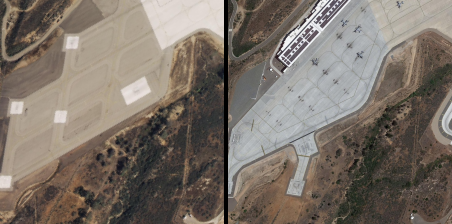

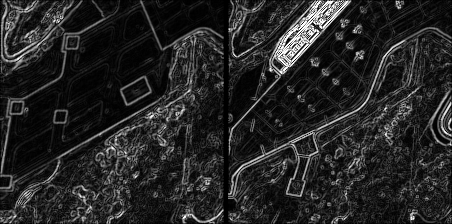

score 0.9953894992587422
score 0.9900019263482056
score 0.9825463721612694
score 0.9742575726721188
Фрагменты id = 9


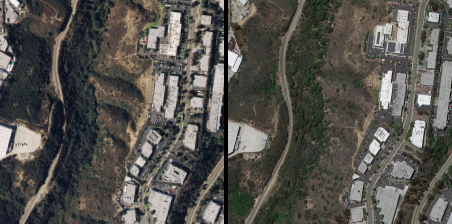

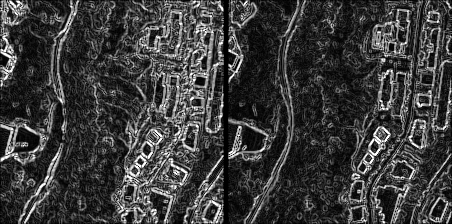

score 0.9862437932925652
score 0.9947144504109053
score 0.986677684446707
score 0.99254574342184
score 0.9950045345191613
score 0.9928586781715122
score 0.9888709593376082
score 0.9880132472177307
score 0.9980825944885349
score 0.9905336113355768
score 0.9794054038647816
Фрагменты id = 9


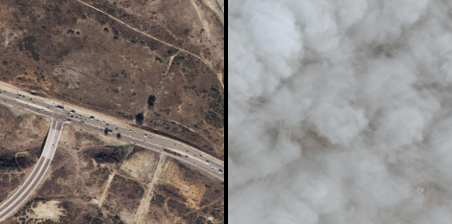

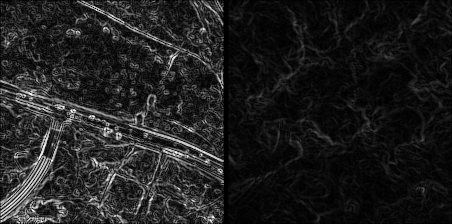

score 0.9988786251228476
score 0.9905407479361263
score 0.9917577526949501
score 0.9859157762019553
score 0.9934195735824923
score 0.9888314116095074
score 0.9841889417357629
score 0.989276712900848
score 0.9962942196273697
score 0.9887114349425616
score 0.9905124760357451
score 0.9918930148735323
score 0.9924685445948934
score 0.9851001795119696
score 0.9946646231959715
score 0.9896879326410454
score 0.9949307839811324
score 0.994825386021982
score 0.9925264680640719
score 0.991642560921079
score 0.9936068854831436
score 0.9870582747553082
score 0.9970006832984029
score 0.9937850325445976
score 0.9720885428832623
Фрагменты id = 9


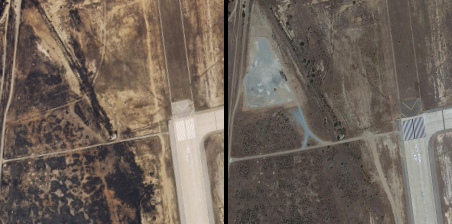

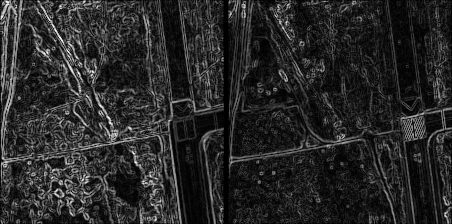

score 0.9833715648054014
score 0.9915935331593251
score 0.9909559212506456
score 0.9857844982246606
score 0.9900291278216001
score 0.9952802083355388
score 0.9885169702818822
score 0.9944537879863489
score 0.9922346357738889
score 0.9823696700513848
score 0.9946886783360428
score 0.9950026309095746
score 0.9871226978221218
score 0.9869284581095935
score 0.9830969344043432
score 0.9950192018300908
score 0.9865095049879216
score 0.9923370950793615
score 0.9824264604221962
score 0.9908445979529135
score 0.9895024994697784
score 0.9884083730362252
score 0.9910093560604639
score 0.9821994523095288
score 0.9877606132459409
score 0.9857702247442558
score 0.9867830060786486
score 0.9933679813149554
score 0.9917354788673466
score 0.9962416203039488
score 0.9936072724248938
score 0.9949243974142192
score 0.9934083299333217
score 0.9975852925736466
score 0.988502733831565
score 0.9813649322889475
score 0.9741370269083557
Фрагменты id = 9


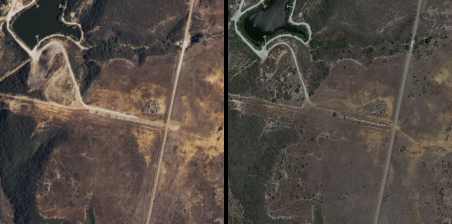

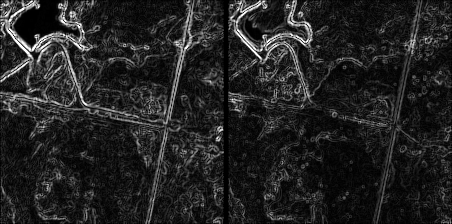

score 0.988403363650034
score 0.9886456040097971
score 0.9797056891622095
Фрагменты id = 9


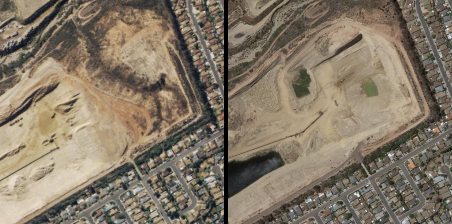

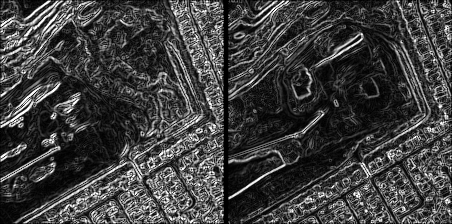

score 0.9882985085813719
score 0.9920285773950279
score 0.9845437668283067
score 0.9933328862529087
score 0.9887172142142022
score 0.985872706758036
score 0.9864469713950768
score 0.9879028809516825
score 0.9902916468286874
score 0.9936474997803626
score 0.9905752535451022
score 0.9920090877127493
score 0.9825959425264416
score 0.9764036431437949
Фрагменты id = 9


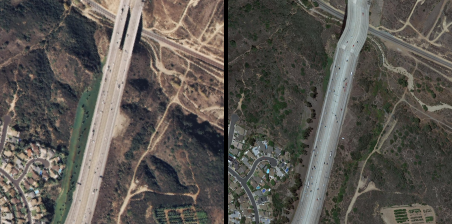

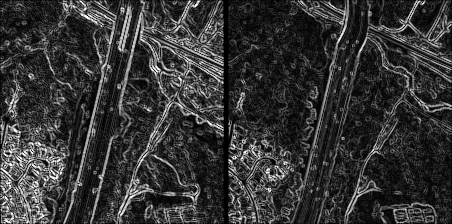

score 0.9690695146028527
Фрагменты id = 9


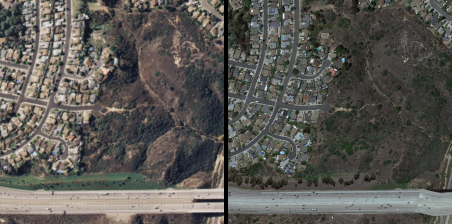

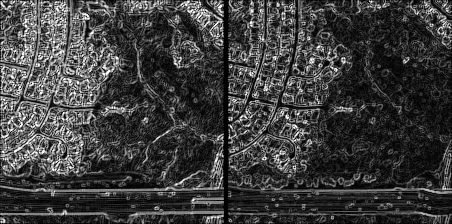

score 0.9875189720147344
score 0.9933438635756866
score 0.9930897728232135
score 0.9803558472128844
score 0.9963149817077542
score 0.9900729093113589
score 0.9881314648953669
score 0.9913180919600058
score 0.9834425834983984
score 0.9910821424141701
score 0.9937626548002848
score 0.9835529687247089
score 0.9925681339854495
score 0.9914185370352946
score 0.9927424326345098
score 0.9848529333714313
score 0.9917274433240899
score 0.993864856241116
score 0.9929010659571457
score 0.9835635875516977
score 0.9891456169731939
score 0.9860239587504323
score 0.9912437540043576
score 0.9847513939409176
score 0.9883283641883486
score 0.9829942432852619
score 0.9980514639901553
score 0.9858438443402132
score 0.985787786734421
score 0.9866146056698762
score 0.9824359086352014
score 0.9828180829864869
score 0.992858671926342
score 0.9930390662601104
score 0.9796877382416846
Фрагменты id = 9


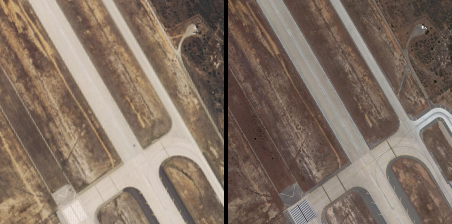

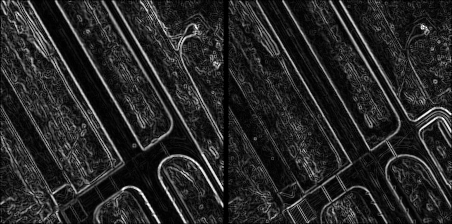

score 0.9904932857290434
score 0.9899101708675593
score 0.9900951423670747
score 0.9942932310239816
score 0.9958900900651126
score 0.9793341863091942
Фрагменты id = 9


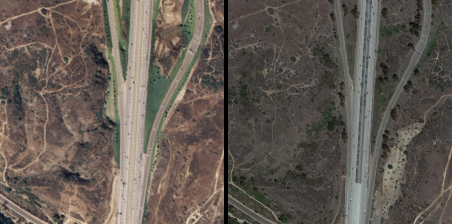

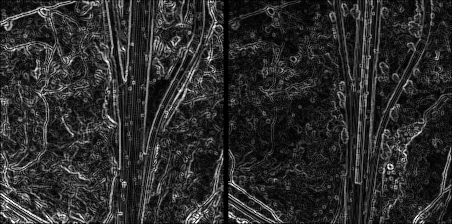

score 0.9908507026787201
score 0.9876451360082582
score 0.9849560425862102
score 0.9899179767184282
score 0.9923971768792921
score 0.9787760969933783
Фрагменты id = 9


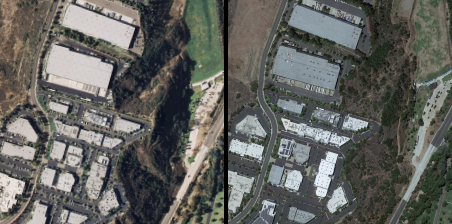

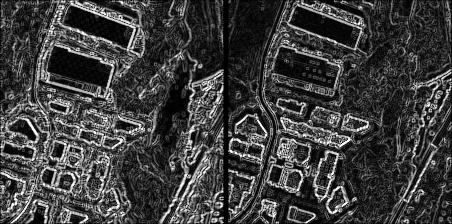

score 0.9928820304779222
score 0.9966368379534811
score 0.98435328445934
score 0.9844336814489668
score 0.995721395952888
score 0.9912469035545093
score 0.9870182536967343
score 0.9936125738837353
score 0.9823031220847419
score 0.9802565807183014
score 0.9900484426867767
score 0.9925223535393376
score 0.9751337573051897
Фрагменты id = 9


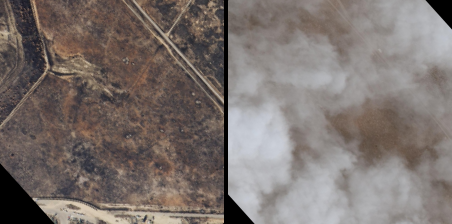

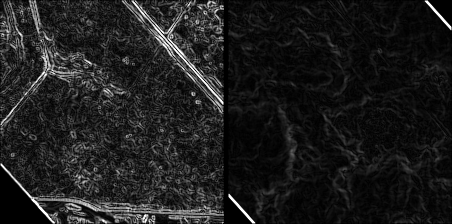

score 0.9660148208221885
Фрагменты id = 9


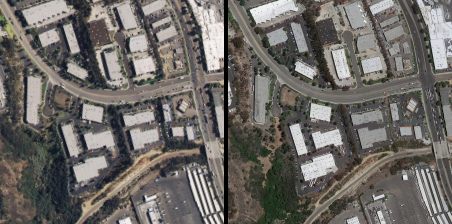

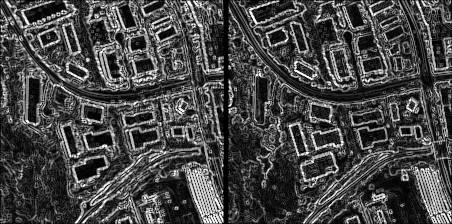

score 0.975789728358043
Фрагменты id = 9


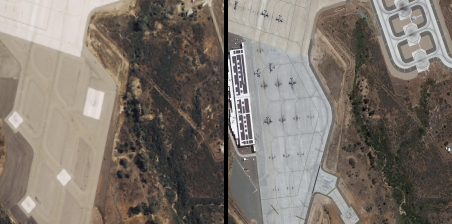

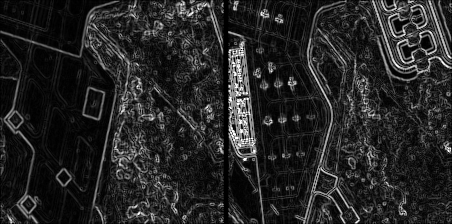

score 0.9915367458399497
score 0.9963253673360744
score 0.9912533926059977
score 0.9918723215726353
score 0.9872054031577687
score 0.9901406803697738
score 0.9948786379294672
score 0.9914491117145993
score 0.9919559342262962
score 0.9933303898661744
score 0.9973277796036824
score 0.9860688529409473
score 0.9898179725438015
score 0.9927795283377998
score 0.9956821697231616
score 0.994385910119438
score 0.993812250240947
score 0.984931311418788
score 0.9758720166591065
Фрагменты id = 9


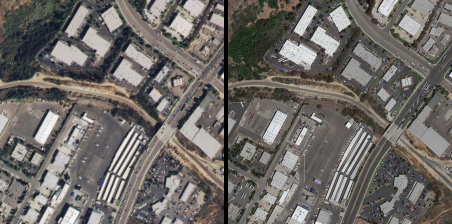

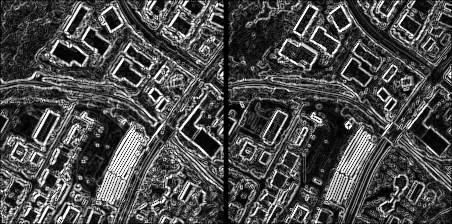

score 0.9937126211028966
score 0.9883309165953721
score 0.9913355670268139
score 0.9842355256150201
score 0.9868226579967907
score 0.9922285511648928
score 0.990325053306395
score 0.9889328702809187
score 0.9922914683910928
score 0.9915365950410647
score 0.9877320459336056
score 0.9874118297396642
score 0.9748746104161427
Фрагменты id = 9


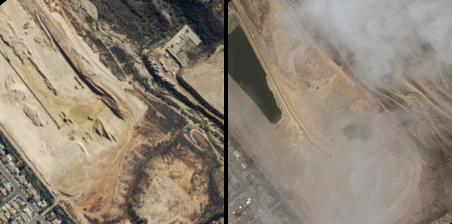

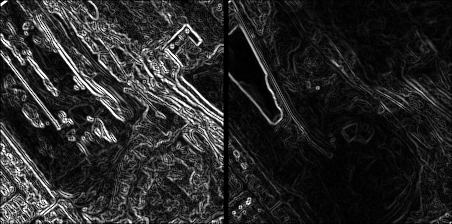

score 0.9798668286869832
Фрагменты id = 9


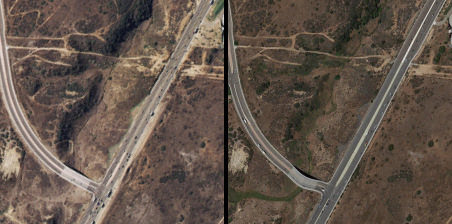

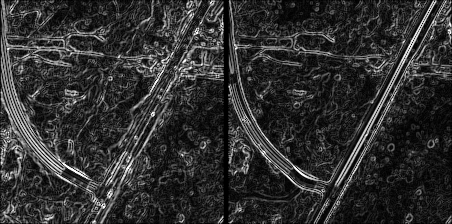

score 0.9886342608237897
score 0.9959884258352139
score 0.9908149742014547
score 0.9952345971843608
score 0.9839256993937019
score 0.9927811753073399
score 0.9927754488859878
score 0.9935197497940506
score 0.9878367290488413
score 0.9884450110418124
score 0.9873319980005352
score 0.99441409901712
score 0.9871076327647318
score 0.995661500880901
score 0.9896979666815167
score 0.9860347430999679
score 0.9860640494759754
score 0.9924239062718251
score 0.9924530431802839
score 0.9845074734333853
score 0.9958229737733658
score 0.9898593045724893
score 0.9954558291970482
score 0.9909387661138569
score 0.98297247840645
score 0.9958894150207522
score 0.9949624974307008
score 0.9882835537904952
score 0.9955477446324161
score 0.9897058795527466
score 0.984537435203782
score 0.9944280465775652
score 0.9863109415830787
score 0.9874901610079142
score 0.9878023691756744
score 0.9891434369132175
score 0.9802880945842646
score 0.9893968883177573
score 0.9943630934578909
score 0.9935399632430946
score 

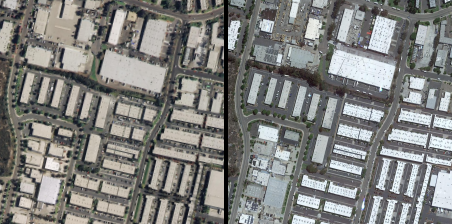

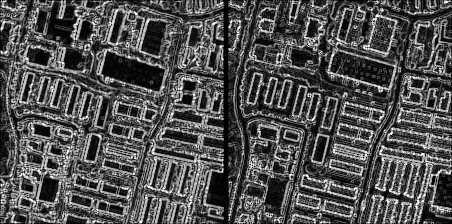

score 0.9897655018397072
score 0.9965194930341056
score 0.9713326125460902
Фрагменты id = 9


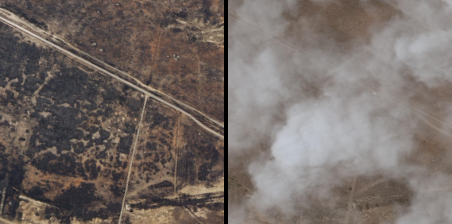

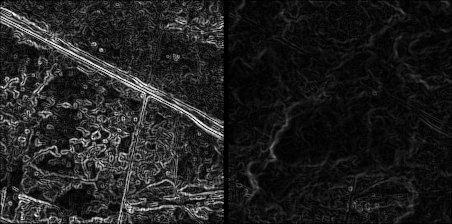

score 0.9814615351429659
score 0.9912362401414201
score 0.9881368137141341
score 0.9877795173404709
score 0.9887231243253097
score 0.9937147794803975
score 0.9798307051938059
Фрагменты id = 9


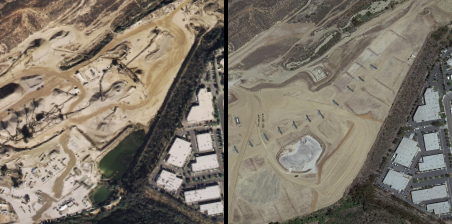

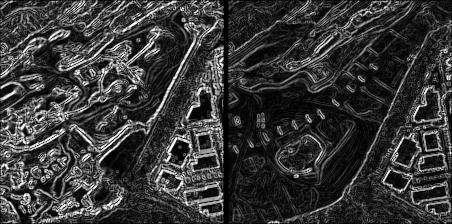

score 0.9878170899315428
score 0.9775263524632971
Фрагменты id = 9


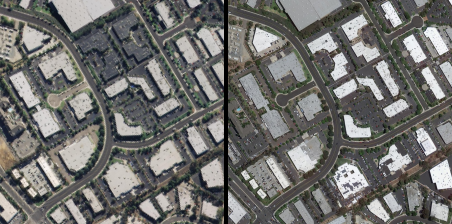

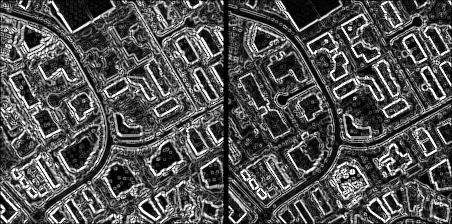

score 0.9874613928358875
score 0.9922174175172231
score 0.9892961588727769
score 0.991863474305537
score 0.984076807708875
score 0.9860170981168324
score 0.9888186815967248
score 0.9939868939678872
score 0.9958808942434715
score 0.9939963178409547
score 0.9968077936854699
score 0.9800670217064631
score 0.9904391296358438
score 0.9857301266777307
score 0.990966231890828
score 0.9910656672185815
score 0.9871348595799097
score 0.9914191524804953
score 0.9895964922543932
score 0.9827225775340975
score 0.9950310171729542
score 0.9779354933651823
Фрагменты id = 9


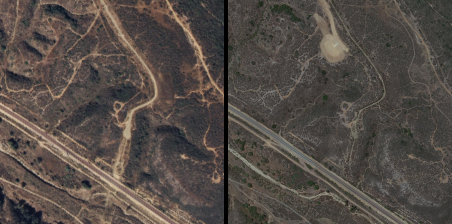

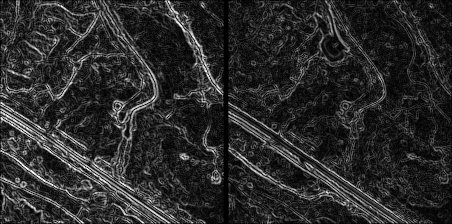

score 0.9788724983530788
Фрагменты id = 9


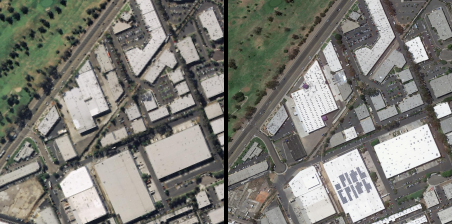

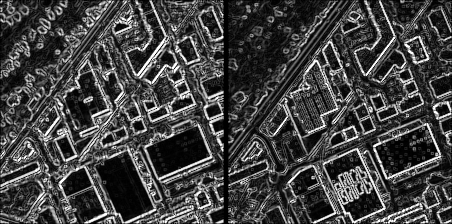

score 0.9904737417756772
score 0.9863011871312458
score 0.9939989435930932
score 0.9740767438050844
Фрагменты id = 9


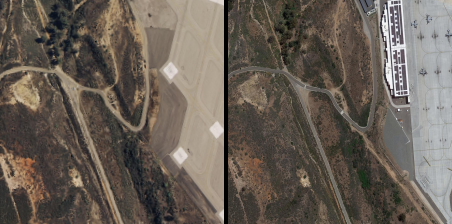

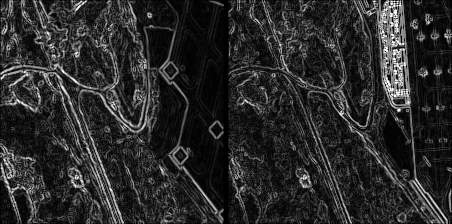

score 0.9931059435249746
score 0.9884001783676022
score 0.9942282806896947
score 0.9857425656313049
score 0.9897296813842998
score 0.9949699022538082
score 0.9787992909594229
Фрагменты id = 9


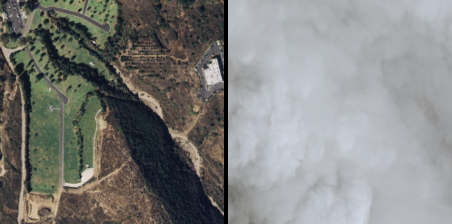

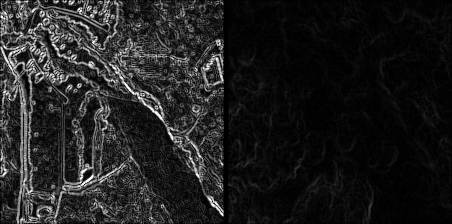

score 0.9948100711206722
score 0.989663704301339
score 0.992096525976363
score 0.9866165517145216
score 0.989781651006891
score 0.9595649095207903
Фрагменты id = 9


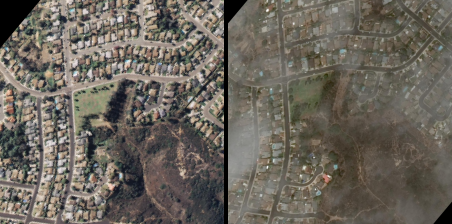

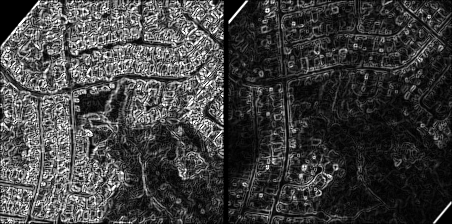

score 0.9941845752335948
score 0.9937665548327006
score 0.9860200985557328
score 0.983481755715651
score 0.9819093648394868
score 0.9955412048671032
score 0.9847194441612468
score 0.9941611980836349
score 0.9916378076465983
score 0.9924627023823828
score 0.9886738750420659
score 0.9852436397820206
score 0.9903654557842785
score 0.9930827327362851
score 0.9854160046743721
score 0.9933522022494824
score 0.9884933008825462
score 0.9624641896848382
Фрагменты id = 9


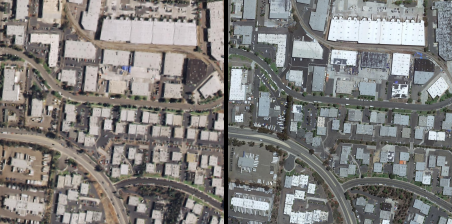

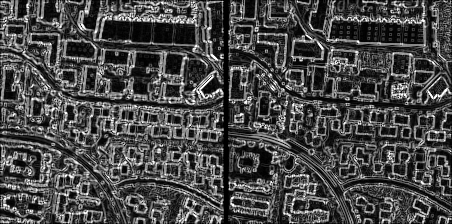

score 0.9920601793341902
score 0.9899880291049576
score 0.9913111987489767
score 0.9960821234029603
score 0.9899073063906685
score 0.9885452529332869
score 0.9891588070105617
score 0.9870524150847264
score 0.9831660527567544
score 0.9953379490109843
score 0.9862618095490925
score 0.9954408567652571
score 0.989820579195195
score 0.9873233944429888
score 0.9929455910390591
score 0.9928814377794409
score 0.9865328991090399
score 0.995290543107828
score 0.9796358074501808
Фрагменты id = 9


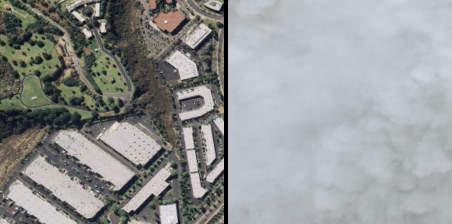

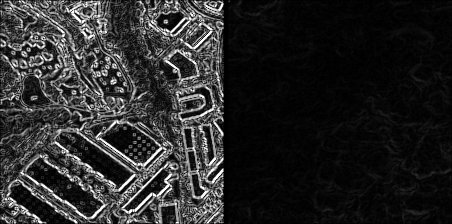

score 0.9862063714370141
score 0.9816875560740678
score 0.9928494720483617
score 0.9871937174615464
score 0.9900098121581093
score 0.9985453518737218
score 0.9951740293503559
score 0.995763276036051
score 0.9909215661402967
score 0.9928551261411867
score 0.9918740817315882
score 0.9875651626132214
score 0.99515988935952
score 0.992811177011253
score 0.9913731504198026
score 0.9949546757511482
score 0.9934287230968669
score 0.9921586660841846
score 0.985884117599457
score 0.9964777922985708
score 0.9853182481150691
score 0.9889934132548304
score 0.9746536934251463
Фрагменты id = 9


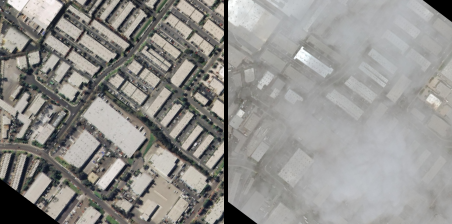

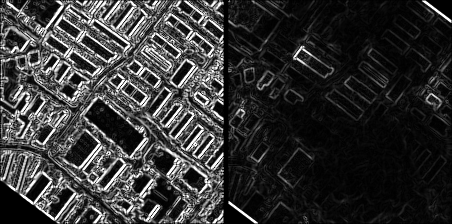

score 0.9924375639486133
score 0.9959520142374815
score 0.9921651185872093
score 0.993099678765153
score 0.9686344587086585
Фрагменты id = 9


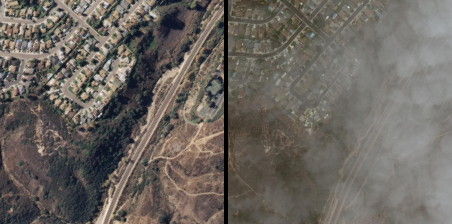

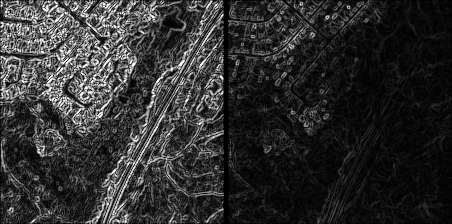

score 0.9874417906838268
score 0.9892417952792283
score 0.9909052082423278
score 0.9919349015975774
score 0.9963023501429743
score 0.9826419624830235
score 0.9886324715181899
score 0.9901641830138775
score 0.9918582497703835
score 0.9931829727311337
score 0.9953911422387716
score 0.9858730495968328
score 0.9909282730507353
score 0.9926274995115311
score 0.9906939381065767
score 0.9912841377269549
score 0.988552143528652
score 0.995410822802011
score 0.9982521752137753
score 0.9966110255573287
score 0.9897345935696596
score 0.9969319441332439
score 0.9925130891569033
score 0.9860020692825386
score 0.9912084786497121
score 0.9885525541473462
score 0.9932348092448943
score 0.9975578364550766
score 0.9916387865620762
score 0.9925834626171977
score 0.9953550933103412
score 0.9890023377997655
score 0.989642782520053
score 0.9885679045693622
score 0.9911754360018253
score 0.9945922230106339
score 0.9801371074665097
score 0.9962942338464745
score 0.988965723445363
score 0.993243822195549
score

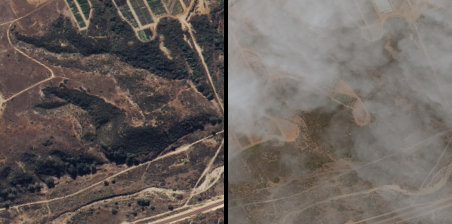

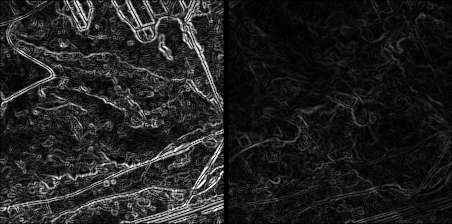

score 0.9927870971477247
score 0.9922426513409887
score 0.9839736975939974
score 0.9828788810932783
score 0.9844178183731644
score 0.9955015806442367
score 0.9891505012622723
score 0.9931847526241714
score 0.997606089334349
score 0.9926046813739153
score 0.9966991309055138
score 0.9901132776619185
score 0.9946537649700682
score 0.9802765919988774
score 0.9900531886278082
score 0.9931838236417411
score 0.9934965931754941
score 0.9921852011424763
score 0.9883540584169518
score 0.9704715901454604
Фрагменты id = 9


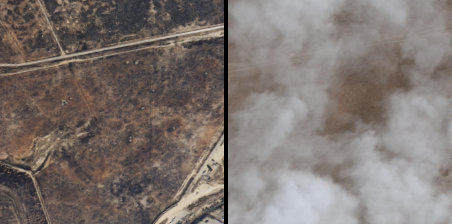

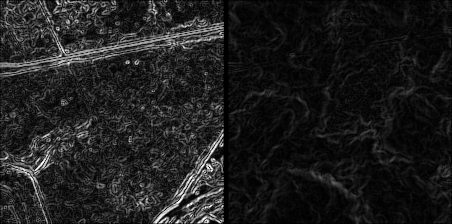

score 0.984578228627433
score 0.9866892419803787
score 0.9882818437060202
score 0.9956005207836477
score 0.9907832679556854
score 0.9786976503687141
Фрагменты id = 9


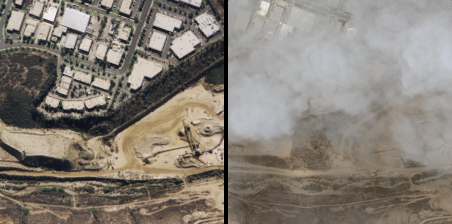

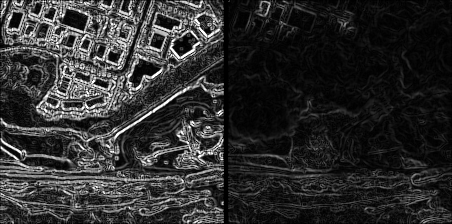

score 0.9900847595971924
score 0.9782326709207461
Фрагменты id = 9


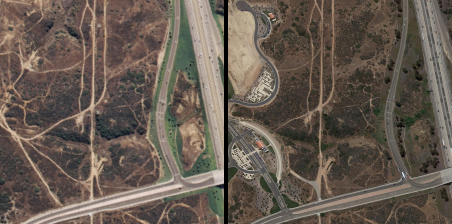

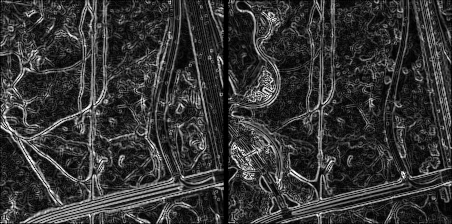

score 0.9943309628589322
score 0.9877147701098031
score 0.9954031296088155
score 0.9822300850577448
score 0.9922009041021
score 0.9848300369371245
score 0.9922866825729552
score 0.9936360869337099
score 0.9954256865896469
score 0.9906404425345022
score 0.9942994564656964
score 0.9820655331448014
score 0.9889351903589839
score 0.9926656457606564
score 0.988798280783043
score 0.9932702258485328
score 0.993894266869455
score 0.9940602698459866
score 0.9851120338124425
score 0.9947272804945977
score 0.9914161237573683
score 0.9875823702077516
score 0.986138401814171
score 0.9889437187947645
score 0.9948537735438635
score 0.9846634550953561
score 0.9866245750339713
score 0.992129683472508
score 0.9944914911841373
score 0.9964712704551709
score 0.988753104124972
score 0.9874106660265451
score 0.9946097223244905
score 0.9919117248115228
score 0.9780730422403969
Фрагменты id = 9


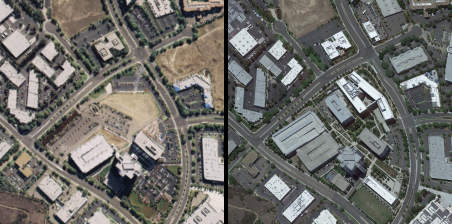

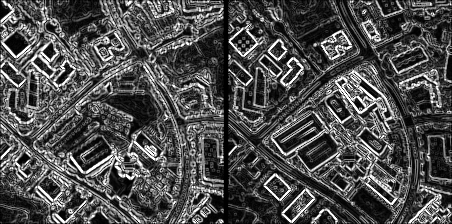

score 0.9993548993875347
score 0.9894192416015758
score 0.996591395288555
score 0.9883285882755697
score 0.9901117176150666
score 0.991251315486171
score 0.9919830730860452
score 0.9792857652640745
Фрагменты id = 9


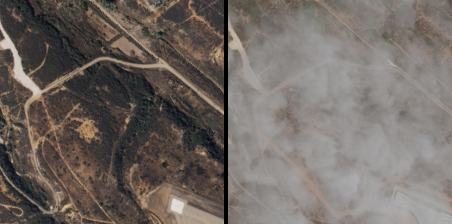

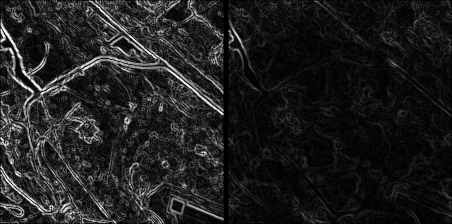

score 0.9970739782767407
score 0.9861435125522304
score 0.9895149852795556
score 0.9922378621951933
score 0.9931657934632735
score 0.9709693639414916
Фрагменты id = 9


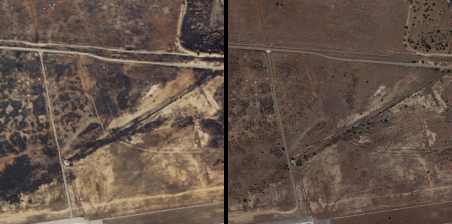

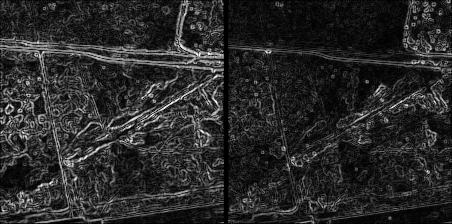

score 0.9866272531326854
score 0.9953438443400918
score 0.9916882118472147
score 0.989353058631754
score 0.9950094037527032
score 0.9892312239293328
score 0.9927345908631054
score 0.9925487055976251
score 0.9916653404465401
score 0.9824556464544001
score 0.9912493350039391
score 0.9920813955043335
score 0.9911463277708553
score 0.9962382507608523
score 0.9941378961571373
score 0.9882794952107096
score 0.9935990477734236
score 0.9749807331422141
Фрагменты id = 9


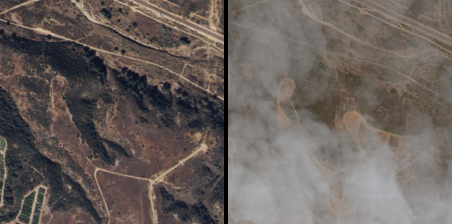

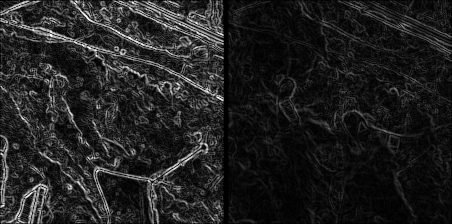

score 0.9912034641381322
score 0.990028709049433
score 0.992454607062897
score 0.997021920997679
score 0.9907103880235741
score 0.9888115917149939
score 0.9776874522995865
Фрагменты id = 9


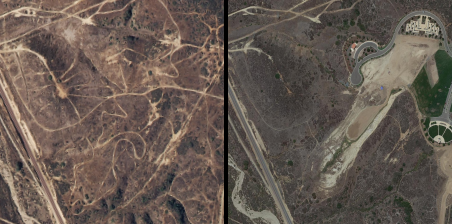

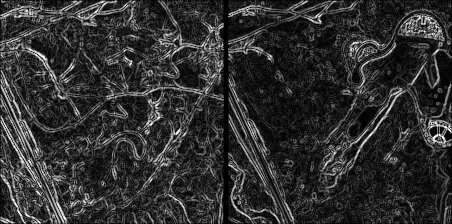

score 0.9925040760011838
score 0.9902480662880473
score 0.9919388569457014
score 0.9951269788909644
score 0.9946944685890811
score 0.9841314100189982
score 0.983752717476774
score 0.9897231440499784
score 0.9915862206180367
score 0.9907591798520663
score 0.9929853246395696
score 0.9926424289278776
score 0.9758353528711539
Фрагменты id = 9


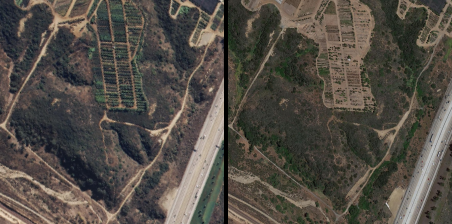

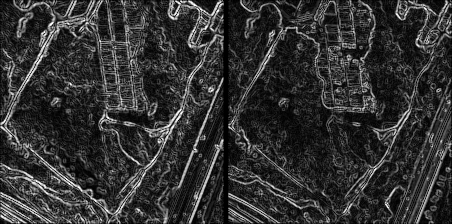

score 0.9865468900360767
score 0.9923320582937305
score 0.9969465052262407
score 0.9927638000960731
score 0.9844614474354748
score 0.9958525601790413
score 0.9921889781429442
score 0.9833565277363806
score 0.9861051097468144
score 0.999563102267593
score 0.996453261918732
score 0.9882461856391637
score 0.9955197664008157
score 0.9907334872669191
score 0.987570990301668
score 0.997182224292332
score 0.9883188208583228
score 0.9857927282773256
score 0.9874432968244721
score 0.9871298259669911
score 0.9888890607759983
score 0.9939234830756989
score 0.9898319989995853
score 0.9800878742911322
score 0.9930808124777858
score 0.9914409698300863
score 0.9847330794268988
score 0.9909816380878896
score 0.991056083527169
score 0.9861081942961162
score 0.9831617795241913
score 0.9916773727412969
score 0.993167879066967
score 0.9699609589823239
Фрагменты id = 9


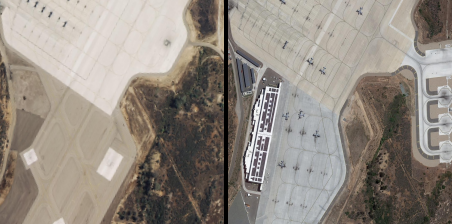

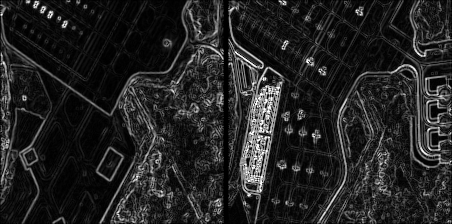

score 0.997057157597199
score 0.9950722196124919
score 0.9891612181163116
score 0.9891902716759031
score 0.990547333426625
score 0.9950243917927587
score 0.9839708314491198
score 0.9940964486838357
score 0.9913683712113557
score 0.9850299123192623
score 0.972620552556756
Фрагменты id = 9


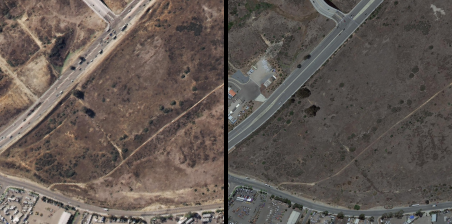

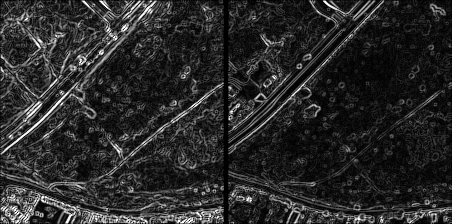

score 0.9835402755073798
score 0.9931119413647214
score 0.9954267368113661
score 0.9914421891512524
score 0.9900217261466591
score 0.9956229483306974
score 0.9905488239801681
score 0.9911604992600338
score 0.9855479074126928
score 0.9921641398834176
score 0.9961549992617319
score 0.9812627498063153
score 0.9870938517496584
score 0.9975612131743916
score 0.9893477096467832
score 0.9963792679156089
score 0.9864987608722926
score 0.9851578907963112
score 0.989818771931806
score 0.9646789914643743
Фрагменты id = 9


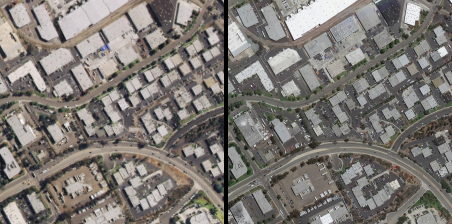

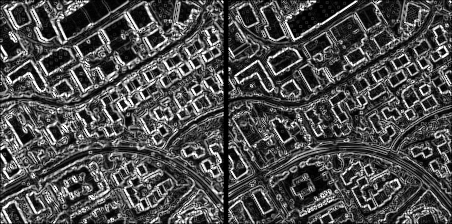

score 0.9870911453671765
score 0.9932525094312564
score 0.9918269875714916
score 0.9888538743674391
score 0.9917700903834031
score 0.9819074279784766
score 0.9886224265464159
score 0.9919837898373745
score 0.9718119654302896
Фрагменты id = 9


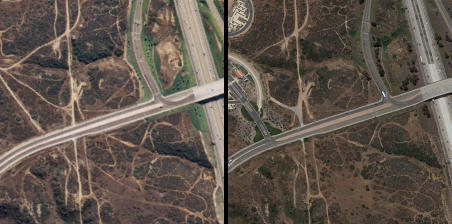

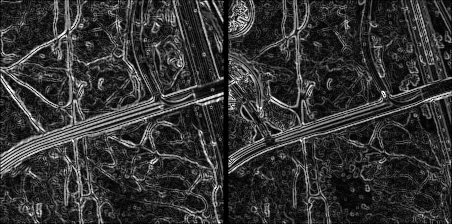

score 0.9837659051487858
score 0.9833544166703001
score 0.9841043080791825
score 0.9940401155671498
score 0.9911882680211709
score 0.9908316170076951
score 0.9895341536454922
score 0.993078250426066
score 0.9818191924023925
score 0.9929332385493475
score 0.9913047865182915
score 0.9885749679707173
score 0.995841907457991
score 0.989148892104515
score 0.9860941777125029
score 0.9810194391414966
score 0.9932950824659905
score 0.9934551042702067
score 0.9990168647143638
score 0.9939623892812411
score 0.9852873148465764
score 0.9785615652098141
Фрагменты id = 9


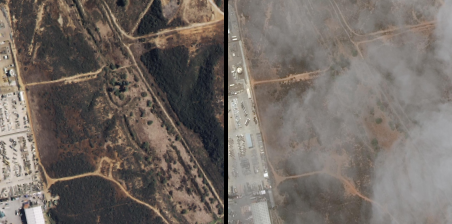

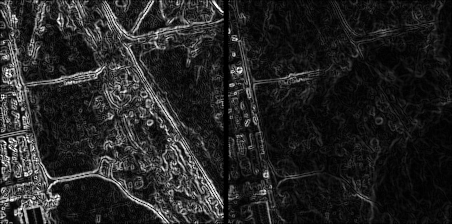

score 0.9713914148761973
Фрагменты id = 9


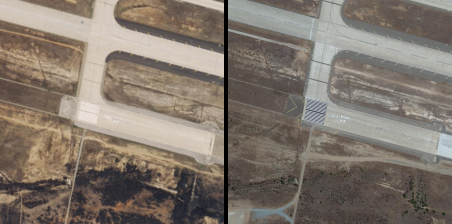

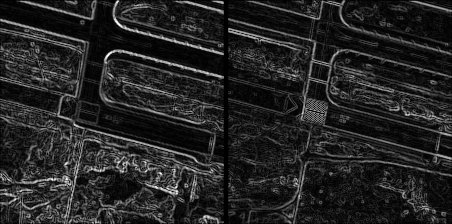

score 0.9835539629811226
score 0.9939368419791067
score 0.9843953203565454
score 0.985554573811738
score 0.9889501726393392
score 0.9883896784854918
score 0.9911747487237763
score 0.994799225835204
score 0.9967039868240996
score 0.9886243288863866
score 0.9895842127797874
score 0.987067148208167
score 0.9910981095934449
score 0.9954631065305253
score 0.9798030500916696
Фрагменты id = 9


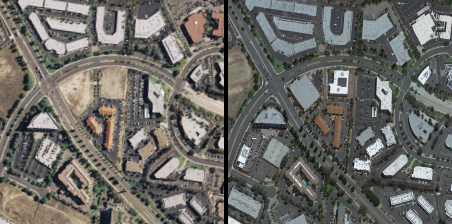

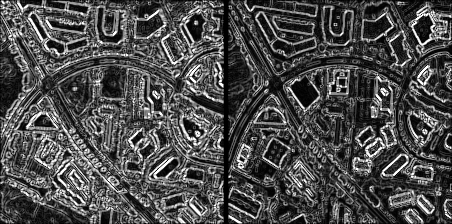

score 0.9891062557000648
score 0.9882894195176077
score 0.9899704492997192
score 0.9762336012415213
Фрагменты id = 9


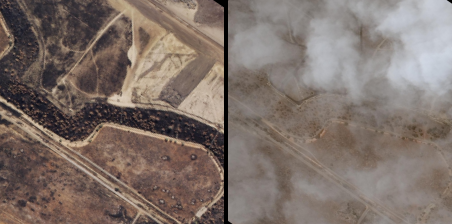

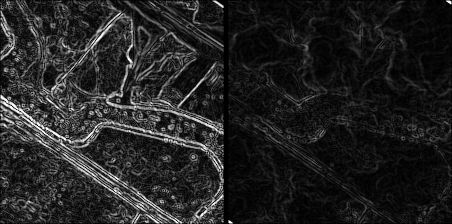

score 0.9904526039731144
score 0.9912793601536672
score 0.9942236231199402
score 0.9931643229865318
score 0.9965855770903917
score 0.9827950925783802
score 0.982624348821889
score 0.9907345344195533
score 0.9800000427901816
score 0.991975413719257
score 0.9903737379971755
score 0.9914533790555133
score 0.9947656622843368
score 0.9957546946520526
score 0.9937959044042783
score 0.9946568571686164
score 0.9896267415987181
score 0.9919733604126582
score 0.9975702120452778
score 0.9966709563011634
score 0.9872387611745139
score 0.9832885535497206
score 0.9902921257122196
score 0.9877090921652028
score 0.9945946542745591
score 0.9881238863731816
score 0.9957464572293712
score 0.9856677833153147
score 0.990034021618815
score 0.9930558256632107
score 0.9890689287235692
score 0.9959297153887138
score 0.9852401630429966
score 0.9952956570468199
score 0.9897252839045665
score 0.9794778606623874
Фрагменты id = 9


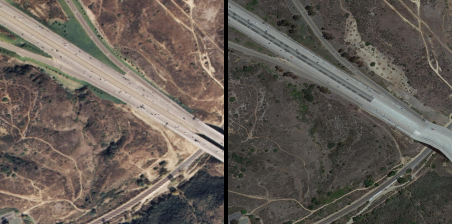

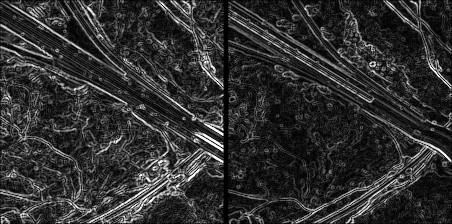

score 0.9901432714920211
score 0.9902975624623844
score 0.9886994385137449
score 0.9835340937357212
score 0.9784528850741233
Фрагменты id = 9


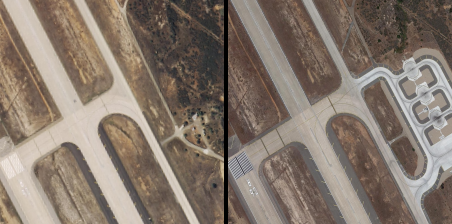

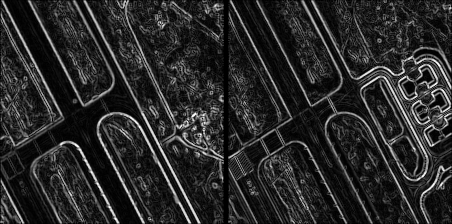

score 0.9816481326516284
score 0.9951878243223348
score 0.9968131901284345
score 0.9876336250804211
score 0.9893238268327033
score 0.9771580262137485
Фрагменты id = 9


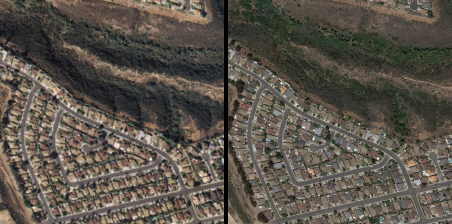

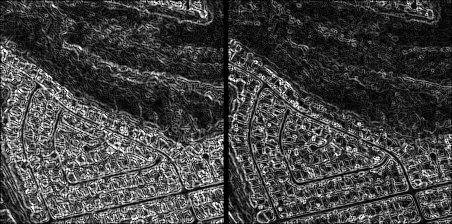

score 0.9940589404357245
score 0.9893070681509724
score 0.9878660939410994
score 0.9851843985762124
score 0.9938453788105983
score 0.9822820784533858
score 0.9904187778998353
score 0.9795127146142911
Фрагменты id = 9


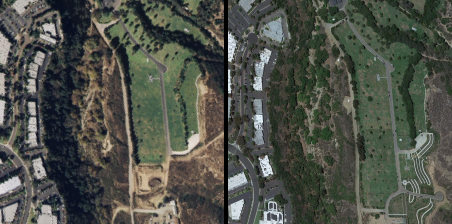

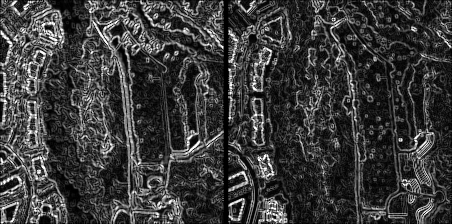

score 0.9950102667483173
score 0.9874167304750296
score 0.9887029963098829
score 0.9919857593315454
score 0.9850379586734754
score 0.9888305071368794
score 0.9808993520463437
score 0.9898191947347192
score 0.97748982029832
Фрагменты id = 9


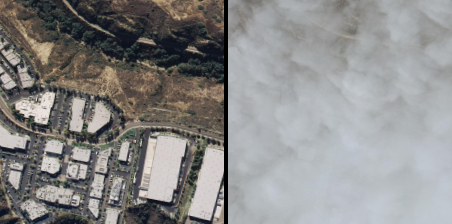

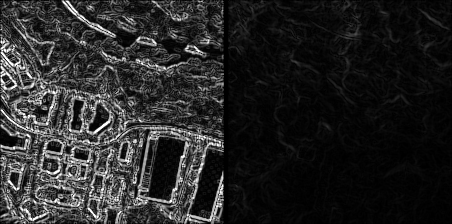

score 0.9900156473501969
score 0.9902171784192403
score 0.9896780195805545
score 0.9938245145221812
score 0.9752717328040452
Фрагменты id = 9


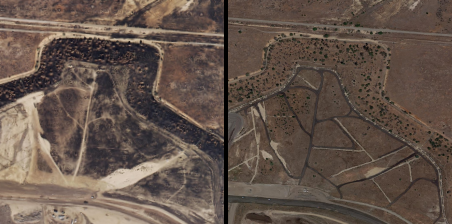

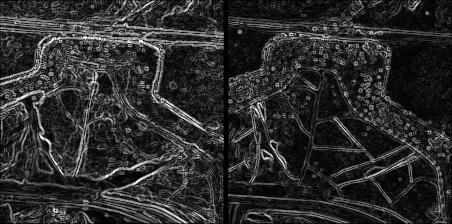

score 0.9813096421985704
score 0.9905297110057337
score 0.9836711406714791
score 0.9962191695389542
score 0.9778345684315414
Фрагменты id = 9


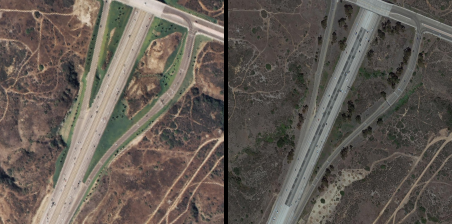

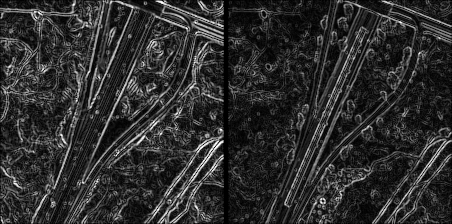

score 0.9896458146689752
score 0.9824671020795116
score 0.993322925882554
score 0.9939003223808752
score 0.990383809644381
score 0.9909420619441051
score 0.990677973801013
score 0.9835823665078305
score 0.9929150098573674
score 0.9881675665374855
score 0.9936163647446493
score 0.98558009570668
score 0.994476175949032
score 0.9899731395633175
score 0.9948648839970307
score 0.9961631338366791
score 0.9890218375719845
score 0.9895444450445866
score 0.9817032913114351
score 0.9934361668422071
score 0.9979946078714718
score 0.9896274649996581
score 0.9895991928792595
score 0.9952471924493408
score 0.9820683568910927
score 0.9882686442580885
score 0.9648744938975253
Фрагменты id = 9


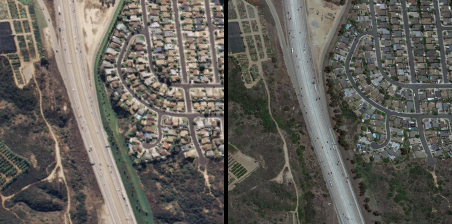

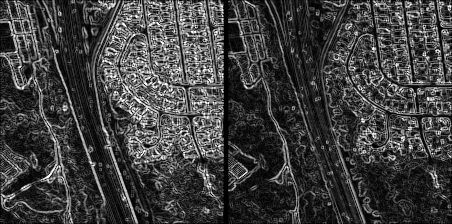

score 0.988202377797353
score 0.9976659969824395
score 0.9880044138501616
score 0.9873324710277932
score 0.9835133834558165
score 0.997457567846619
score 0.9805009649819237
score 0.9894448792121646
score 0.986176739624615
score 0.9944408923906475
score 0.9811726513090978
score 0.9871458830433127


In [ ]:
for i in range(len(train_img)):
  p_img = model.predict(train_img[i:i+1])
  score = compute_metric_simp(train_xya[i:i+1][0], p_img[:1][0])
  print('score', score)
  # cv2_imshow(train_img[i])
  # вырезаем фрагмент по координатам центра и значению угла
  x, y, xa, ya = train_xya[i]
  x = round(x * resized_img.shape[1])
  y = round(y * resized_img.shape[0])
  ang = train_ang[i]  
  fragment = subimage(image=resized_img, center=(x, y), theta=ang, width=fragment_size, height=fragment_size)
  # cv2_imshow(train_frag)

  if score < 0.98:
    print('Фрагменты id =', id)
    cv2_imshow(np.hstack([fragment,z_img, train_img[i]]))
    cv2_imshow(np.hstack([make_sobel(fragment),z_img[:,:,0], make_sobel(train_img[i])]))


In [ ]:
sound()

### Проверка на тестовых с портала

In [ ]:
# Загружаем данные
dir_test_img = '/content/test_data/'
test_img_lst = os.listdir(dir_test_img)

# количество файлов
print(len(os.listdir(dir_test_img)))

test_img = [] # здесь будут тестовые изображения в нужном размере (224)
# tmp_img = resized_img.copy()

for f_img in test_img_lst[:]:
  # загружаем соответствующий фрагмент для добавления в тренировочную базу в размере 224
  test_frag = resize_image(cv2.imread(dir_test_img+f_img),width=224)
  test_img.append(test_frag)
  
test_img = np.array(test_img)

sound()

400


In [ ]:
p = model.predict(test_img[:])

In [ ]:
# сохраняем массив с тестовыми изображениями
# import pickle

# test_img_file = '/content/drive/MyDrive/Aerophoto/'+'test_imgs_size_224'

# with open(test_img_file, "wb") as fp:   #Pickling
#   pickle.dump(test_img, fp)

**Определяем дополнительное смещение**

In [ ]:
# загружаем результаты предсказания
import pickle

pred_dump_file = '/content/drive/MyDrive/Aerophoto/'+'test_frag_64'
with open(pred_dump_file, "rb") as fp:   # Unpickling
  test_frag = np.array(pickle.load(fp))
 
pred_dump_file = '/content/drive/MyDrive/Aerophoto/'+'test_img_64'
with open(pred_dump_file, "rb") as fp:   # Unpickling
  test_img_64 = pickle.load(fp)

pred_dump_file = '/content/drive/MyDrive/Aerophoto/'+'test_d_xya'
with open(pred_dump_file, "rb") as fp:   # Unpickling
  test_d_xya = np.array(pickle.load(fp))

# train_xya грузить не надо, он не меняется

train_frag.shape, train_img_64.shape, train_d_xya.shape

array([[0.3236984 , 0.45179328, 0.8895334 , 0.19084746],
       [0.87124175, 0.4110695 , 0.41401172, 0.91828275]], dtype=float32)

In [ ]:
test_img_64 = np.array([resize_image(im, width=64) for im in test_img])

In [ ]:
# создаем дубли из подложки для которых будем определять смещение dx, dy, dxa, dya
# функция возвращает дельту и фрагмент подложки
def get_fragment_for_test(tr_img, pr_xya):

  # вырезаем фрагмент по координатам центра и значению угла
  x, y, xa, ya = pr_xya
  x = int(x * img_656.shape[1])
  y = int(y * img_656.shape[0])
  ang = xy2ang(xa,ya)  
  fragment = subimage(image=w_res_image, center=(x, y), theta=ang, width=offset, height=offset, shp=img_656.shape[:2]) #w_res_image - это подложка с бордюром слева и снизу, offset=64
  # cv2_imshow(fragment)
  if fragment.shape != (offset,offset,3):
    print('Ahtung!',fragment.shape, id, (x,y), pr_xya, tr_xya)
  # cv2_imshow(np.hstack([fragment,z_img_64, tr_img]))

  return fragment

id = 3
fragment = get_fragment_for_test(test_img_64[id], p[id]) #p[id]


In [ ]:
# z_img_64 = np.zeros((64,4,3)) # дубль

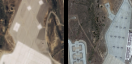

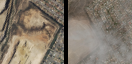

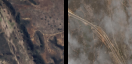

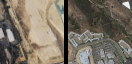

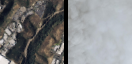

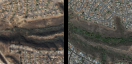

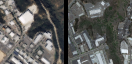

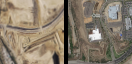

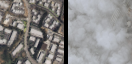

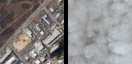

In [ ]:
# готовим данные для обучения (сжирает память!)
test_frag = []

for id, tr_im in enumerate(test_img_64[:]):
  fragment = get_fragment_for_test(tr_im, p[id]) #p[id]
  test_frag.append(fragment)

  # проверка
  if id<10:
    cv2_imshow(np.hstack([test_frag[id],z_img_64, test_img_64[id]]))

In [ ]:
for id, tr_im in enumerate(test_img_64[:100]):
  # проверка
  cv2_imshow(np.hstack([test_frag[id],z_img_64, test_img_64[id]]))

In [ ]:
p_dxya= model_fin.predict([test_img_64,np.array(test_frag)])

In [ ]:
# score стал
p_new = p + p_dxya/20

In [ ]:
p_new[:5]

array([[0.8597787 , 0.6582567 , 0.45554614, 0.06282411],
       [0.89448845, 0.24274506, 0.28927264, 0.10852765],
       [0.5026954 , 0.7608995 , 0.3778674 , 0.9584182 ],
       [0.544047  , 0.36686823, 0.6473073 , 0.05255561],
       [0.3448488 , 0.51045245, 0.31517252, 0.04540816]], dtype=float32)

In [ ]:
p[:5]

array([[0.8724673 , 0.67809844, 0.45945844, 0.06389831],
       [0.90803164, 0.22476651, 0.2884621 , 0.10948852],
       [0.4879806 , 0.7652199 , 0.36723402, 0.95170516],
       [0.5539295 , 0.35554552, 0.6591235 , 0.0506235 ],
       [0.34602147, 0.50552183, 0.3045831 , 0.03789136]], dtype=float32)

### Конвертируем в json

In [ ]:
org_shape

(10496, 10496, 3)

In [ ]:
x_test, y_test = get_dataset(resized_img, dataset_size=5)

In [ ]:
# gs = get_json(file_json=dir_json+train_json_lst[0])
# gs

{'angle': 153,
 'left_bottom': [3536, 8360],
 'left_top': [4001, 9272],
 'right_bottom': [2624, 8825],
 'right_top': [3089, 9737]}

In [ ]:
def convert2json(xya):
  # print(xya)

  # 1. находим координаты углов и расчитываем угол
  points = get_points(xya, img_shape=org_shape)
  angle = xy2ang(*xya[2:])

  # print(points, angle, '\ncenter:', xya[:2]*org_shape[0])


  # 2. Создаем словарь, который запишем в json файл
  result_json = {}
  result_json["left_top"] = list(map(int,points[2])) #
  result_json["right_top"] = list(map(int,points[1])) #
  result_json["left_bottom"] = list(map(int,points[0])) #
  result_json["right_bottom"] = list(map(int,points[3])) #
  result_json["angle"] = int(angle) #

  return result_json

#{"left_top": [1098, 6721], "right_top": [2116, 6828], "left_bottom": [991, 7739], "right_bottom": [2009, 7846], "angle": 6}

# json_data = convert2json(test_data)

In [ ]:
# json_data

{'angle': 153,
 'left_bottom': [3470, 8560],
 'left_top': [3799, 9206],
 'right_bottom': [3153, 9535],
 'right_top': [2824, 8889]}

### Сохраняем json

In [ ]:
json_result_dir = '/content/drive/MyDrive/Aerophoto/json_results/'
json_result_dir = '/content/json_results/'

def json_save(json_data, fname):
  with open(json_result_dir+fname, 'w') as f:
      json.dump(json_data, f)

In [ ]:
# !rm -f /content/drive/MyDrive/Aerophoto/json_results/*
!rm -f /content/json_results/*

In [ ]:
for i, f_name in enumerate(test_img_lst[:]):
  json_data = convert2json(p_new[i])  # !!! p_new
  fname = change_file_ext(f_name, ext='json')
  # print(fname, json_data)
  json_save(json_data, fname)

In [ ]:
!tar -cf res.tar /content/json_results

tar: Removing leading `/' from member names
/content/json_results/
/content/json_results/1144.json
/content/json_results/1002.json
/content/json_results/886.json
/content/json_results/249.json
/content/json_results/713.json
/content/json_results/578.json
/content/json_results/93.json
/content/json_results/758.json
/content/json_results/707.json
/content/json_results/243.json
/content/json_results/617.json
/content/json_results/648.json
/content/json_results/447.json
/content/json_results/870.json
/content/json_results/777.json
/content/json_results/117.json
/content/json_results/523.json
/content/json_results/978.json
/content/json_results/919.json
/content/json_results/1013.json
/content/json_results/906.json
/content/json_results/333.json
/content/json_results/560.json
/content/json_results/1043.json
/content/json_results/684.json
/content/json_results/1192.json
/content/json_results/364.json
/content/json_results/881.json
/content/json_results/391.json
/content/json_results/1132.jso

In [ ]:
sound()